In [1]:
# Potential Project Idea:
# Anomaly detection to determine which characters could be potential spies in the village based off of chackra attributes,
# clanhood, etc using unsupervised ML (anomaly detection)

In [2]:
# Download Necessary Python Packages

In [3]:
import requests
import pandas as pd
import schedule
import re
import sweetviz as sv

In [4]:
# Set API variables

In [5]:
baseurl = 'https://dattebayo-api.onrender.com'

In [6]:
endpoint = '/characters'

In [7]:
# Test call to API.
# 200 - OK: API request is successful
# 202 - Accepted: The API request has been accepted for processing.
# 400 - Bad Request: The API request was unacceptable, often due to a missing or invalid parameter.
# 404 - Not Found: The requested resource does not exist.
# 429 - Rate Limited: You have made too many requests within the threshold timeframe.
# 500 - Internal Server Error: Something went wrong on our end. Please get in touch with support.

In [8]:
# Make API Call
r = requests.get(baseurl+endpoint)
r

<Response [200]>

In [9]:
# Review Data Structure
jsondata= r.json()
jsondata

{'characters': [{'id': 1344,
   'name': 'Naruto Uzumaki',
   'images': ['https://static.wikia.nocookie.net/naruto/images/d/d6/Naruto_Part_I.png',
    'https://static.wikia.nocookie.net/naruto/images/7/7d/Naruto_Part_II.png'],
   'debut': {'manga': 'Naruto Chapter #1',
    'anime': 'Naruto Episode #1',
    'novel': 'Naruto: Innocent Heart, Demonic Blood',
    'movie': 'Naruto the Movie: Ninja Clash in the Land of Snow',
    'game': 'Naruto: Konoha Ninpōchō',
    'ova': 'Find the Four-Leaf Red Clover!',
    'appearsIn': 'Anime, Manga, Novel, Game, Movie'},
   'family': {'father': 'Minato Namikaze',
    'mother': 'Kushina Uzumaki',
    'son': 'Boruto Uzumaki',
    'daughter': 'Himawari Uzumaki',
    'wife': 'Hinata Uzumaki',
    'adoptive son': 'Kawaki',
    'godfather': 'Jiraiya'},
   'jutsu': ['All Directions Shuriken',
    'Baryon Mode',
    'Big Ball Rasengan',
    'Big Ball Rasenshuriken',
    'Big Ball Spiralling Serial Zone Spheres',
    'Boil Release: Unrivalled Strength',
    'Ch

In [10]:
# View number of pages
pages = jsondata['total']
pages

1431

In [11]:
characterjson = jsondata['characters'][0]
characterjson

{'id': 1344,
 'name': 'Naruto Uzumaki',
 'images': ['https://static.wikia.nocookie.net/naruto/images/d/d6/Naruto_Part_I.png',
  'https://static.wikia.nocookie.net/naruto/images/7/7d/Naruto_Part_II.png'],
 'debut': {'manga': 'Naruto Chapter #1',
  'anime': 'Naruto Episode #1',
  'novel': 'Naruto: Innocent Heart, Demonic Blood',
  'movie': 'Naruto the Movie: Ninja Clash in the Land of Snow',
  'game': 'Naruto: Konoha Ninpōchō',
  'ova': 'Find the Four-Leaf Red Clover!',
  'appearsIn': 'Anime, Manga, Novel, Game, Movie'},
 'family': {'father': 'Minato Namikaze',
  'mother': 'Kushina Uzumaki',
  'son': 'Boruto Uzumaki',
  'daughter': 'Himawari Uzumaki',
  'wife': 'Hinata Uzumaki',
  'adoptive son': 'Kawaki',
  'godfather': 'Jiraiya'},
 'jutsu': ['All Directions Shuriken',
  'Baryon Mode',
  'Big Ball Rasengan',
  'Big Ball Rasenshuriken',
  'Big Ball Spiralling Serial Zone Spheres',
  'Boil Release: Unrivalled Strength',
  'Chakra Transfer Technique',
  'Clone Body Blow',
  'Clone Flying A

In [12]:
# Create Functions to Begin Grabbing Data as well as each page

In [13]:
def getcharacterjson(baseurl,endpoint):
    r = requests.get(baseurl+endpoint)
    return r.json()

In [14]:
getcharacterjson(baseurl,endpoint)

{'characters': [{'id': 1344,
   'name': 'Naruto Uzumaki',
   'images': ['https://static.wikia.nocookie.net/naruto/images/d/d6/Naruto_Part_I.png',
    'https://static.wikia.nocookie.net/naruto/images/7/7d/Naruto_Part_II.png'],
   'debut': {'manga': 'Naruto Chapter #1',
    'anime': 'Naruto Episode #1',
    'novel': 'Naruto: Innocent Heart, Demonic Blood',
    'movie': 'Naruto the Movie: Ninja Clash in the Land of Snow',
    'game': 'Naruto: Konoha Ninpōchō',
    'ova': 'Find the Four-Leaf Red Clover!',
    'appearsIn': 'Anime, Manga, Novel, Game, Movie'},
   'family': {'father': 'Minato Namikaze',
    'mother': 'Kushina Uzumaki',
    'son': 'Boruto Uzumaki',
    'daughter': 'Himawari Uzumaki',
    'wife': 'Hinata Uzumaki',
    'adoptive son': 'Kawaki',
    'godfather': 'Jiraiya'},
   'jutsu': ['All Directions Shuriken',
    'Baryon Mode',
    'Big Ball Rasengan',
    'Big Ball Rasenshuriken',
    'Big Ball Spiralling Serial Zone Spheres',
    'Boil Release: Unrivalled Strength',
    'Ch

In [15]:
# Working with Multiple Pages 
def getcharacterjson(baseurl,endpoint,x): # Use 'x' when working with pagination (multiple pages)):
    r = requests.get(baseurl+endpoint+f'?page={x}')
    return r.json()

In [16]:
getcharacterjson(baseurl,endpoint,1)

{'characters': [{'id': 1344,
   'name': 'Naruto Uzumaki',
   'images': ['https://static.wikia.nocookie.net/naruto/images/d/d6/Naruto_Part_I.png',
    'https://static.wikia.nocookie.net/naruto/images/7/7d/Naruto_Part_II.png'],
   'debut': {'manga': 'Naruto Chapter #1',
    'anime': 'Naruto Episode #1',
    'novel': 'Naruto: Innocent Heart, Demonic Blood',
    'movie': 'Naruto the Movie: Ninja Clash in the Land of Snow',
    'game': 'Naruto: Konoha Ninpōchō',
    'ova': 'Find the Four-Leaf Red Clover!',
    'appearsIn': 'Anime, Manga, Novel, Game, Movie'},
   'family': {'father': 'Minato Namikaze',
    'mother': 'Kushina Uzumaki',
    'son': 'Boruto Uzumaki',
    'daughter': 'Himawari Uzumaki',
    'wife': 'Hinata Uzumaki',
    'adoptive son': 'Kawaki',
    'godfather': 'Jiraiya'},
   'jutsu': ['All Directions Shuriken',
    'Baryon Mode',
    'Big Ball Rasengan',
    'Big Ball Rasenshuriken',
    'Big Ball Spiralling Serial Zone Spheres',
    'Boil Release: Unrivalled Strength',
    'Ch

In [17]:
getcharacterjson(baseurl,endpoint,2)

{'characters': [{'id': 935,
   'name': 'Hagoromo Ōtsutsuki',
   'images': ['https://static.wikia.nocookie.net/naruto/images/6/62/Hagoromo.png'],
   'debut': {'manga': 'Naruto Chapter #572',
    'anime': 'Naruto Shippūden Episode #329',
    'movie': 'The Last: Naruto the Movie',
    'game': 'Naruto Shippūden: Ultimate Ninja Storm 4',
    'appearsIn': 'Anime, Manga, Game, Movie'},
   'family': {'mother': 'Kaguya Ōtsutsuki',
    'father ': 'Tenji',
    'brother': 'Hamura Ōtsutsuki',
    'son': 'Indra Ōtsutsuki',
    'creations': 'Tailed Beasts'},
   'jutsu': ['Animal Path',
    'Asura Path',
    'Chakra Transfer Technique',
    'Chibaku Tensei',
    'Creation of All Things Technique',
    'Deva Path',
    'Drilling Hand of Sage Lightning (Anime only)',
    'Human Path',
    'Mystical Palm Technique (Anime only)',
    'Naraka Path',
    'Outer Path',
    'Preta Path',
    'Sensing Technique',
    'Six Paths Senjutsu',
    'Six Paths Technique',
    'Six Paths Yang Power',
    'Six Paths Yi

In [18]:
# Grab # of pages after passing through json response
def getpages(response):
   return r.json()['total']

In [19]:
# Run function on Desired API database
getpages(jsondata)

1431

In [20]:
# From Data exploration, we learned that some fields are actually dictionaries and won't fit all fit in the same format
# View Different Types of Ranks
def extract_unique_ranks(jsondata):
    unique_ranks = set()
    for character in jsondata['characters']:
        if 'rank' in character:
            rank_data = character['rank']
            if isinstance(rank_data, dict):
                for key, value in rank_data.items():
                    if isinstance(value, dict):
                        for sub_key, sub_value in value.items():
                            unique_ranks.add((key, sub_key, sub_value))
                    else:
                        unique_ranks.add((key, value))
    return unique_ranks

In [21]:
# Extract unique ranks
extract_unique_ranks(jsondata)

# Display unique rank instances
for rank in extract_unique_ranks(jsondata):
    if len(rank) >= 0:
        if len(rank) == 3:
            print(f"{rank[0]}: {rank[1]} - {rank[2]}")
        elif len(rank) == 2:
            print(f"{rank[0]}: {rank[1]}")
        else:
            print(f"{rank}")

ninjaRank: Part I - Chūnin
ninjaRegistration: 012707
ninjaRegistration: 012607
ninjaRank: Part II - Anbu
ninjaRank: Part I - Kage
ninjaRank: Gaiden - Kage
ninjaRegistration: 002300
ninjaRegistration: 56-001
ninjaRegistration: 009720
ninjaRegistration: 012140
ninjaRank: Part I - Anbu
ninjaRank: Blank Period - Kage
ninjaRegistration: 010252
ninjaRegistration: 010992
ninjaRegistration: 002301
ninjaRank: Part II - Genin
ninjaRegistration: 006510
ninjaRegistration: 012110
ninjaRegistration: 002302
ninjaRegistration: 012606
ninjaRegistration: 010886
ninjaRank: Part II - Chūnin
ninjaRank: Part I - Genin
ninjaRank: Part I - Jōnin
ninjaRank: Part II - Kage
ninjaRank: Gaiden - Genin
ninjaRank: Gaiden - Jōnin
ninjaRank: Part I - Academy Student
ninjaRegistration: 012561


In [22]:
# View Different Types of Family members
def extract_family_members(jsondata):
    family_members = set()
    for character in jsondata['characters']:
        if 'family' in character:
            family_data = character['family']
            if isinstance(family_data, dict):
                for relation, name in family_data.items():
                    family_members.add((relation, name))
    return family_members

# Extract unique family members
extract_family_members(jsondata)
for family in extract_family_members(jsondata):
    if len(family) >= 0:
        if len(family) == 2:
            print(f"{family[0]}: {family[1]}")
        elif len(family) == 3:
            print(f"{family[0]}: {family[1]} - {family[2]}")
        elif len(family) == 4:
            print(f"{family[0]}: {family[1]} - {family[2]} - {family[3]}")
        elif len(family) == 5:
            print(f"{family[0]}: {family[1]} - {family[2]} - {family[3]} - {family[4]}")
        elif len(family) == 6:
            print(f"{family[0]}: {family[1]} - {family[2]} - {family[3]} - {family[4]} - {family[5]}")
        else:
            print(f"{family}")

mother: Karura
grandfather: Hashirama Senju
brother: Kankurō
granduncle: Kawarama Senju
father: Sakumo Hatake
genetic template/parent: Orochimaru
son: Boruto Uzumaki
godfather: Jiraiya
father: Tajima Uchiha
grandfather: Hiruzen Sarutobi
granddaughter: Himawari Uzumaki
adoptive son: Kawaki
father: Minato Namikaze
clone/son: Mitsuki
adoptive sons: Shin Uchiha
mother: Kushina Uzumaki
father: Rasa
son: Metal Lee
pet : Mikazuki
brother: Izuna Uchiha
great-grandfather: Hyūga Elder
lover: Dan Katō
grandson: Boruto Uzumaki
wife: Hinata Uzumaki
uncle: Yashamaru
great-grandfather: Sasuke Sarutobi
uncle: Asuma Sarutobi
godson: Naruto Uzumaki
adoptive son: Shinki
granddaughter: Tsunade
grandmother: Biwako Sarutobi
daughter: Sarada Uchiha
creator: Amado Sanzu
grandson: Nawaki
cousin: Mirai Sarutobi
brother: Itachi Uchiha
granduncle: Hizashi Hyūga
genetic template: Jiraiya
first cousin once removed: Neji Hyūga
father: Might Duy
sister: Temari
brother: Nawaki
host: Momoshiki Ōtsutsuki
mother: Hinata 

In [23]:
total_pages = getpages(jsondata)  # Total number of pages

In [24]:
def parsejson(response):
    """
    Parses and cleans a JSON response containing character data.
    Removes parentheses from both string values and field names directly in the JSON response.
    Processes list fields into comma-separated strings and counts, and adds binary fields for relevant fields.
    """

    def clean_string(value):
        """Helper function to remove parentheses from strings."""
        if isinstance(value, str):
            while '(' in value and ')' in value:
                start = value.find('(')
                end = value.find(')', start) + 1
                value = value[:start] + value[end:]
            return value.strip()
        return value

    def clean_json(data):
        """Recursively cleans parentheses from all string values and field names in the JSON."""
        if isinstance(data, dict):
            return {clean_string(key): clean_json(value) for key, value in data.items()}
        elif isinstance(data, list):
            return [clean_json(item) for item in data]
        else:
            return clean_string(data)

    def process_list_field(field):
        """Processes lists into comma-separated strings and counts."""
        if isinstance(field, list):
            return ", ".join(field), len(field)
        return field, 0

    def add_binary_fields(values, prefix, df=None):
                """
                Helper function to add binary fields for a string of comma-separated values.
                Dynamically includes fields with exactly 2 unique outputs from a DataFrame,
                where one value is a unique string and the other is null/NaN.
                Ensures binary fields are integers (1 or 0).
                """
                # Handle null/NaN values by converting them to a standard representation
                if values is None or (isinstance(values, float) and pd.isna(values)):
                        values = ""
                
                # Split the values string into individual items, ensuring proper stripping of whitespace
                if isinstance(values, str):
                        values = [value.strip() for value in values.split(",") if value.strip()]
                
                # Use set for faster lookup
                values_set = set(values)

                # Dynamically include fields from the DataFrame with exactly 2 unique outputs
                if df is not None:
                        fields_with_2_unique = [
                                col for col in df.columns 
                                if df[col].nunique() == 2 and df[col].isna().sum() > 0  # Ensure one value is NaN
                        ]
                        values_set.update(fields_with_2_unique)

                # Create a dictionary with all possible binary fields initialized to 0
                binary_fields = {
                        f"{prefix}_{value.replace(' ', '_')}": 0 for value in values_set
                }

                # Update the dictionary to set 1 for the provided values
                for value in values:
                        binary_field_name = f"{prefix}_{value.replace(' ', '_')}"
                        binary_fields[binary_field_name] = 1

                return binary_fields

    def is_antagonist(affiliations, teams, clans, villainous_groups):
        """
        Determines if a character is an antagonist based on their affiliations, teams, or clans.
        Matches are case-insensitive and checks for substrings within comma-separated strings.
        """
        def normalize_and_check(field):
            if isinstance(field, str):
                items = [item.strip(" '\"") for item in field.split(",")]
                return any(group.lower() in item.lower() for item in items for group in villainous_groups)
            elif isinstance(field, list):
                return any(group.lower() in item.lower() for item in field for group in villainous_groups)
            return False

        return (
            normalize_and_check(affiliations) or
            normalize_and_check(teams) or
            normalize_and_check(clans)
        )

    # Predefined list of villainous groups
    villainous_groups = [
        "Akatsuki", "Kara", "Otogakure", "Root", "Seven Ninja Swordsmen of the Mist",
        "Gatō Company", "White Zetsu Army", "Land of Silence", "Ōtsutsuki", "Kaguya",
        "Chinoike", "Fūma", "Wagarashi", "Taka", "Sound Four", "Sound Five",
        "Demon Brothers", "Gold and Silver Brothers", "Byakuya Gang", "Fabrications",
        "Haido's Knights", "Shinobazu", "Three Ryūdōin Brothers"
    ]

    # Clean the entire JSON response
    cleaned_response = clean_json(response)

    # Flatten and process the cleaned JSON
    characters = []
    for characterjson in cleaned_response['characters']:
        # Extract top-level fields with defaults for missing keys
        characterfields = {
            'id': characterjson.get('id', None),
            'name': characterjson.get('name', ''),
            'Antagonist': 0  # Initialize Antagonist as int (default is not a villain)
        }

        # Flatten debut and rank dictionaries using json_normalize
        for field in ['debut', 'rank']:
            if field in characterjson and isinstance(characterjson[field], dict):
                normalized = pd.json_normalize(characterjson[field], sep='_')
                characterfields.update({
                    f"{field}_{col}": normalized.iloc[0][col]
                    for col in normalized.columns
                })

        # Process specific fields using process_list_field
        characterfields['images'], _ = process_list_field(characterjson.get('images', []))
        
        # Process 'natureType' dynamically
        characterfields['natureType'], characterfields['natureType_count'] = process_list_field(characterjson.get('natureType', []))
        
        if characterfields['natureType']:
            nature_values = characterfields['natureType'].split(', ')
            characterfields.update(add_binary_fields(nature_values, 'natureType'))

        # Process family details
        if 'family' in characterjson and isinstance(characterjson['family'], dict):
            normalized_family = pd.json_normalize(characterjson['family'], sep='_')
            characterfields.update({
                f"family_{col}": normalized_family.iloc[0][col]
                for col in normalized_family.columns
            })
        
            family_nested = characterjson['family']
            family_details = {}
            unique_family_members = set()

            for role, name in family_nested.items():
                field_name = f"family_{role.replace(' ', '_')}"
                family_details[field_name] = name
                unique_family_members.add(name)

            family_details['family_count'] = len(unique_family_members)
            characterfields.update(family_details)
        
        else:
            characterfields['family_count'] = 0

        # Process personal details (affiliation, team, etc.)
        personal_fields = ['affiliation', 'team', 'classification', 'clan', 'kekkeiGenkai']
        
        if 'personal' in characterjson and isinstance(characterjson['personal'], dict):
            normalized_personal = pd.json_normalize(characterjson['personal'], sep='_')
            
            affiliations_str, _ = process_list_field(normalized_personal.iloc[0].get('affiliation', []))
            teams_str, _ = process_list_field(normalized_personal.iloc[0].get('team', []))
            clans_str, _ = process_list_field(normalized_personal.iloc[0].get('clan', []))
            classification_str, _ = process_list_field(normalized_personal.iloc[0].get('classification', []))
            kekkeiGenkai_str, _ = process_list_field(normalized_personal.iloc[0].get('kekkeiGenkai', []))
            

            if is_antagonist(affiliations_str.split(", "), teams_str.split(", "), clans_str.split(", "), villainous_groups):
                characterfields['Antagonist'] = 1

            for col in personal_fields:
                if col in normalized_personal.columns:
                    personal_field_value, count = process_list_field(normalized_personal.iloc[0][col])
                    characterfields[f"personal_{col}"] = personal_field_value
                    characterfields[f"personal_{col}_count"] = count
                    
                    if personal_field_value:
                        values = [item.strip() for item in personal_field_value.split(", ")]
                        binary_fields = add_binary_fields(values, f"personal_{col}")
                        characterfields.update(binary_fields)
                    else:
                        empty_binary_fields = {f"personal_{col}_empty": 0}
                        characterfields.update(empty_binary_fields)
        
                else:
                    characterfields[f"personal_{col}"] = ""

        tools_values, tools_count = process_list_field(characterjson.get('tools', []))
        characterfields['tools'] = tools_values
        characterfields['tools_count'] = tools_count

        jutsu_values, jutsu_count = process_list_field(characterjson.get('jutsu', []))
        characterfields['jutsu'] = jutsu_values
        characterfields['jutsu_count'] = jutsu_count


         # Process 'clan' field under 'personal'
        personal_data = characterjson.get('personal', {})
        if isinstance(personal_data, dict):  # Ensure 'personal' is a dictionary
                clan_list = personal_data.get('clan', [])
                if isinstance(clan_list, list):
                        clan_values, clan_count = process_list_field(clan_list)
                        characterfields['personal_clan'] = clan_values
                        characterfields['personal_clan_count'] = clan_count
                elif isinstance(clan_list, str):  # If clan is a string (comma-separated values)
                        clan_values = clan_list.strip()
                        characterfields['personal_clan'] = clan_values
                        characterfields['personal_clan_count'] = len(clan_values.split(", ")) if clan_values else 0
                else:  # If clan is missing or invalid
                        characterfields['personal_clan'] = ""
                        characterfields['personal_clan_count'] = 0
        else:  # Handle case where 'personal' is not a dictionary
                characterfields['personal_clan'] = ""
                characterfields['personal_clan_count'] = 0

        # Process 'team' field under 'personal'
        personal_data = characterjson.get('personal', {})
        if isinstance(personal_data, dict):  # Ensure 'personal' is a dictionary
            team_list = personal_data.get('team', [])
            if isinstance(team_list, list):
                team_values, team_count = process_list_field(team_list)
                characterfields['personal_team'] = team_values
                characterfields['personal_team_count'] = team_count
            elif isinstance(team_list, str):  # If team is a string (comma-separated values)
                team_values = team_list.strip()
                characterfields['personal_team'] = team_values
                characterfields['personal_team_count'] = len(team_values.split(", ")) if team_values else 0
            else:  # If team is missing or invalid
                characterfields['personal_team'] = ""
                characterfields['personal_team_count'] = 0
        else:  # Handle case where 'personal' is not a dictionary
            characterfields['personal_team'] = ""
            characterfields['personal_team_count'] = 0

        # Process 'kekkeiGenKai' field under 'personal'
        personal_data = characterjson.get('personal', {})
        if isinstance(personal_data, dict):  # Ensure 'personal' is a dictionary
            kekkei_genkai_data = personal_data.get('kekkeiGenkai', [])
            if isinstance(kekkei_genkai_data, list):  # If kekkeiGenKai is a list
                # Convert list to comma-separated string and count items
                kekkei_genkai_values = ", ".join(kekkei_genkai_data)
                kekkei_genkai_count = len(kekkei_genkai_data)
            elif isinstance(kekkei_genkai_data, str):  # If kekkeiGenKai is a string
                # Strip whitespace and count non-empty items split by commas
                kekkei_genkai_values = kekkei_genkai_data.strip()
                kekkei_genkai_count = len([item.strip() for item in kekkei_genkai_values.split(",") if item.strip()])
            else:  # If kekkeiGenKai is missing or invalid
                kekkei_genkai_values = ""
                kekkei_genkai_count = 0
            # Assign processed values to characterfields
            characterfields['personal_kekkeiGenkai'] = kekkei_genkai_values
            characterfields['personal_kekkeiGenkai_count'] = kekkei_genkai_count
        else:  # Handle case where 'personal' is not a dictionary
            characterfields['personal_kekkeiGenkai'] = ""
            characterfields['personalkekkeiGenkai_count'] = 0
            
        # Convert voiceActors_japanese and voiceActors_english into comma-separated strings
        if 'voiceActors' in characterjson and isinstance(characterjson['voiceActors'], dict):
            for voice_field in ['japanese', 'english']:
                actor_list = characterjson['voiceActors'].get(voice_field, [])
                if actor_list:
                    characterfields[f"voiceActors_{voice_field}"] = ", ".join(actor_list)
                else:
                    characterfields[f"voiceActors_{voice_field}"] = ""

        characters.append(characterfields)

    return characters

In [25]:
parsejson(jsondata)

[{'id': 1344,
  'name': 'Naruto Uzumaki',
  'Antagonist': 0,
  'debut_manga': 'Naruto Chapter #1',
  'debut_anime': 'Naruto Episode #1',
  'debut_novel': 'Naruto: Innocent Heart, Demonic Blood',
  'debut_movie': 'Naruto the Movie: Ninja Clash in the Land of Snow',
  'debut_game': 'Naruto: Konoha Ninpōchō',
  'debut_ova': 'Find the Four-Leaf Red Clover!',
  'debut_appearsIn': 'Anime, Manga, Novel, Game, Movie',
  'rank_ninjaRegistration': '012607',
  'rank_ninjaRank_Part I': 'Genin',
  'rank_ninjaRank_Gaiden': 'Kage',
  'images': 'https://static.wikia.nocookie.net/naruto/images/d/d6/Naruto_Part_I.png, https://static.wikia.nocookie.net/naruto/images/7/7d/Naruto_Part_II.png',
  'natureType': 'Wind Release, Lightning Release, Earth Release, Water Release, Fire Release, Lava Release, Magnet Release, Boil Release, Yin Release, Yang Release, Yin–Yang Release',
  'natureType_count': 11,
  'natureType_Earth_Release': 1,
  'natureType_Yin–Yang_Release': 1,
  'natureType_Boil_Release': 1,
  'natu

In [26]:
#Check one page for quick data exploration 
def explore_single_page(baseurl, endpoint, page, existing_df=None):
    jsondata = getcharacterjson(baseurl, endpoint, page)
    parsed_data = parsejson(jsondata)
    page_df = pd.DataFrame(parsed_data)
    
    if existing_df is None:
        return page_df
    else:
        return pd.concat([existing_df, page_df], ignore_index=True)

In [27]:
# Extract the 'natureType_Steel_Release' column
dd = explore_single_page(baseurl, endpoint, 1, existing_df=None)

if 'natureType_Fire_Release' in dd.columns:
    steel_release_column = dd[['natureType_Fire_Release']]
    print(steel_release_column)
else:
    print("Column 'natureType_Steel_Release' does not exist in the DataFrame.")

    natureType_Fire_Release
0                       1.0
1                       1.0
2                       1.0
3                       1.0
4                       1.0
5                       1.0
6                       NaN
7                       NaN
8                       1.0
9                       NaN
10                      1.0
11                      1.0
12                      NaN
13                      1.0
14                      NaN
15                      1.0
16                      1.0
17                      1.0
18                      NaN
19                      1.0


In [28]:
dd.columns.tolist()

['id',
 'name',
 'Antagonist',
 'debut_manga',
 'debut_anime',
 'debut_novel',
 'debut_movie',
 'debut_game',
 'debut_ova',
 'debut_appearsIn',
 'rank_ninjaRegistration',
 'rank_ninjaRank_Part I',
 'rank_ninjaRank_Gaiden',
 'images',
 'natureType',
 'natureType_count',
 'natureType_Earth_Release',
 'natureType_Yin–Yang_Release',
 'natureType_Boil_Release',
 'natureType_Lightning_Release',
 'natureType_Yin_Release',
 'natureType_Lava_Release',
 'natureType_Wind_Release',
 'natureType_Magnet_Release',
 'natureType_Yang_Release',
 'natureType_Fire_Release',
 'natureType_Water_Release',
 'family_father',
 'family_mother',
 'family_son',
 'family_daughter',
 'family_wife',
 'family_adoptive son',
 'family_godfather',
 'family_adoptive_son',
 'family_count',
 'personal_affiliation',
 'personal_affiliation_count',
 'personal_affiliation_Mount_Myōboku',
 'personal_affiliation_Konohagakure',
 'personal_affiliation_Allied_Shinobi_Forces',
 'personal_team',
 'personal_team_count',
 'personal_team

In [29]:
test = explore_single_page(baseurl, endpoint,1)
test.shape

(20, 164)

In [30]:
# Define the list of keywords to filter columns
keywords = [
    'name', 'jutsu_count', 'natureType', 'tools_count', 'rank', 'family',
    'personal_sex', 'personal_bloodType', 'personal_kekkeiGenkai', 'personal_occupation'
]

# Filter columns based on keywords
filtered_columns = [col for col in test.columns if any(keyword in col for keyword in keywords)]

# Convert the filtered columns to a list
filtered_columns_list = filtered_columns

# Output the filtered columns list
len(filtered_columns_list)

81

In [31]:
# Define the function to process a single page and return a DataFrame
def process_single_page(baseurl, endpoint, page):
    """
    Fetches data for a single page from the API, parses it, and returns a DataFrame.
    """
    jsondata = getcharacterjson(baseurl, endpoint, page)  # Fetch JSON data for the page
    parsed_data = parsejson(jsondata)  # Parse the JSON into a flat structure
    return pd.DataFrame(parsed_data)  # Convert parsed data into a DataFrame

In [32]:
# Return a DataFrame with each page included
df = pd.DataFrame()  # Initialize an empty DataFrame

# Get total number of pages from the first API response
total_pages = getpages(jsondata)

# Process each page and concatenate results into the DataFrame
for page in range(1, total_pages + 1):
    print(f"Processing page {page} of {total_pages}...")
    df = pd.concat([df, process_single_page(baseurl, endpoint, page)], ignore_index=True)

        # Optional: Save intermediate results after processing each page
        # Uncomment the following line if you want to save progress incrementally:
        # df.to_csv(f"characters_up_to_page_{page}.csv", index=False)

print("All pages processed. Final DataFrame shape:", df.shape)


Processing page 1 of 1431...
Processing page 2 of 1431...
Processing page 3 of 1431...
Processing page 4 of 1431...
Processing page 5 of 1431...
Processing page 6 of 1431...
Processing page 7 of 1431...
Processing page 8 of 1431...
Processing page 9 of 1431...
Processing page 10 of 1431...
Processing page 11 of 1431...
Processing page 12 of 1431...
Processing page 13 of 1431...
Processing page 14 of 1431...
Processing page 15 of 1431...
Processing page 16 of 1431...
Processing page 17 of 1431...
Processing page 18 of 1431...
Processing page 19 of 1431...
Processing page 20 of 1431...
Processing page 21 of 1431...
Processing page 22 of 1431...
Processing page 23 of 1431...
Processing page 24 of 1431...
Processing page 25 of 1431...
Processing page 26 of 1431...
Processing page 27 of 1431...
Processing page 28 of 1431...
Processing page 29 of 1431...
Processing page 30 of 1431...
Processing page 31 of 1431...
Processing page 32 of 1431...
Processing page 33 of 1431...
Processing page 34 

Processing page 269 of 1431...
Processing page 270 of 1431...
Processing page 271 of 1431...
Processing page 272 of 1431...
Processing page 273 of 1431...
Processing page 274 of 1431...
Processing page 275 of 1431...
Processing page 276 of 1431...
Processing page 277 of 1431...
Processing page 278 of 1431...
Processing page 279 of 1431...
Processing page 280 of 1431...
Processing page 281 of 1431...
Processing page 282 of 1431...
Processing page 283 of 1431...
Processing page 284 of 1431...
Processing page 285 of 1431...
Processing page 286 of 1431...
Processing page 287 of 1431...
Processing page 288 of 1431...
Processing page 289 of 1431...
Processing page 290 of 1431...
Processing page 291 of 1431...
Processing page 292 of 1431...
Processing page 293 of 1431...
Processing page 294 of 1431...
Processing page 295 of 1431...
Processing page 296 of 1431...
Processing page 297 of 1431...
Processing page 298 of 1431...
Processing page 299 of 1431...
Processing page 300 of 1431...
Processi

Processing page 534 of 1431...
Processing page 535 of 1431...
Processing page 536 of 1431...
Processing page 537 of 1431...
Processing page 538 of 1431...
Processing page 539 of 1431...
Processing page 540 of 1431...
Processing page 541 of 1431...
Processing page 542 of 1431...
Processing page 543 of 1431...
Processing page 544 of 1431...
Processing page 545 of 1431...
Processing page 546 of 1431...
Processing page 547 of 1431...
Processing page 548 of 1431...
Processing page 549 of 1431...
Processing page 550 of 1431...
Processing page 551 of 1431...
Processing page 552 of 1431...
Processing page 553 of 1431...
Processing page 554 of 1431...
Processing page 555 of 1431...
Processing page 556 of 1431...
Processing page 557 of 1431...
Processing page 558 of 1431...
Processing page 559 of 1431...
Processing page 560 of 1431...
Processing page 561 of 1431...
Processing page 562 of 1431...
Processing page 563 of 1431...
Processing page 564 of 1431...
Processing page 565 of 1431...
Processi

Processing page 799 of 1431...
Processing page 800 of 1431...
Processing page 801 of 1431...
Processing page 802 of 1431...
Processing page 803 of 1431...
Processing page 804 of 1431...
Processing page 805 of 1431...
Processing page 806 of 1431...
Processing page 807 of 1431...
Processing page 808 of 1431...
Processing page 809 of 1431...
Processing page 810 of 1431...
Processing page 811 of 1431...
Processing page 812 of 1431...
Processing page 813 of 1431...
Processing page 814 of 1431...
Processing page 815 of 1431...
Processing page 816 of 1431...
Processing page 817 of 1431...
Processing page 818 of 1431...
Processing page 819 of 1431...
Processing page 820 of 1431...
Processing page 821 of 1431...
Processing page 822 of 1431...
Processing page 823 of 1431...
Processing page 824 of 1431...
Processing page 825 of 1431...
Processing page 826 of 1431...
Processing page 827 of 1431...
Processing page 828 of 1431...
Processing page 829 of 1431...
Processing page 830 of 1431...
Processi

Processing page 1062 of 1431...
Processing page 1063 of 1431...
Processing page 1064 of 1431...
Processing page 1065 of 1431...
Processing page 1066 of 1431...
Processing page 1067 of 1431...
Processing page 1068 of 1431...
Processing page 1069 of 1431...
Processing page 1070 of 1431...
Processing page 1071 of 1431...
Processing page 1072 of 1431...
Processing page 1073 of 1431...
Processing page 1074 of 1431...
Processing page 1075 of 1431...
Processing page 1076 of 1431...
Processing page 1077 of 1431...
Processing page 1078 of 1431...
Processing page 1079 of 1431...
Processing page 1080 of 1431...
Processing page 1081 of 1431...
Processing page 1082 of 1431...
Processing page 1083 of 1431...
Processing page 1084 of 1431...
Processing page 1085 of 1431...
Processing page 1086 of 1431...
Processing page 1087 of 1431...
Processing page 1088 of 1431...
Processing page 1089 of 1431...
Processing page 1090 of 1431...
Processing page 1091 of 1431...
Processing page 1092 of 1431...
Processi

Processing page 1319 of 1431...
Processing page 1320 of 1431...
Processing page 1321 of 1431...
Processing page 1322 of 1431...
Processing page 1323 of 1431...
Processing page 1324 of 1431...
Processing page 1325 of 1431...
Processing page 1326 of 1431...
Processing page 1327 of 1431...
Processing page 1328 of 1431...
Processing page 1329 of 1431...
Processing page 1330 of 1431...
Processing page 1331 of 1431...
Processing page 1332 of 1431...
Processing page 1333 of 1431...
Processing page 1334 of 1431...
Processing page 1335 of 1431...
Processing page 1336 of 1431...
Processing page 1337 of 1431...
Processing page 1338 of 1431...
Processing page 1339 of 1431...
Processing page 1340 of 1431...
Processing page 1341 of 1431...
Processing page 1342 of 1431...
Processing page 1343 of 1431...
Processing page 1344 of 1431...
Processing page 1345 of 1431...
Processing page 1346 of 1431...
Processing page 1347 of 1431...
Processing page 1348 of 1431...
Processing page 1349 of 1431...
Processi

In [33]:
# pd.set_option('display.max_columns', None)

In [34]:
df.head(15)

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,"personal_affiliation_Kaneki_Corporation""Kaneki_Corporation""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_affiliation_Land_of_Swamps,personal_affiliation_Land_of_Claws,personal_affiliation_Ceramic_Village,natureType_This_article_is_a_stub._You_can_help_the_Narutopedia_by_expanding_it,natureType_or_perhaps_you_could_contribute_to_the_discussion_on_the_topic.,personal_affiliation_Purple_Moon_Island,"personal_affiliation_Shuku_Village""Shuku_Village""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_team_Team_Shū,personal_clan_Sendō
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1303,Obito Uchiha,1,Naruto Chapter #239,Naruto Shippūden Episode #32,Naruto Jinraiden: The Day the Wolf Howled,Road to Ninja: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Heroes 3,Naruto: The Cross Roads,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,259,Gaara,0,Naruto Chapter #35,Naruto Episode #20,Kakashi Hiden: Lightning in the Icy Sky,Naruto the Movie: Legend of the Stone of Gelel,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1359,Kabuto Yakushi,1,Naruto Chapter #39,Naruto Episode #23,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ultimate Ninja,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,515,Jiraiya,0,Naruto Chapter #90,Naruto Episode #52,NaN,Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Ultimate Ninja 2,Finally a clash! Jōnin vs. Genin!! Indiscrimin...,"Anime, Manga, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,1373,Yamato,1,Naruto Chapter #284,Naruto Shippūden Episode #34,Konoha Hiden: The Perfect Day for a Wedding,Naruto Shippūden the Movie: Bonds,Naruto Shippūden: Gekitō Ninja Taisen! EX 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
df.shape

(1431, 571)

In [36]:
sorted(df.columns.tolist())

['Antagonist',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_adoptive aunt',
 'family_adoptive brother',
 'family_adoptive cousin',
 'family_adoptive daughter',
 'family_adoptive father',
 'family_adoptive grandfather',
 'family_adoptive grandmother',
 'family_adoptive grandson',
 'family_adoptive grandsons',
 'family_adoptive granduncle',
 'family_adoptive great nephew',
 'family_adoptive mother',
 'family_adoptive nephew',
 'family_adoptive nephews',
 'family_adoptive sister',
 'family_adoptive son',
 'family_adoptive sons',
 'family_adoptive uncle',
 'family_adoptive_aunt',
 'family_adoptive_brother',
 'family_adoptive_cousin',
 'family_adoptive_daughter',
 'family_adoptive_father',
 'family_adoptive_grandfather',
 'family_adoptive_grandmother',
 'family_adoptive_grandson',
 'family_adoptive_grandsons',
 'family_adoptive_granduncle',
 'family_adoptive_great_nephew',
 'family_adoptive_mother',
 'family_adopti

In [37]:
df

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,"personal_affiliation_Kaneki_Corporation""Kaneki_Corporation""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_affiliation_Land_of_Swamps,personal_affiliation_Land_of_Claws,personal_affiliation_Ceramic_Village,natureType_This_article_is_a_stub._You_can_help_the_Narutopedia_by_expanding_it,natureType_or_perhaps_you_could_contribute_to_the_discussion_on_the_topic.,personal_affiliation_Purple_Moon_Island,"personal_affiliation_Shuku_Village""Shuku_Village""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_team_Team_Shū,personal_clan_Sendō
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1290,Hazuki Uchiha,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1427,1298,Kagen Uchiha,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1428,1422,Zenigoke,0,NaN,NaN,NaN,NaN,Naruto: The Broken Bond,NaN,Game,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1429,1424,Zetsu,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [38]:
# Fields that are binaries
dfbinary = [
    col for col in df.columns 
    if set(df[col].dropna().unique()).issubset({0, 1}) or set(df[col].dropna().unique()).issubset({1.0})
]
sorted(dfbinary)

['Antagonist',
 'natureType_<a_href="/wiki/File:Ido%27s_physical_form.png"_title="File:Ido&#39;s_physical_form.png"><img_alt=""_src="https://static.wikia.nocookie.net/naruto/images/6/65/Ido%27s_physical_form.png/revision/latest/scale-to-width-down/180?cb=20150121123210"_decoding="async"_loading="lazy"_width="180"_height="136"_class="thumbimage"_data-image-name="Ido&#39;s_physical_form.png"_data-image-key="Ido%27s_physical_form.png"_data-src="https://static.wikia.nocookie.net/naruto/images/6/65/Ido%27s_physical_form.png/revision/latest/scale-to-width-down/180?cb=20150121123210"_/></a>_\t_\t\t_\t\t_\t\t_\t\t\tIdo\'s_physical_form.',
 'natureType_<a_href="/wiki/File:Team_Matsuri_Attacked.png"_title="File:Team_Matsuri_Attacked.png"><img_alt=""_src="https://static.wikia.nocookie.net/naruto/images/6/6c/Team_Matsuri_Attacked.png/revision/latest/scale-to-width-down/180?cb=20150514121823"_decoding="async"_loading="lazy"_width="180"_height="101"_class="thumbimage"_data-image-name="Team_Matsuri_A

In [39]:
df[dfbinary]

,Antagonist,natureType_Earth_Release,natureType_Yin–Yang_Release,natureType_Boil_Release,natureType_Lightning_Release,natureType_Yin_Release,natureType_Lava_Release,natureType_Wind_Release,natureType_Magnet_Release,natureType_Yang_Release,...,"personal_affiliation_Kaneki_Corporation""Kaneki_Corporation""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_affiliation_Land_of_Swamps,personal_affiliation_Land_of_Claws,personal_affiliation_Ceramic_Village,natureType_This_article_is_a_stub._You_can_help_the_Narutopedia_by_expanding_it,natureType_or_perhaps_you_could_contribute_to_the_discussion_on_the_topic.,personal_affiliation_Purple_Moon_Island,"personal_affiliation_Shuku_Village""Shuku_Village""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_team_Team_Shū,personal_clan_Sendō
0,0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,1.0,1.0,NaN,1.0,1.0,NaN,1.0,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1427,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1428,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1429,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [40]:
missingindex = df[df[dfbinary].isna()].index

In [41]:
df = df.fillna(value=0).loc[missingindex,:]
df

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,"personal_affiliation_Kaneki_Corporation""Kaneki_Corporation""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_affiliation_Land_of_Swamps,personal_affiliation_Land_of_Claws,personal_affiliation_Ceramic_Village,natureType_This_article_is_a_stub._You_can_help_the_Narutopedia_by_expanding_it,natureType_or_perhaps_you_could_contribute_to_the_discussion_on_the_topic.,personal_affiliation_Purple_Moon_Island,"personal_affiliation_Shuku_Village""Shuku_Village""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_team_Team_Shū,personal_clan_Sendō
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1290,Hazuki Uchiha,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1427,1298,Kagen Uchiha,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1428,1422,Zenigoke,0,0,0,0,0,Naruto: The Broken Bond,0,Game,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1429,1424,Zetsu,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [42]:
# Review Categories of Fields for further cleaning

In [43]:
# Renaming long fields for naturetype
df = df.rename(columns={'natureType_<a_href="/wiki/File:Ido%27s_physical_form.png"_title="File:Ido&#39;s_physical_form.png"><img_alt=""_src="https://static.wikia.nocookie.net/naruto/images/6/65/Ido%27s_physical_form.png/revision/latest/scale-to-width-down/180?cb=20150121123210"_decoding="async"_loading="lazy"_width="180"_height="136"_class="thumbimage"_data-image-name="Ido&#39;s_physical_form.png"_data-image-key="Ido%27s_physical_form.png"_data-src="https://static.wikia.nocookie.net/naruto/images/6/65/Ido%27s_physical_form.png/revision/latest/scale-to-width-down/180?cb=20150121123210"_/></a>_\t_\t\t_\t\t_\t\t_\t\t\tIdo\'s_physical_form.'
                   :'natureType_<a_href="/wiki/File:Ido',
                   'natureType_<a_href="/wiki/File:Team_Matsuri_Attacked.png"_title="File:Team_Matsuri_Attacked.png"><img_alt=""_src="https://static.wikia.nocookie.net/naruto/images/6/6c/Team_Matsuri_Attacked.png/revision/latest/scale-to-width-down/180?cb=20150514121823"_decoding="async"_loading="lazy"_width="180"_height="101"_class="thumbimage"_data-image-name="Team_Matsuri_Attacked.png"_data-image-key="Team_Matsuri_Attacked.png"_data-src="https://static.wikia.nocookie.net/naruto/images/6/6c/Team_Matsuri_Attacked.png/revision/latest/scale-to-width-down/180?cb=20150514121823"_/></a>_\t_\t\t_\t\t_\t\t_\t\t\tYukata_and_her_team_are_attacked.'
                   :'natureType_<a_href="/wiki/File:Team_Matsuri',
                   'natureType_This_article_is_a_stub._You_can_help_the_Narutopedia_by_expanding_it':  'natureType_This_article_is_a_stub',
                    'natureType_or_perhaps_you_could_contribute_to_the_discussion_on_the_topic.':'natureType_or_perhaps'})

In [44]:
sorted(df.columns.tolist())

['Antagonist',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_adoptive aunt',
 'family_adoptive brother',
 'family_adoptive cousin',
 'family_adoptive daughter',
 'family_adoptive father',
 'family_adoptive grandfather',
 'family_adoptive grandmother',
 'family_adoptive grandson',
 'family_adoptive grandsons',
 'family_adoptive granduncle',
 'family_adoptive great nephew',
 'family_adoptive mother',
 'family_adoptive nephew',
 'family_adoptive nephews',
 'family_adoptive sister',
 'family_adoptive son',
 'family_adoptive sons',
 'family_adoptive uncle',
 'family_adoptive_aunt',
 'family_adoptive_brother',
 'family_adoptive_cousin',
 'family_adoptive_daughter',
 'family_adoptive_father',
 'family_adoptive_grandfather',
 'family_adoptive_grandmother',
 'family_adoptive_grandson',
 'family_adoptive_grandsons',
 'family_adoptive_granduncle',
 'family_adoptive_great_nephew',
 'family_adoptive_mother',
 'family_adopti

In [45]:
naturetype = df[['natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natureType_Wind_Release',
 'natureType_Wood_Release',
 'natureType_Yang_Release',
 'natureType_Yin_Release',
 'natureType_Yin–Yang_Release',
 'natureType_or_perhaps']]
naturetype

,"natureType_<a_href=""/wiki/File:Ido","natureType_<a_href=""/wiki/File:Team_Matsuri",natureType_Boil_Release,natureType_Crystal_Release,natureType_Dark_Release,natureType_Dust_Release,natureType_Earth_Release,natureType_Explosion_Release,natureType_Fire_Release,natureType_Ice_Release,...,natureType_Swift_Release,natureType_This_article_is_a_stub,natureType_Typhoon_Release,natureType_Water_Release,natureType_Wind_Release,natureType_Wood_Release,natureType_Yang_Release,natureType_Yin_Release,natureType_Yin–Yang_Release,natureType_or_perhaps
0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1427,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1428,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [46]:
naturetype.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1431 entries, 0 to 1430
Data columns (total 27 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   natureType_<a_href="/wiki/File:Ido           1431 non-null   float64
 1   natureType_<a_href="/wiki/File:Team_Matsuri  1431 non-null   float64
 2   natureType_Boil_Release                      1431 non-null   float64
 3   natureType_Crystal_Release                   1431 non-null   float64
 4   natureType_Dark_Release                      1431 non-null   float64
 5   natureType_Dust_Release                      1431 non-null   float64
 6   natureType_Earth_Release                     1431 non-null   float64
 7   natureType_Explosion_Release                 1431 non-null   float64
 8   natureType_Fire_Release                      1431 non-null   float64
 9   natureType_Ice_Release                       1431 non-null   float64
 10  natur

In [47]:
# View count of values
naturetype.sum().to_frame('Count').T

,"natureType_<a_href=""/wiki/File:Ido","natureType_<a_href=""/wiki/File:Team_Matsuri",natureType_Boil_Release,natureType_Crystal_Release,natureType_Dark_Release,natureType_Dust_Release,natureType_Earth_Release,natureType_Explosion_Release,natureType_Fire_Release,natureType_Ice_Release,...,natureType_Swift_Release,natureType_This_article_is_a_stub,natureType_Typhoon_Release,natureType_Water_Release,natureType_Wind_Release,natureType_Wood_Release,natureType_Yang_Release,natureType_Yin_Release,natureType_Yin–Yang_Release,natureType_or_perhaps
Count,1.0,1.0,5.0,1.0,1.0,4.0,121.0,3.0,110.0,9.0,...,1.0,1.0,1.0,163.0,100.0,15.0,52.0,125.0,9.0,1.0


In [48]:
naturetype_antagonist= df[naturetype.columns.tolist() + ['Antagonist']]

In [49]:
naturetypematrix = naturetype_antagonist.corr()
naturetypematrix

,"natureType_<a_href=""/wiki/File:Ido","natureType_<a_href=""/wiki/File:Team_Matsuri",natureType_Boil_Release,natureType_Crystal_Release,natureType_Dark_Release,natureType_Dust_Release,natureType_Earth_Release,natureType_Explosion_Release,natureType_Fire_Release,natureType_Ice_Release,...,natureType_This_article_is_a_stub,natureType_Typhoon_Release,natureType_Water_Release,natureType_Wind_Release,natureType_Wood_Release,natureType_Yang_Release,natureType_Yin_Release,natureType_Yin–Yang_Release,natureType_or_perhaps,Antagonist
"natureType_<a_href=""/wiki/File:Ido",1.000000,-0.000699,-0.001566,-0.000699,-0.000699,-0.001400,-0.008037,-0.001212,-0.007631,-0.002104,...,-0.000699,-0.000699,-0.009481,-0.007248,-0.002722,-0.005135,-0.008181,-0.002104,-0.000699,-0.010190
"natureType_<a_href=""/wiki/File:Team_Matsuri",-0.000699,1.000000,-0.001566,-0.000699,-0.000699,-0.001400,-0.008037,-0.001212,-0.007631,-0.002104,...,-0.000699,-0.000699,-0.009481,-0.007248,-0.002722,-0.005135,-0.008181,-0.002104,-0.000699,-0.010190
natureType_Boil_Release,-0.001566,-0.001566,1.000000,-0.001566,-0.001566,-0.003135,0.067136,-0.002714,0.205201,-0.004711,...,-0.001566,-0.001566,0.165155,0.030221,-0.006095,0.051788,0.023625,0.145093,-0.001566,-0.022817
natureType_Crystal_Release,-0.000699,-0.000699,-0.001566,1.000000,-0.000699,-0.001400,0.087011,-0.001212,-0.007631,-0.002104,...,-0.000699,-0.000699,-0.009481,-0.007248,-0.002722,-0.005135,-0.008181,-0.002104,-0.000699,0.068629
natureType_Dark_Release,-0.000699,-0.000699,-0.001566,-0.000699,1.000000,-0.001400,0.087011,-0.001212,-0.007631,-0.002104,...,-0.000699,-0.000699,0.073756,0.096476,-0.002722,-0.005135,-0.008181,-0.002104,-0.000699,-0.010190
natureType_Dust_Release,-0.001400,-0.001400,-0.003135,-0.001400,-0.001400,1.000000,0.174205,-0.002427,0.183473,-0.004212,...,-0.001400,-0.001400,0.022680,0.193155,-0.005449,0.131182,-0.016380,-0.004212,-0.001400,-0.020401
natureType_Earth_Release,-0.008037,-0.008037,0.067136,0.087011,0.087011,0.174205,1.000000,0.150813,0.430892,-0.024178,...,-0.008037,-0.008037,0.317959,0.369885,0.338655,0.410764,0.288495,0.261767,-0.008037,0.152399
natureType_Explosion_Release,-0.001212,-0.001212,-0.002714,-0.001212,-0.001212,-0.002427,0.150813,1.000000,-0.013226,-0.003646,...,-0.001212,-0.001212,-0.016434,-0.012563,-0.004717,-0.008901,-0.014180,-0.003646,-0.001212,0.027876
natureType_Fire_Release,-0.007631,-0.007631,0.205201,-0.007631,-0.007631,0.183473,0.430892,-0.013226,1.000000,-0.022957,...,-0.007631,-0.007631,0.292889,0.404520,0.253639,0.420601,0.365987,0.275693,-0.007631,0.154652
natureType_Ice_Release,-0.002104,-0.002104,-0.004711,-0.002104,-0.002104,-0.004212,-0.024178,-0.003646,-0.022957,1.000000,...,-0.002104,-0.002104,0.138419,0.186226,-0.008188,-0.015449,-0.024612,-0.006329,-0.002104,-0.004308


In [50]:
# Visualizing the corr matrix
import seaborn as sns
import matplotlib.pyplot as plt

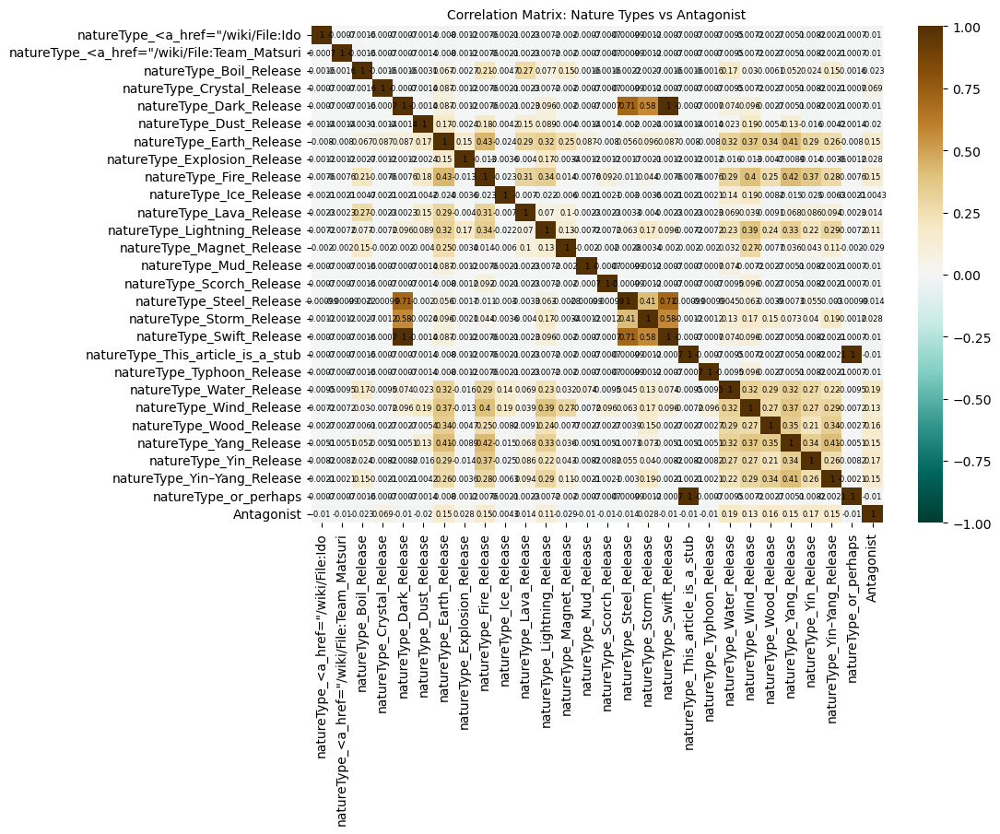

In [51]:
plt.figure(figsize=(10,7))

sns.heatmap(naturetypematrix, vmin = -1, vmax = 1, annot = True, annot_kws={'size': 6, 'color': 'black'}, cmap='BrBG_r')

plt.title('Correlation Matrix: Nature Types vs Antagonist', fontsize=10)


plt.show()

In [52]:
naturetypereport = sv.analyze(naturetype_antagonist)

                                             |                                             | [  0%]   00:00 ->…


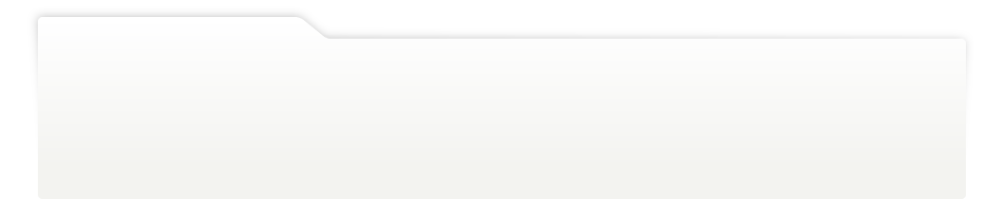
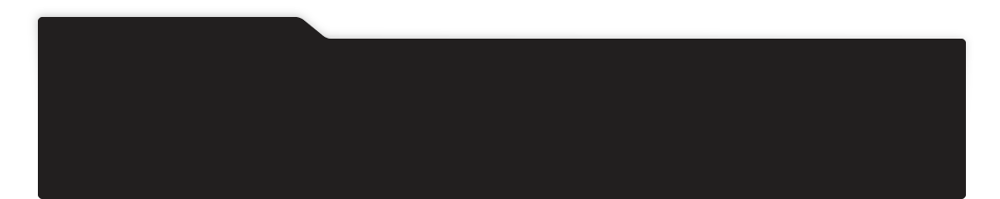
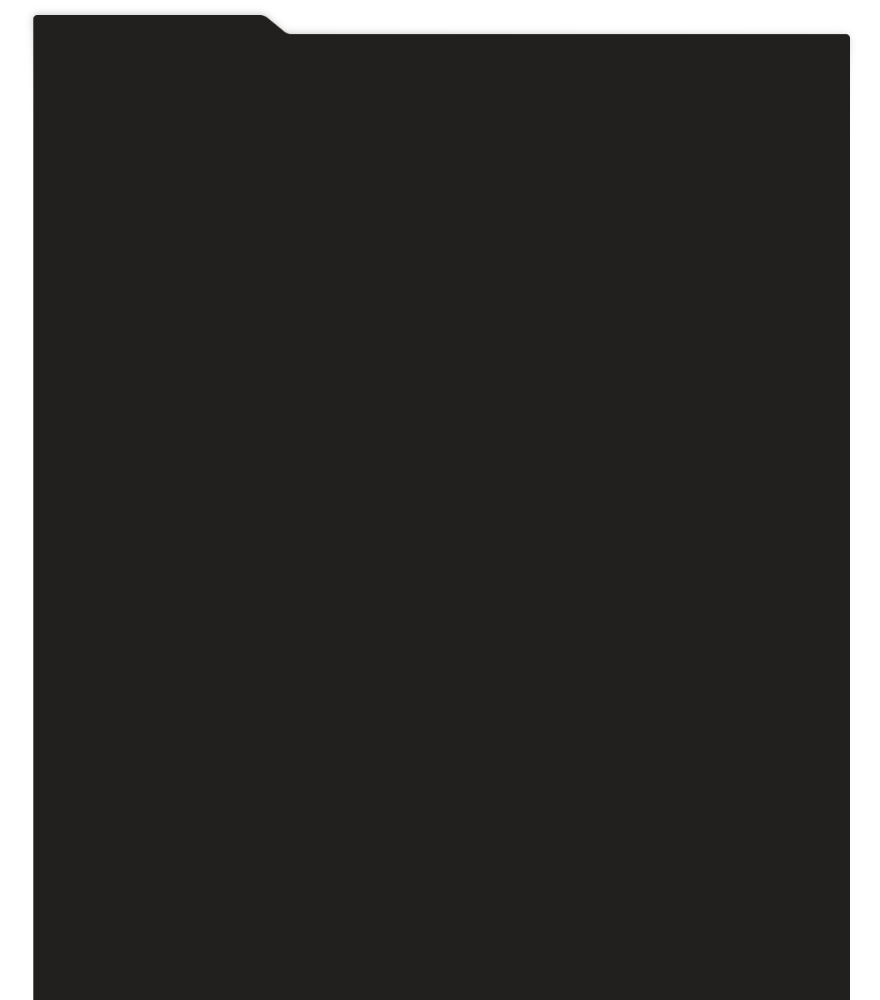
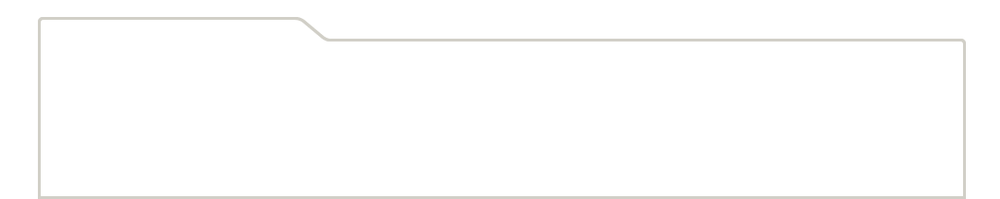
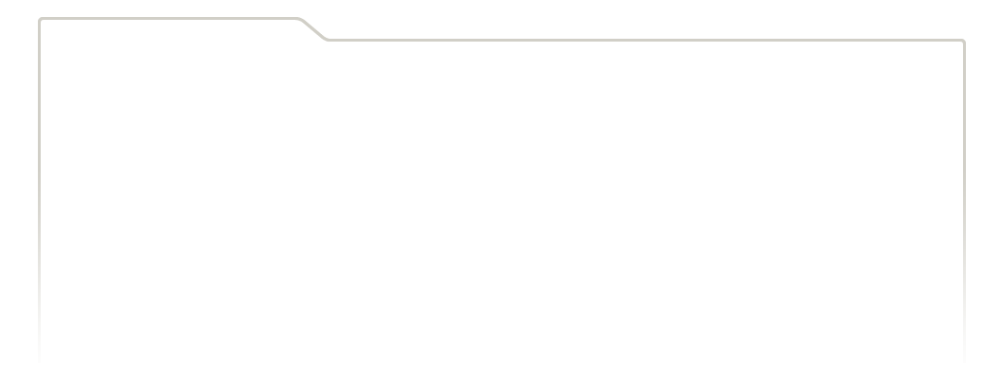
...
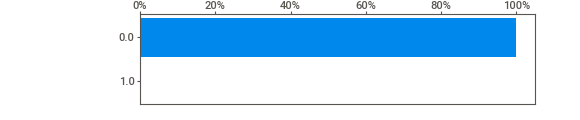
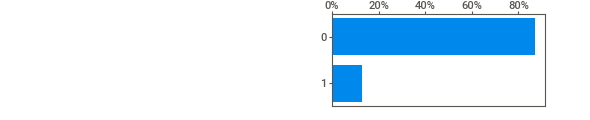
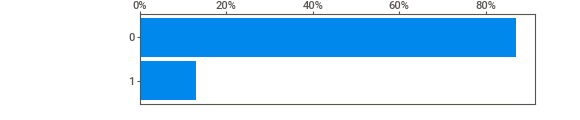
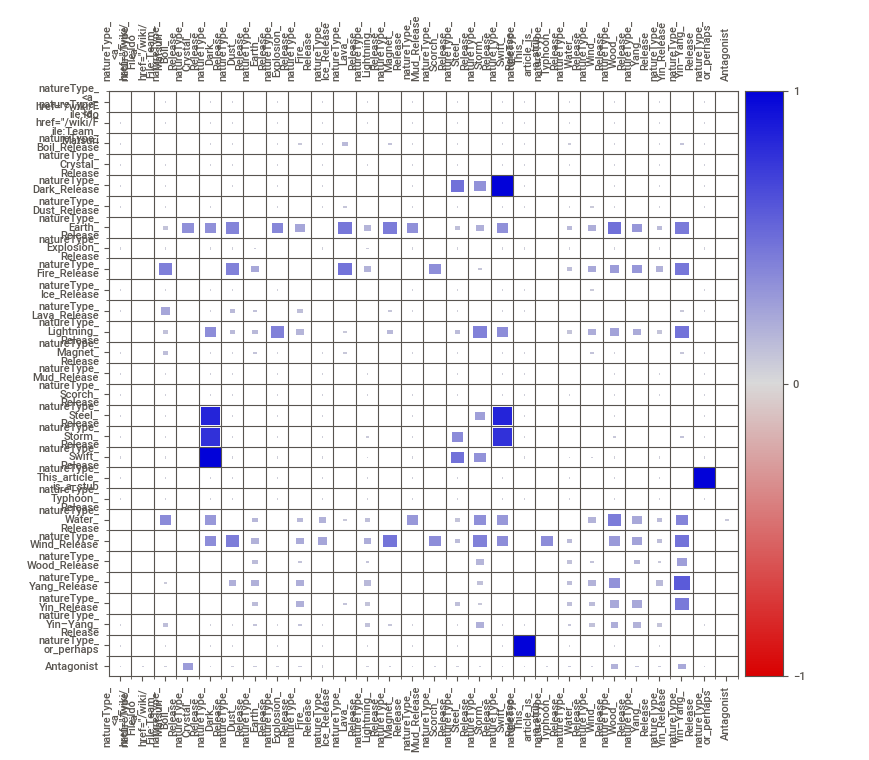
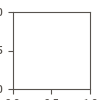

In [53]:
naturetypereport.show_notebook()

In [54]:
# Create dataframe with family
family = df[['family_adoptive aunt',
 'family_adoptive brother',
 'family_adoptive cousin',
 'family_adoptive daughter',
 'family_adoptive father',
 'family_adoptive grandfather',
 'family_adoptive grandmother',
 'family_adoptive grandson',
 'family_adoptive grandsons',
 'family_adoptive granduncle',
 'family_adoptive great nephew',
 'family_adoptive mother',
 'family_adoptive nephew',
 'family_adoptive nephews',
 'family_adoptive sister',
 'family_adoptive son',
 'family_adoptive sons',
 'family_adoptive uncle',
 'family_adoptive_aunt',
 'family_adoptive_brother',
 'family_adoptive_cousin',
 'family_adoptive_daughter',
 'family_adoptive_father',
 'family_adoptive_grandfather',
 'family_adoptive_grandmother',
 'family_adoptive_grandson',
 'family_adoptive_grandsons',
 'family_adoptive_granduncle',
 'family_adoptive_great_nephew',
 'family_adoptive_mother',
 'family_adoptive_nephew',
 'family_adoptive_nephews',
 'family_adoptive_sister',
 'family_adoptive_son',
 'family_adoptive_sons',
 'family_adoptive_uncle',
 'family_altered clone',
 'family_altered_clone',
 'family_ancestor',
 'family_aunt',
 'family_brother',
 'family_chakra donor',
 'family_chakra_donor',
 'family_clone',
 'family_clone/brother',
 'family_clone/son',
 'family_cousin',
 'family_creation',
 'family_creation/clone',
 'family_creation/clone daughter',
 'family_creation/clone_daughter',
 'family_creations',
 'family_creator',
 'family_creator/father',
 'family_daughter',
 'family_depowered form',
 'family_depowered_form',
 'family_descendant',
 'family_distant relative',
 'family_distant_relative',
 'family_ex-husband',
 'family_ex-wife',
 'family_father',
 'family_fiancé',
 'family_fiancée',
 'family_first cousin once removed',
 'family_first_cousin_once_removed',
 'family_foster father',
 'family_foster son',
 'family_foster_father',
 'family_foster_son',
 'family_genetic donor',
 'family_genetic source',
 'family_genetic template',
 'family_genetic template/parent',
 'family_genetic_donor',
 'family_genetic_source',
 'family_genetic_template',
 'family_genetic_template/parent',
 'family_godfather',
 'family_godson',
 'family_granddaughter',
 'family_grandfather',
 'family_grandmother',
 'family_grandnephew',
 'family_grandniece',
 'family_grandson',
 'family_granduncle',
 'family_great nephew',
 'family_great-granddaughter',
 'family_great-grandfather',
 'family_great-grandson',
 'family_great-great grandfather',
 'family_great-great-granddaughter',
 'family_great-great-grandfather',
 'family_great-great-grandson',
 'family_great-great_grandfather',
 'family_great_nephew',
 'family_host',
 'family_husband',
 'family_incarnation with the god tree',
 'family_incarnation_with_the_god_tree',
 'family_lover',
 'family_mother',
 'family_nephew',
 'family_niece',
 'family_older brother',
 'family_older_brother',
 'family_oldest brother',
 'family_oldest_brother',
 'family_original form',
 'family_original_form',
 'family_owner',
 'family_pet',
 'family_sibling',
 'family_sister',
 'family_son',
 'family_spouse',
 'family_step-son',
 'family_stepfather',
 'family_twin brother',
 'family_twin_brother',
 'family_uncle',
 'family_unknown kinship',
 'family_unknown_kinship',
 'family_vessel',
 'family_wife',
 'family_younger brother',
 'family_younger cousin',
 'family_younger relative',
 'family_younger_brother',
 'family_younger_cousin',
 'family_younger_relative',
 'family_youngest brother',
 'family_youngest_brother']]
family

,family_adoptive aunt,family_adoptive brother,family_adoptive cousin,family_adoptive daughter,family_adoptive father,family_adoptive grandfather,family_adoptive grandmother,family_adoptive grandson,family_adoptive grandsons,family_adoptive granduncle,...,family_vessel,family_wife,family_younger brother,family_younger cousin,family_younger relative,family_younger_brother,family_younger_cousin,family_younger_relative,family_youngest brother,family_youngest_brother
0,0,0,0,0,0,0,0,0,0,0,...,0,Hinata Uzumaki,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,Sakura Uchiha,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1427,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1428,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1429,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [55]:
# Convert names to 1 for binary
family = (family != 0).astype(int)
family

,family_adoptive aunt,family_adoptive brother,family_adoptive cousin,family_adoptive daughter,family_adoptive father,family_adoptive grandfather,family_adoptive grandmother,family_adoptive grandson,family_adoptive grandsons,family_adoptive granduncle,...,family_vessel,family_wife,family_younger brother,family_younger cousin,family_younger relative,family_younger_brother,family_younger_cousin,family_younger_relative,family_youngest brother,family_youngest_brother
0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1427,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1428,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1429,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [56]:
# Define the category mapping
familymap= {
    'Father_Figure': [
        'family_father',
        'family_adoptive_father',
        'family_adoptive father',
        'family_stepfather',
        'family_foster_father',
        'family_grandfather',
        'family_adoptive_grandfather',
        'family_adoptive grandfather',
        'family_great-grandfather',
        'family_great-great-grandfather',
        'family_great-great_grandfather',
        'family_great-great grandfather',
        'family_creator/father',
        'family_genetic_template',
        'family_genetic_template/parent',
        'family_godfather',
        'family_host',
        'family_creator',
        'family_foster father'],
    'Brother': [
        'family_brother',
        'family_adoptive_brother',
        'family_adoptive brother',
        'family_older_brother',
        'family_oldest_brother',
        'family_younger_brother',
        'family_younger brother',
        'family_youngest_brother',
        'family_twin_brother',
        'family_clone/brother',
        'family_oldest brother',
        'family_twin brother'],
    'Sister': [
        'family_sister',
        'family_adoptive_sister', 
        'family_adoptive sister',
        'family_younger sister'],
    'Son': [
        'family_son',
        'family_adoptive_son',
        'family_adoptive son',
        'family_step-son',
        'family_clone/son',
        'family_foster_son',
        'family_adoptive_sons',
        'family_foster son',
        'family_grandson',
        'family_adoptive_grandson',
        'family_adoptive_grandsons',
        'family_great-great-grandson',
        'family_godson'],
    'Mother_Figure': [
        'family_mother',
        'family_adoptive_mother',
        'family_adoptive mother',
        'family_grandmother',
        'family_adoptive_grandmother',
        'family_adoptive grandmother',
        'family_great-grandmother'],
    'Daughter': [
        'family_daughter',
        'family_adoptive_daughter',
        'family_adoptive daughter',
        'family_granddaughter',
        'family_creation/clone daughter',
        'family_creation/clone_daughter',
        'family_great-granddaughter',
        'family_great-great-granddaughter'],
    'Spouse/Partner': [
        'family_husband',
        'family_wife',
        'family_spouse',
        'family_ex-husband',
        'family_ex-wife',
        'family_fiancé',
        'family_fiancée',
        'family_lover'],
    'Extended_Family': [
        'family_aunt',
        'family_adoptive_aunt',
        'family_adoptive aunt',
        'family_uncle',
        'family_adoptive_uncle',
        'family_adoptive uncle',
        'family_granduncle',
        'family_adoptive granduncle',
        'family_cousin',
        'family_adoptive_cousin',
        'family_adoptive cousin',
        'family_younger_cousin',
        'family_first_cousin_once_removed',
        'family_first cousin once removed',
        'family_nephew',
        'family_adoptive_nephews',
        'family_adoptive_nephew',
        'family_adoptive great nephew',
        'family_adoptive_great_nephew',
        'family_adoptive nephew',
        'family_niece',
        'family_grandnephew',
        'family_grandniece',
        'family_ancestor',
        'family_descendant',
        'family_distant relative',
        'family_distant_relative',
        'family_sibling',
        'family_younger relative',
        'family_younger_relative',
        'family_younger cousin',
        'family_genetic_donor',
        'family_genetic donor',
        'family_genetic source',
        'family_genetic_source'],
    'Misc.': [
        'family_vessel',
        'family_unknown_kinship',
        'family_unknown kinship',
        'family_incarnation_with_the_god_tree',
        'family_incarnation with the god tree',
        'family_depowered form',
        'family_depowered_form',
        'family_original form',
        'family_original_form',
        'family_chakra donor',
        'family_chakra_donor',
        'family_clone',
        'family_altered clone',
        'family_altered_clone',
        'family_genetic template',
        'family_creations',
        'family_creation',
        'family_creation/clone',
        'family_pet',
        'family_owner']}

In [57]:
# Wipe Out the Family (of additional columns)
for category, columns in familymap.items():
    valid_cols = [col for col in columns if col in family.columns]
    df[category] = family[valid_cols].max(axis=1) if valid_cols else 0


In [58]:
# Drop redundant columns
df = df.drop(columns=family.columns.tolist())
df

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,personal_clan_Sendō,Father_Figure,Brother,Sister,Son,Mother_Figure,Daughter,Spouse/Partner,Extended_Family,Misc.
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,1,0,0,1,1,1,1,0,0
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,1,1,0,0,1,1,1,0,0
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,0.0,1,1,0,0,0,0,0,0,0
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,1,0,0,0,0,0,0,0,0
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,0.0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1290,Hazuki Uchiha,0,0,0,0,0,0,0,0,...,0.0,0,0,0,0,0,1,0,0,0
1427,1298,Kagen Uchiha,0,0,0,0,0,0,0,0,...,0.0,0,0,0,0,0,0,0,0,0
1428,1422,Zenigoke,0,0,0,0,0,Naruto: The Broken Bond,0,Game,...,0.0,0,1,0,0,0,0,0,0,0
1429,1424,Zetsu,0,0,0,0,0,0,0,0,...,0.0,0,0,0,0,0,0,0,0,0


In [59]:
sorted(df.columns.tolist())

['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_count',
 'id',
 'images',
 'jutsu',
 'jutsu_count',
 'name',
 'natureType',
 'natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natu

In [60]:
family = df[['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner']]
family

,Antagonist,Brother,Daughter,Extended_Family,Father_Figure,Misc.,Mother_Figure,Sister,Son,Spouse/Partner
0,0,0,1,0,1,0,1,0,1,1
1,1,1,1,0,1,0,1,0,0,1
2,1,1,0,0,1,0,0,0,0,0
3,1,0,0,0,1,0,0,0,0,0
4,1,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
1426,0,0,1,0,0,0,0,0,0,0
1427,0,0,0,0,0,0,0,0,0,0
1428,0,1,0,0,0,0,0,0,0,0
1429,0,0,0,0,0,0,0,0,0,0


In [61]:
familymatrix = family.corr()
familymatrix

,Antagonist,Brother,Daughter,Extended_Family,Father_Figure,Misc.,Mother_Figure,Sister,Son,Spouse/Partner
Antagonist,1.000000,0.091603,-0.042953,0.007876,0.052765,0.126020,0.033724,-0.026121,-0.029456,-0.060920
Brother,0.091603,1.000000,-0.011546,0.167957,0.284373,0.013499,0.210423,0.170439,0.023536,0.013360
Daughter,-0.042953,-0.011546,1.000000,0.004773,0.034044,0.035362,0.060597,-0.019706,0.307488,0.381375
Extended_Family,0.007876,0.167957,0.004773,1.000000,0.448939,0.107129,0.356557,0.159402,0.021390,0.055409
Father_Figure,0.052765,0.284373,0.034044,0.448939,1.000000,0.166591,0.420109,0.209932,0.025886,0.083710
Misc.,0.126020,0.013499,0.035362,0.107129,0.166591,1.000000,0.058970,-0.023646,0.056368,0.002861
Mother_Figure,0.033724,0.210423,0.060597,0.356557,0.420109,0.058970,1.000000,0.214775,0.043569,0.129536
Sister,-0.026121,0.170439,-0.019706,0.159402,0.209932,-0.023646,0.214775,1.000000,-0.014567,0.007084
Son,-0.029456,0.023536,0.307488,0.021390,0.025886,0.056368,0.043569,-0.014567,1.000000,0.406887
Spouse/Partner,-0.060920,0.013360,0.381375,0.055409,0.083710,0.002861,0.129536,0.007084,0.406887,1.000000


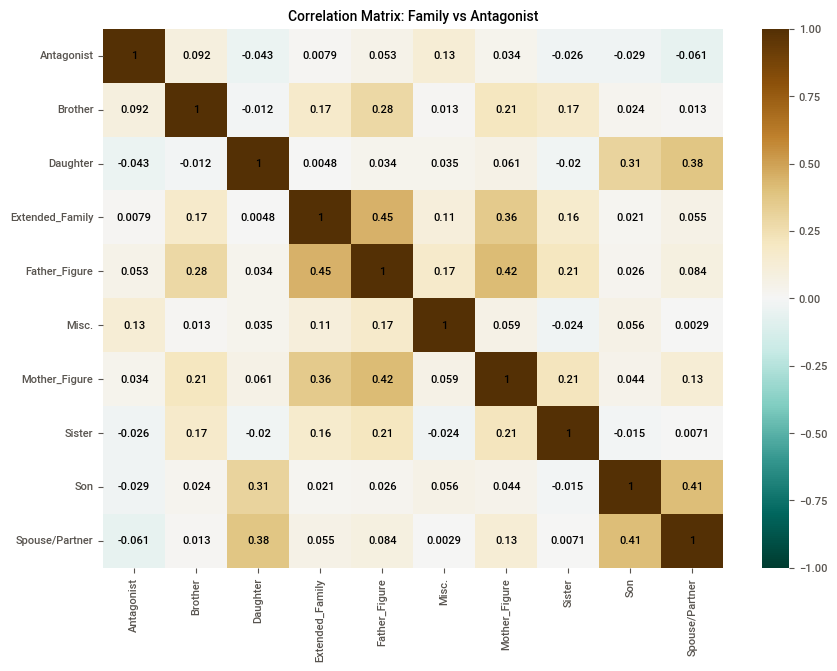

In [62]:
plt.figure(figsize=(10,7))

sns.heatmap(familymatrix, vmin = -1, vmax = 1, annot =  True, annot_kws={'size': 8, 'color': 'black'}, cmap='BrBG_r')

plt.title('Correlation Matrix: Family vs Antagonist', fontsize=10)

plt.show()

In [63]:
familyreport = sv.analyze(family)

                                             |                                             | [  0%]   00:00 ->…


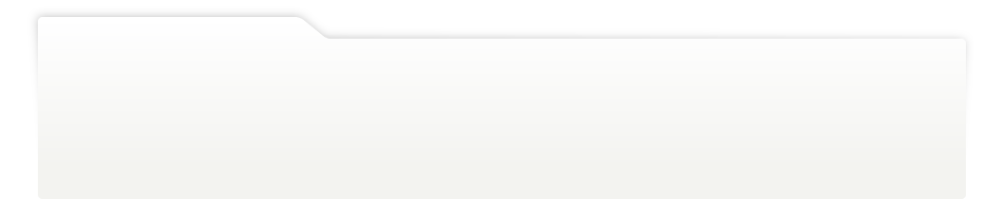
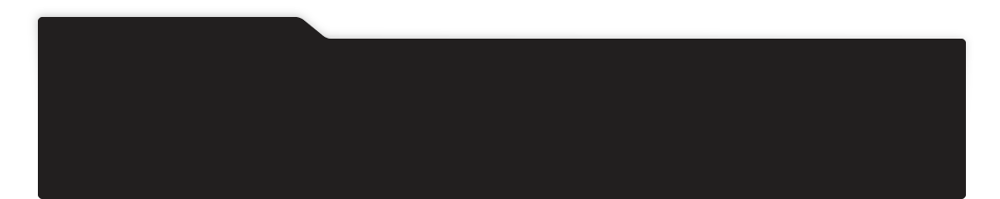
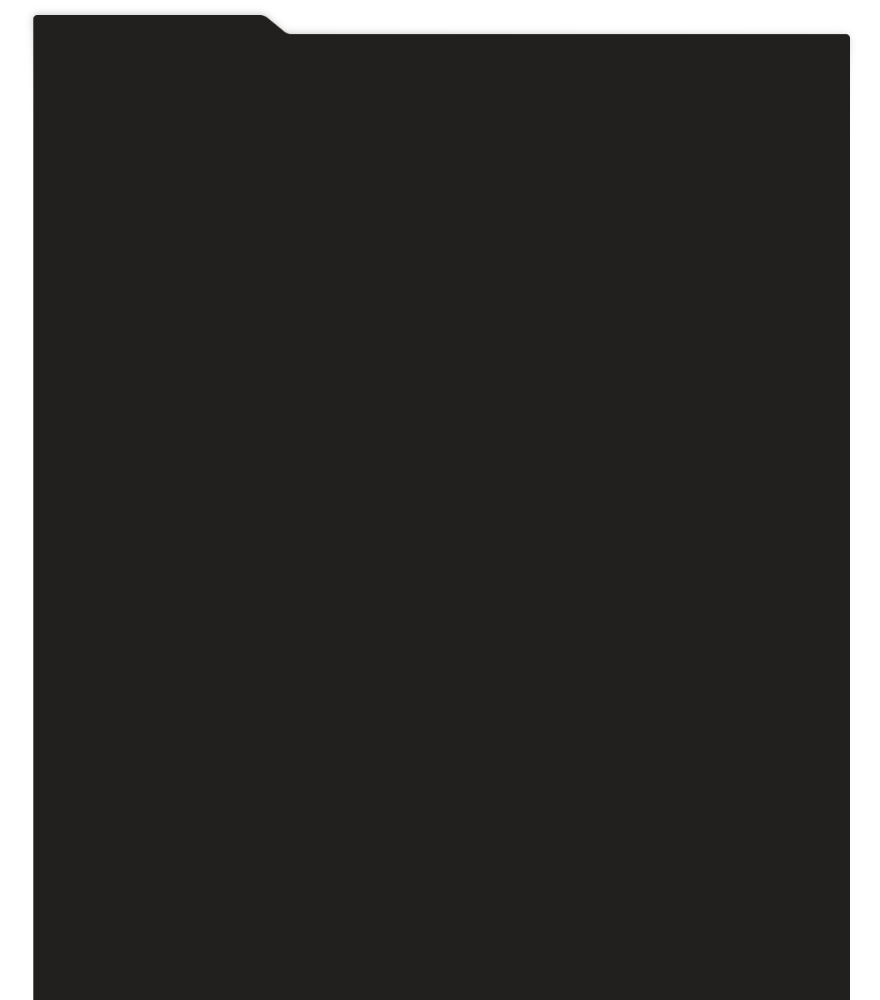
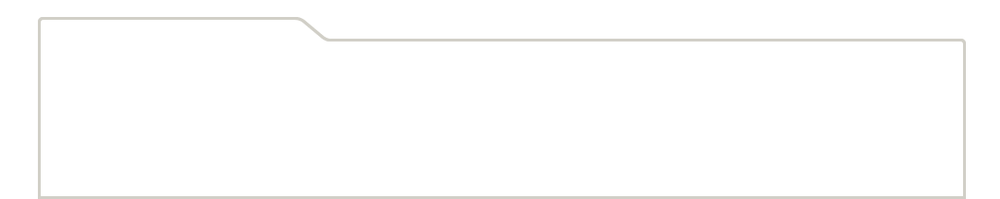
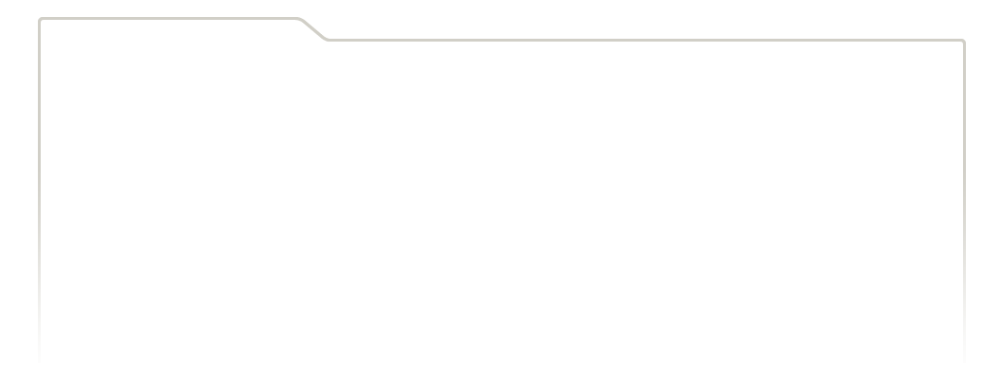
...
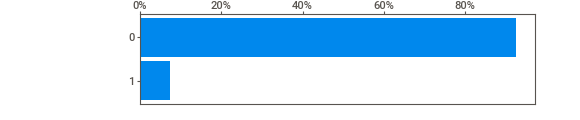
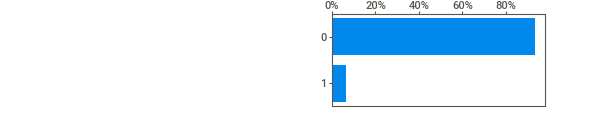
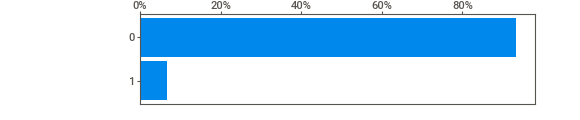
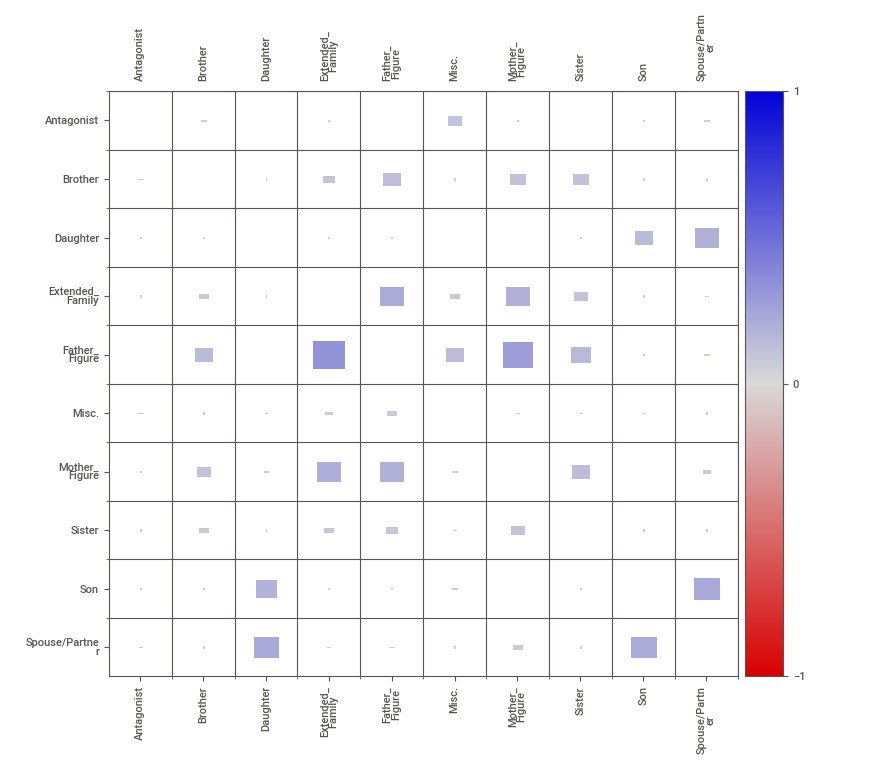
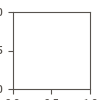

In [64]:
familyreport.show_notebook()

In [65]:
sorted(df.columns.tolist())

['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_count',
 'id',
 'images',
 'jutsu',
 'jutsu_count',
 'name',
 'natureType',
 'natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natu

In [66]:
# Review Affiliations:
affiliations = df[['personal_affiliation',
 'personal_affiliation_Akatsuki',
 'personal_affiliation_Allied_Shinobi_Forces',
 'personal_affiliation_Ame_Orphans"Ame_Orphans"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Amegakure',
 'personal_affiliation_Ankorodō',
 'personal_affiliation_Bamboo_Village',
 'personal_affiliation_Benisu_Island',
 'personal_affiliation_Castle_Dusk',
 'personal_affiliation_Cat_Fortress',
 'personal_affiliation_Ceramic_Village',
 'personal_affiliation_Daidai_Village',
 'personal_affiliation_Enka_Ninja"Enka_Ninja"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_File:Land_of_Calm_Seas_Symbol.svg_Land_of_Calm_Seas',
 'personal_affiliation_File:Land_of_Haze_Symbol.svg_Land_of_Haze',
 'personal_affiliation_Fire_Temple',
 'personal_affiliation_Genjutsu_Tree_Village',
 'personal_affiliation_Green_Banks',
 'personal_affiliation_Hachō_Village',
 'personal_affiliation_Himeyuri_Company"Himeyuri_Company"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Hoshigakure',
 'personal_affiliation_Howling_Wolf_Village',
 'personal_affiliation_Inaho_Village',
 'personal_affiliation_Ishigakure',
 'personal_affiliation_Iwagakure',
 'personal_affiliation_Jōmae_Village',
 'personal_affiliation_Kabuto_Yakushi"Kabuto_Yakushi"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Kagerō_Village',
 'personal_affiliation_Kamizuru_Clan',
 'personal_affiliation_Kaneki_Corporation"Kaneki_Corporation"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Kara',
 'personal_affiliation_Kazahana_Castle',
 'personal_affiliation_Kirigakure',
 'personal_affiliation_Konoha_Orphanage',
 'personal_affiliation_Konohagakure',
 'personal_affiliation_Kumogakure',
 'personal_affiliation_Kusabi_Real_Estate"Kusabi_Real_Estate"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Kusagakure',
 'personal_affiliation_Land_of_Ancestors',
 'personal_affiliation_Land_of_Bamboo',
 'personal_affiliation_Land_of_Bean_Jam',
 'personal_affiliation_Land_of_Birds',
 'personal_affiliation_Land_of_Claws',
 'personal_affiliation_Land_of_Demons',
 'personal_affiliation_Land_of_Earth',
 'personal_affiliation_Land_of_Fangs',
 'personal_affiliation_Land_of_Fire',
 'personal_affiliation_Land_of_Forests',
 'personal_affiliation_Land_of_Frost',
 'personal_affiliation_Land_of_Honey',
 'personal_affiliation_Land_of_Hot_Water',
 'personal_affiliation_Land_of_Iron',
 'personal_affiliation_Land_of_Lightning',
 'personal_affiliation_Land_of_Mountains',
 'personal_affiliation_Land_of_Neck',
 'personal_affiliation_Land_of_Noodles',
 'personal_affiliation_Land_of_Redaku',
 'personal_affiliation_Land_of_Rivers',
 'personal_affiliation_Land_of_Sand',
 'personal_affiliation_Land_of_Silence',
 'personal_affiliation_Land_of_Snow',
 'personal_affiliation_Land_of_Sound',
 'personal_affiliation_Land_of_Stone',
 'personal_affiliation_Land_of_Swamps',
 'personal_affiliation_Land_of_Tea',
 'personal_affiliation_Land_of_That',
 'personal_affiliation_Land_of_This',
 'personal_affiliation_Land_of_Valleys',
 'personal_affiliation_Land_of_Vegetables',
 'personal_affiliation_Land_of_Water',
 'personal_affiliation_Land_of_Waves',
 'personal_affiliation_Land_of_Wind',
 'personal_affiliation_Land_of_Woods',
 'personal_affiliation_Land_of_the_Moon',
 'personal_affiliation_Land_of_the_Sea',
 'personal_affiliation_Land_of_the_Sky',
 'personal_affiliation_Makibi_Company"Makibi_Company"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Makibi_Corporation"Makibi_Corporation"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Mokuzu_Island',
 'personal_affiliation_Moon',
 'personal_affiliation_Mount_Myōboku',
 'personal_affiliation_Mount_Shumisen',
 'personal_affiliation_Nadeshiko_Village',
 'personal_affiliation_Nara_Clan',
 'personal_affiliation_Otogakure',
 'personal_affiliation_Purple_Moon_Island',
 'personal_affiliation_Root',
 'personal_affiliation_Ryūchi_Cave',
 'personal_affiliation_Rōran',
 'personal_affiliation_Shangri-la',
 'personal_affiliation_Shikkotsu_Forest',
 'personal_affiliation_Shuku_Village"Shuku_Village"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Sora-ku',
 'personal_affiliation_Sunagakure',
 'personal_affiliation_Takigakure',
 'personal_affiliation_Takumi_Village',
 "personal_affiliation_Temujin's_Continent",
 'personal_affiliation_Tonika_Village',
 'personal_affiliation_Tree_Felling_Village',
 'personal_affiliation_Tsuchigumo_Clan',
 'personal_affiliation_Tsuchigumo_Village',
 'personal_affiliation_Tsukigakure',
 'personal_affiliation_Uzushiogakure',
 'personal_affiliation_Valley_of_Great_Evil"Valley_of_Great_Evil"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.',
 'personal_affiliation_Yugakure',
 'personal_affiliation_Yukigakure',
 'personal_affiliation_Yumegakure',
 'personal_affiliation_count',
 'personal_affiliation_Ōtsutsuki_Clan','Antagonist']]
affiliations

,personal_affiliation,personal_affiliation_Akatsuki,personal_affiliation_Allied_Shinobi_Forces,"personal_affiliation_Ame_Orphans""Ame_Orphans""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_affiliation_Amegakure,personal_affiliation_Ankorodō,personal_affiliation_Bamboo_Village,personal_affiliation_Benisu_Island,personal_affiliation_Castle_Dusk,personal_affiliation_Cat_Fortress,...,personal_affiliation_Tsuchigumo_Village,personal_affiliation_Tsukigakure,personal_affiliation_Uzushiogakure,"personal_affiliation_Valley_of_Great_Evil""Valley_of_Great_Evil""_is_not_in_the_list__of_allowed_values_for_the_""Affiliation""_property.",personal_affiliation_Yugakure,personal_affiliation_Yukigakure,personal_affiliation_Yumegakure,personal_affiliation_count,personal_affiliation_Ōtsutsuki_Clan,Antagonist
0,"Konohagakure, Mount Myōboku, Allied Shinobi Fo...",0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0
1,"Konohagakure, Otogakure, Ryūchi Cave, Akatsuki",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,1
2,"Konohagakure, Akatsuki",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1
3,"Konohagakure, Root, Allied Shinobi Forces",0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,1
4,"Konohagakure, Root, Akatsuki, Otogakure, Ryūch...",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,Konohagakure,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1427,Konohagakure,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1428,,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1429,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [67]:
df = df.drop(['personal_affiliation'], axis = 1)
df

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,personal_clan_Sendō,Father_Figure,Brother,Sister,Son,Mother_Figure,Daughter,Spouse/Partner,Extended_Family,Misc.
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,1,0,0,1,1,1,1,0,0
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,1,1,0,0,1,1,1,0,0
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,0.0,1,1,0,0,0,0,0,0,0
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0.0,1,0,0,0,0,0,0,0,0
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,0.0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1290,Hazuki Uchiha,0,0,0,0,0,0,0,0,...,0.0,0,0,0,0,0,1,0,0,0
1427,1298,Kagen Uchiha,0,0,0,0,0,0,0,0,...,0.0,0,0,0,0,0,0,0,0,0
1428,1422,Zenigoke,0,0,0,0,0,Naruto: The Broken Bond,0,Game,...,0.0,0,1,0,0,0,0,0,0,0
1429,1424,Zetsu,0,0,0,0,0,0,0,0,...,0.0,0,0,0,0,0,0,0,0,0


In [68]:
# Renaming long fields for naturetype
df = df.rename(columns={'personal_affiliation_Ame_Orphans"Ame_Orphans"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                   :'personal_affiliation_Ame_Orphans',
                   'personal_affiliation_Enka_Ninja"Enka_Ninja"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Enka_Ninja',
                    'personal_affiliation_File:Land_of_Calm_Seas_Symbol.svg_Land_of_Calm_Seas'
                    :'personal_affiliation_Land_of_Calm_Seas',
                    'personal_affiliation_File:Land_of_Haze_Symbol.svg_Land_of_Haze'
                    :'personal_affiliation_Land_of_Haze',
                    'personal_affiliation_Himeyuri_Company"Himeyuri_Company"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Himeyuri_Company',
                    'personal_affiliation_Kabuto_Yakushi"Kabuto_Yakushi"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Kabuto_Yakushi',
                     'personal_affiliation_Kaneki_Corporation"Kaneki_Corporation"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Kaneki_Corporation',
                    'personal_affiliation_Kusabi_Real_Estate"Kusabi_Real_Estate"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Kusabi_Real_Estate',
                    'personal_affiliation_Makibi_Company"Makibi_Company"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Makibi_Company',
                    'personal_affiliation_Makibi_Corporation"Makibi_Corporation"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Makibi_Corporation',
                     'personal_affiliation_Shuku_Village"Shuku_Village"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Shuku_Village',
                    'personal_affiliation_Valley_of_Great_Evil"Valley_of_Great_Evil"_is_not_in_the_list__of_allowed_values_for_the_"Affiliation"_property.'
                    :'personal_affiliation_Valley_of_Great_Evil'
                       })

In [69]:
# Redefine Affiliation
affiliations = df[['Antagonist','personal_affiliation_Akatsuki',
 'personal_affiliation_Allied_Shinobi_Forces',
 'personal_affiliation_Ame_Orphans',
 'personal_affiliation_Amegakure',
 'personal_affiliation_Ankorodō',
 'personal_affiliation_Bamboo_Village',
 'personal_affiliation_Benisu_Island',
 'personal_affiliation_Castle_Dusk',
 'personal_affiliation_Cat_Fortress',
 'personal_affiliation_Ceramic_Village',
 'personal_affiliation_Daidai_Village',
 'personal_affiliation_Enka_Ninja',
 'personal_affiliation_Land_of_Calm_Seas',
 'personal_affiliation_Land_of_Haze',
 'personal_affiliation_Fire_Temple',
 'personal_affiliation_Genjutsu_Tree_Village',
 'personal_affiliation_Green_Banks',
 'personal_affiliation_Hachō_Village',
 'personal_affiliation_Himeyuri_Company',
 'personal_affiliation_Hoshigakure',
 'personal_affiliation_Howling_Wolf_Village',
 'personal_affiliation_Inaho_Village',
 'personal_affiliation_Ishigakure',
 'personal_affiliation_Iwagakure',
 'personal_affiliation_Jōmae_Village',
 'personal_affiliation_Kabuto_Yakushi',
 'personal_affiliation_Kagerō_Village',
 'personal_affiliation_Kamizuru_Clan',
 'personal_affiliation_Kaneki_Corporation',
 'personal_affiliation_Kara',
 'personal_affiliation_Kazahana_Castle',
 'personal_affiliation_Kirigakure',
 'personal_affiliation_Konoha_Orphanage',
 'personal_affiliation_Konohagakure',
 'personal_affiliation_Kumogakure',
 'personal_affiliation_Kusabi_Real_Estate',
 'personal_affiliation_Kusagakure',
 'personal_affiliation_Land_of_Ancestors',
 'personal_affiliation_Land_of_Bamboo',
 'personal_affiliation_Land_of_Bean_Jam',
 'personal_affiliation_Land_of_Birds',
 'personal_affiliation_Land_of_Claws',
 'personal_affiliation_Land_of_Demons',
 'personal_affiliation_Land_of_Earth',
 'personal_affiliation_Land_of_Fangs',
 'personal_affiliation_Land_of_Fire',
 'personal_affiliation_Land_of_Forests',
 'personal_affiliation_Land_of_Frost',
 'personal_affiliation_Land_of_Honey',
 'personal_affiliation_Land_of_Hot_Water',
 'personal_affiliation_Land_of_Iron',
 'personal_affiliation_Land_of_Lightning',
 'personal_affiliation_Land_of_Mountains',
 'personal_affiliation_Land_of_Neck',
 'personal_affiliation_Land_of_Noodles',
 'personal_affiliation_Land_of_Redaku',
 'personal_affiliation_Land_of_Rivers',
 'personal_affiliation_Land_of_Sand',
 'personal_affiliation_Land_of_Silence',
 'personal_affiliation_Land_of_Snow',
 'personal_affiliation_Land_of_Sound',
 'personal_affiliation_Land_of_Stone',
 'personal_affiliation_Land_of_Swamps',
 'personal_affiliation_Land_of_Tea',
 'personal_affiliation_Land_of_That',
 'personal_affiliation_Land_of_This',
 'personal_affiliation_Land_of_Valleys',
 'personal_affiliation_Land_of_Vegetables',
 'personal_affiliation_Land_of_Water',
 'personal_affiliation_Land_of_Waves',
 'personal_affiliation_Land_of_Wind',
 'personal_affiliation_Land_of_Woods',
 'personal_affiliation_Land_of_the_Moon',
 'personal_affiliation_Land_of_the_Sea',
 'personal_affiliation_Land_of_the_Sky',
 'personal_affiliation_Makibi_Company',
 'personal_affiliation_Makibi_Corporation',
 'personal_affiliation_Mokuzu_Island',
 'personal_affiliation_Moon',
 'personal_affiliation_Mount_Myōboku',
 'personal_affiliation_Mount_Shumisen',
 'personal_affiliation_Nadeshiko_Village',
 'personal_affiliation_Nara_Clan',
 'personal_affiliation_Otogakure',
 'personal_affiliation_Purple_Moon_Island',
 'personal_affiliation_Root',
 'personal_affiliation_Ryūchi_Cave',
 'personal_affiliation_Rōran',
 'personal_affiliation_Shangri-la',
 'personal_affiliation_Shikkotsu_Forest',
 'personal_affiliation_Shuku_Village',
 'personal_affiliation_Sora-ku',
 'personal_affiliation_Sunagakure',
 'personal_affiliation_Takigakure',
 'personal_affiliation_Takumi_Village',
 "personal_affiliation_Temujin's_Continent",
 'personal_affiliation_Tonika_Village',
 'personal_affiliation_Tree_Felling_Village',
 'personal_affiliation_Tsuchigumo_Clan',
 'personal_affiliation_Tsuchigumo_Village',
 'personal_affiliation_Tsukigakure',
 'personal_affiliation_Uzushiogakure',
 'personal_affiliation_Valley_of_Great_Evil',
 'personal_affiliation_Yugakure',
 'personal_affiliation_Yukigakure',
 'personal_affiliation_Yumegakure',
 'personal_affiliation_count',
 'personal_affiliation_Ōtsutsuki_Clan']]
affiliations

,Antagonist,personal_affiliation_Akatsuki,personal_affiliation_Allied_Shinobi_Forces,personal_affiliation_Ame_Orphans,personal_affiliation_Amegakure,personal_affiliation_Ankorodō,personal_affiliation_Bamboo_Village,personal_affiliation_Benisu_Island,personal_affiliation_Castle_Dusk,personal_affiliation_Cat_Fortress,...,personal_affiliation_Tsuchigumo_Clan,personal_affiliation_Tsuchigumo_Village,personal_affiliation_Tsukigakure,personal_affiliation_Uzushiogakure,personal_affiliation_Valley_of_Great_Evil,personal_affiliation_Yugakure,personal_affiliation_Yukigakure,personal_affiliation_Yumegakure,personal_affiliation_count,personal_affiliation_Ōtsutsuki_Clan
0,0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0
1,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0
2,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0
4,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1427,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1428,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1429,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [70]:
affiliationsmatrix = affiliations.corr()
affiliationsmatrix

,Antagonist,personal_affiliation_Akatsuki,personal_affiliation_Allied_Shinobi_Forces,personal_affiliation_Ame_Orphans,personal_affiliation_Amegakure,personal_affiliation_Ankorodō,personal_affiliation_Bamboo_Village,personal_affiliation_Benisu_Island,personal_affiliation_Castle_Dusk,personal_affiliation_Cat_Fortress,...,personal_affiliation_Tsuchigumo_Clan,personal_affiliation_Tsuchigumo_Village,personal_affiliation_Tsukigakure,personal_affiliation_Uzushiogakure,personal_affiliation_Valley_of_Great_Evil,personal_affiliation_Yugakure,personal_affiliation_Yukigakure,personal_affiliation_Yumegakure,personal_affiliation_count,personal_affiliation_Ōtsutsuki_Clan
Antagonist,1.000000,0.398728,-0.063976,-0.010190,0.026244,-0.010190,-0.014415,-0.017661,0.068629,-0.010190,...,-0.010190,-0.025003,-0.014415,-0.017661,-0.014415,0.027876,-0.025003,-0.025003,0.290925,0.097089
personal_affiliation_Akatsuki,0.398728,1.000000,-0.046483,-0.004063,0.134204,-0.004063,-0.005748,-0.007042,-0.004063,-0.004063,...,-0.004063,-0.009969,-0.005748,-0.007042,-0.005748,0.094748,-0.009969,-0.009969,0.273176,-0.005748
personal_affiliation_Allied_Shinobi_Forces,-0.063976,-0.046483,1.000000,-0.008001,-0.045757,-0.008001,-0.011318,-0.013867,-0.008001,-0.008001,...,-0.008001,-0.019632,-0.011318,-0.013867,-0.011318,-0.013867,-0.019632,-0.019632,0.611673,-0.011318
personal_affiliation_Ame_Orphans,-0.010190,-0.004063,-0.008001,1.000000,-0.003999,-0.000699,-0.000989,-0.001212,-0.000699,-0.000699,...,-0.000699,-0.001716,-0.000989,-0.001212,-0.000989,-0.001212,-0.001716,-0.001716,-0.012260,-0.000989
personal_affiliation_Amegakure,0.026244,0.134204,-0.045757,-0.003999,1.000000,-0.003999,-0.005658,-0.006932,-0.003999,-0.003999,...,-0.003999,-0.009814,-0.005658,-0.006932,-0.005658,-0.006932,-0.009814,-0.009814,0.007578,-0.005658
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
personal_affiliation_Yugakure,0.027876,0.094748,-0.013867,-0.001212,-0.006932,-0.001212,-0.001715,-0.002101,-0.001212,-0.001212,...,-0.001212,-0.002974,-0.001715,-0.002101,-0.001715,1.000000,-0.002974,-0.002974,0.014630,-0.001715
personal_affiliation_Yukigakure,-0.025003,-0.009969,-0.019632,-0.001716,-0.009814,-0.001716,-0.002428,-0.002974,-0.001716,-0.001716,...,-0.001716,-0.004211,-0.002428,-0.002974,-0.002428,-0.002974,1.000000,-0.004211,0.033410,-0.002428
personal_affiliation_Yumegakure,-0.025003,-0.009969,-0.019632,-0.001716,-0.009814,-0.001716,-0.002428,-0.002974,-0.001716,-0.001716,...,-0.001716,-0.004211,-0.002428,-0.002974,-0.002428,-0.002974,-0.004211,1.000000,-0.030083,-0.002428
personal_affiliation_count,0.290925,0.273176,0.611673,-0.012260,0.007578,0.049841,-0.017344,-0.021249,0.049841,-0.012260,...,0.049841,-0.030083,-0.017344,0.050509,-0.017344,0.014630,0.033410,-0.030083,1.000000,0.026584


In [71]:
affiliationsreport = sv.analyze(affiliations)

                                             |                                             | [  0%]   00:00 ->…

C:\Users\xavie\anaconda3\Lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_dataframe[feature] = pd.Series(dtype=float)
C:\Users\xavie\anaconda3\Lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_dataframe[feature] = pd.Series(dtype=float)
C:\Users\xavie\anaconda3\Lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` man


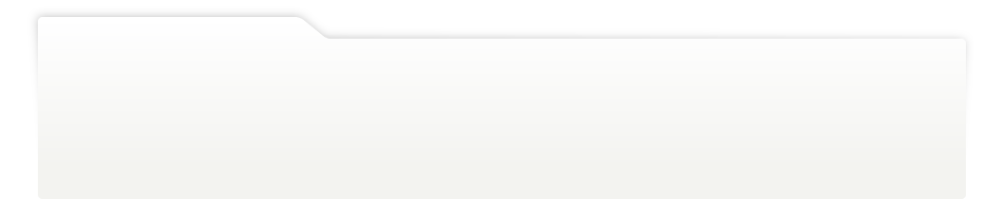
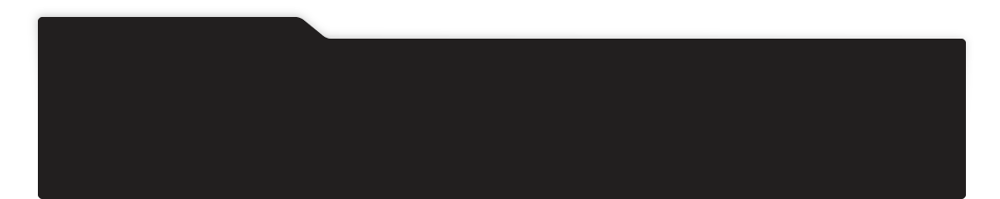
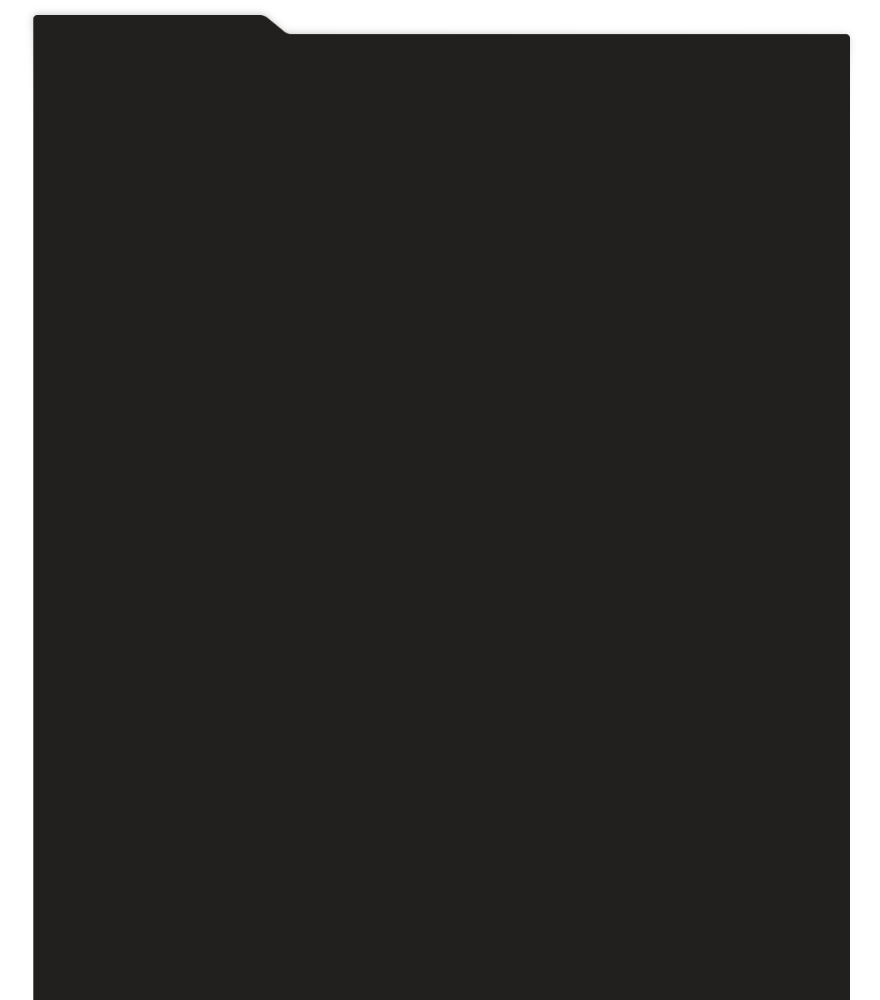
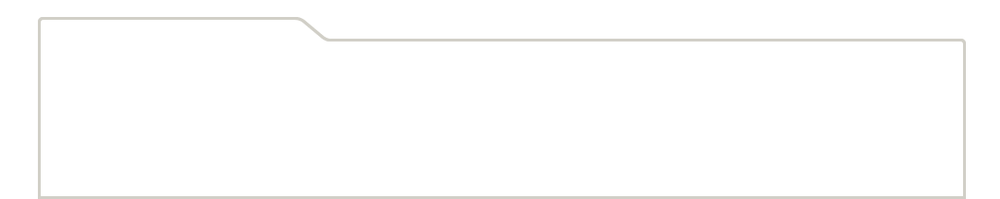
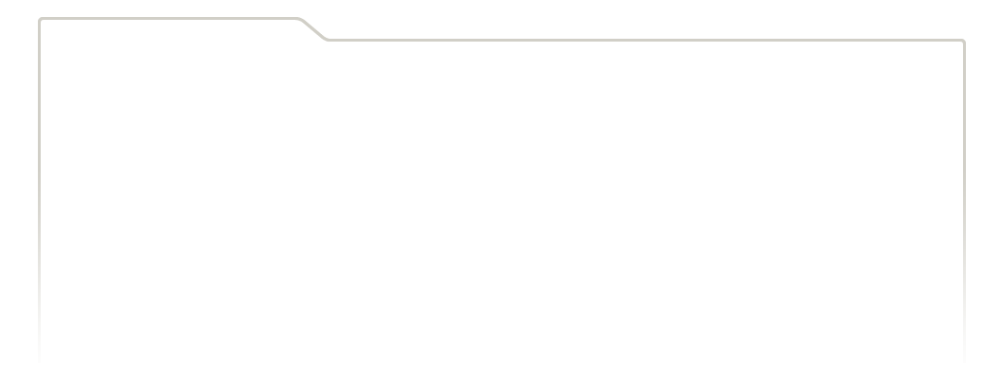
...
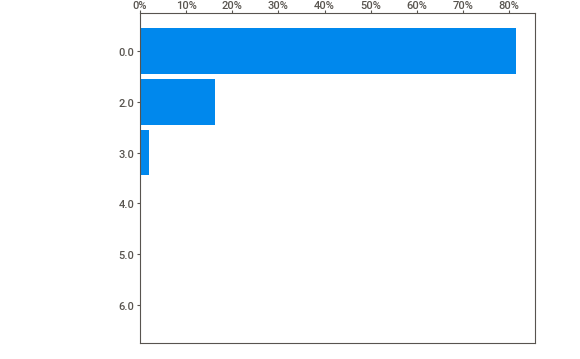
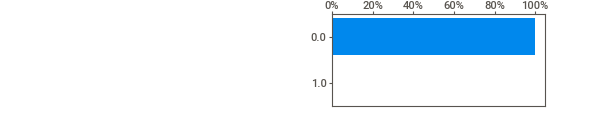
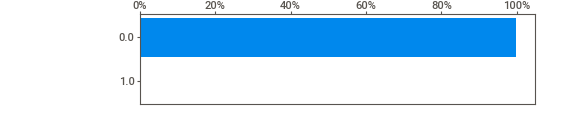
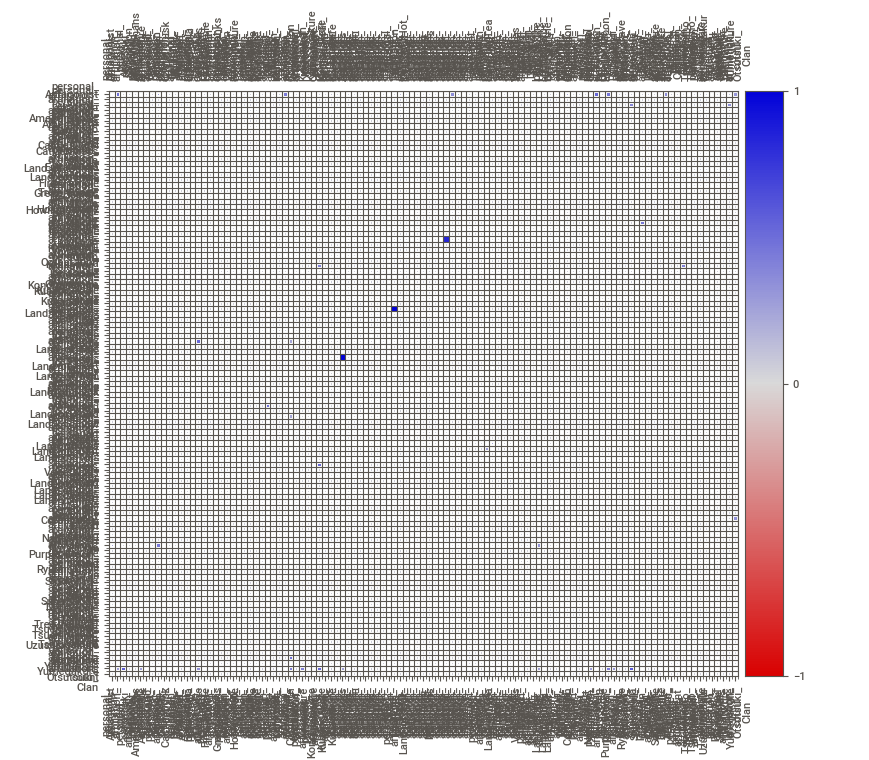
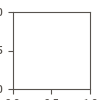

In [72]:
affiliationsreport.show_notebook()

In [73]:
affiliationsreduced = df[['Antagonist','personal_affiliation_Otogakure',
'personal_affiliation_Akatsuki',
'personal_affiliation_Root',
'personal_affiliation_Kara',
'personal_affiliation_Land_of_Silence',
'''personal_affiliation_Temujin's_Continent''',
'personal_affiliation_Ōtsutsuki_Clan',
'personal_affiliation_Castle_Dusk',
'personal_affiliation_Moon',
'personal_affiliation_Land_of_Snow',
'personal_affiliation_Land_of_the_Sea',
'personal_affiliation_Land_of_Hot_Water',
'personal_affiliation_Land_of_Ancestors',
'personal_affiliation_count']]

In [74]:
# View count of values
affiliationsreduced.sum().to_frame('Count').T

,Antagonist,personal_affiliation_Otogakure,personal_affiliation_Akatsuki,personal_affiliation_Root,personal_affiliation_Kara,personal_affiliation_Land_of_Silence,personal_affiliation_Temujin's_Continent,personal_affiliation_Ōtsutsuki_Clan,personal_affiliation_Castle_Dusk,personal_affiliation_Moon,personal_affiliation_Land_of_Snow,personal_affiliation_Land_of_the_Sea,personal_affiliation_Land_of_Hot_Water,personal_affiliation_Land_of_Ancestors,personal_affiliation_count
Count,185.0,47.0,33.0,30.0,20.0,6.0,5.0,2.0,1.0,5.0,4.0,6.0,3.0,12.0,565.0


In [75]:
armatrix = affiliationsreduced.corr()
armatrix

,Antagonist,personal_affiliation_Otogakure,personal_affiliation_Akatsuki,personal_affiliation_Root,personal_affiliation_Kara,personal_affiliation_Land_of_Silence,personal_affiliation_Temujin's_Continent,personal_affiliation_Ōtsutsuki_Clan,personal_affiliation_Castle_Dusk,personal_affiliation_Moon,personal_affiliation_Land_of_Snow,personal_affiliation_Land_of_the_Sea,personal_affiliation_Land_of_Hot_Water,personal_affiliation_Land_of_Ancestors,personal_affiliation_count
Antagonist,1.000000,0.478249,0.398728,0.379765,0.308976,0.168400,0.153673,0.097089,0.068629,0.118375,0.097951,0.103932,0.073414,0.101611,0.290925
personal_affiliation_Otogakure,0.478249,1.000000,0.180666,0.027770,-0.021940,-0.011958,-0.010912,-0.006894,0.143500,-0.010912,-0.009757,0.230759,-0.008447,-0.016947,0.158570
personal_affiliation_Akatsuki,0.398728,0.180666,1.000000,0.042512,-0.018292,-0.009969,-0.009098,-0.005748,-0.004063,-0.009098,-0.008134,-0.009969,-0.007042,-0.014129,0.273176
personal_affiliation_Root,0.379765,0.027770,0.042512,1.000000,-0.017422,-0.009495,-0.008665,-0.005474,-0.003870,-0.008665,-0.007747,-0.009495,-0.006707,-0.013457,0.338805
personal_affiliation_Kara,0.308976,-0.021940,-0.018292,-0.017422,1.000000,-0.007725,-0.007050,-0.004454,-0.003148,-0.007050,-0.006303,-0.007725,-0.005457,-0.010948,0.126538
personal_affiliation_Land_of_Silence,0.168400,-0.011958,-0.009969,-0.009495,-0.007725,1.000000,-0.003842,-0.002428,-0.001716,-0.003842,-0.003435,-0.004211,-0.002974,-0.005967,0.033410
personal_affiliation_Temujin's_Continent,0.153673,-0.010912,-0.009098,-0.008665,-0.007050,-0.003842,1.000000,-0.002215,-0.001566,-0.003506,-0.003135,-0.003842,-0.002714,-0.005445,-0.027452
personal_affiliation_Ōtsutsuki_Clan,0.097089,-0.006894,-0.005748,-0.005474,-0.004454,-0.002428,-0.002215,1.000000,-0.000989,0.314788,-0.001981,-0.002428,-0.001715,-0.003440,0.026584
personal_affiliation_Castle_Dusk,0.068629,0.143500,-0.004063,-0.003870,-0.003148,-0.001716,-0.001566,-0.000989,1.000000,-0.001566,-0.001400,-0.001716,-0.001212,-0.002432,0.049841
personal_affiliation_Moon,0.118375,-0.010912,-0.009098,-0.008665,-0.007050,-0.003842,-0.003506,0.314788,-0.001566,1.000000,-0.003135,-0.003842,-0.002714,0.124426,0.042077


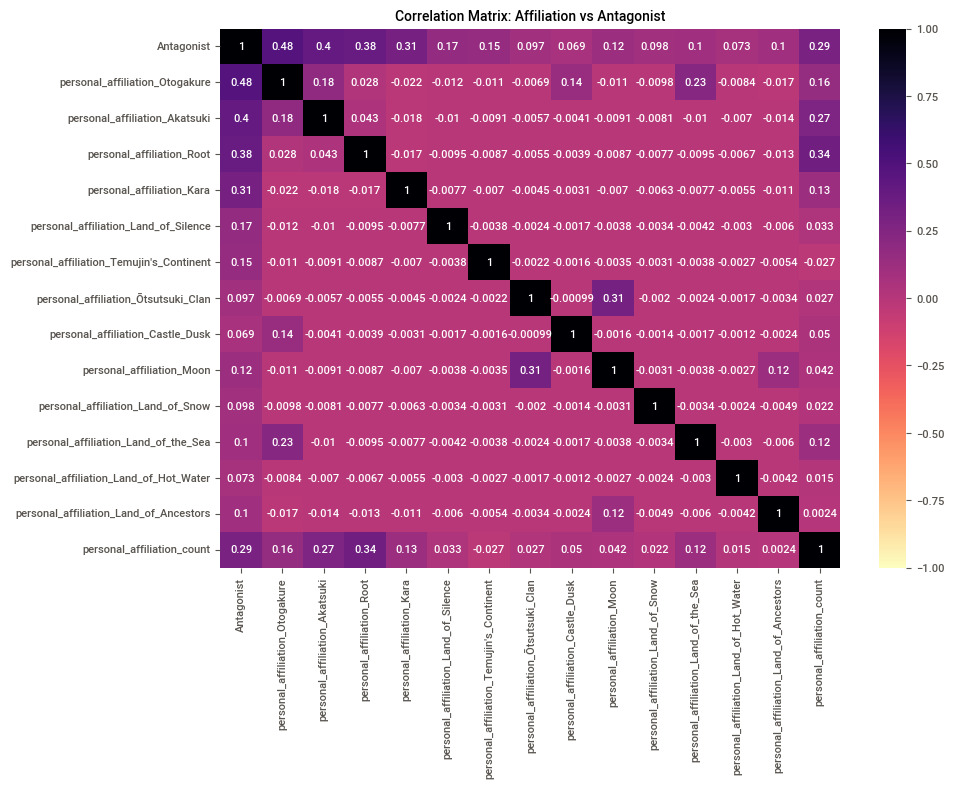

In [76]:
plt.figure(figsize=(10,7))

sns.heatmap(armatrix, vmin = -1, vmax = 1, annot = True, annot_kws={'size': 8, 'color': 'white'}, cmap='magma_r')

plt.title('Correlation Matrix: Affiliation vs Antagonist', fontsize=10)

plt.show()

In [77]:
# View reduced report with top contributors to Antagonist
arreport = sv.analyze(affiliationsreduced)

                                             |                                             | [  0%]   00:00 ->…


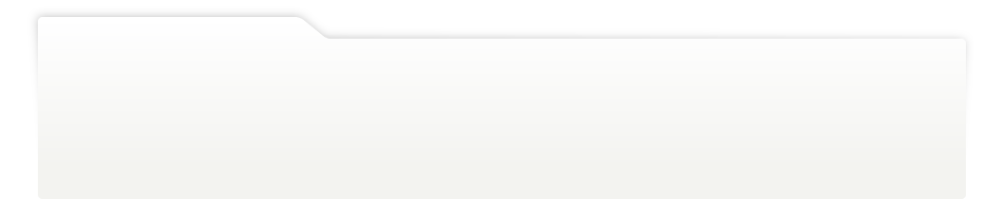
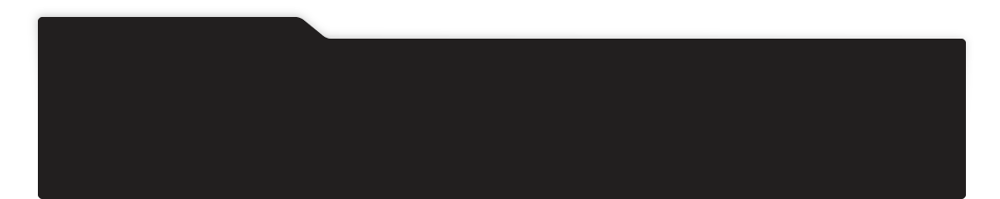
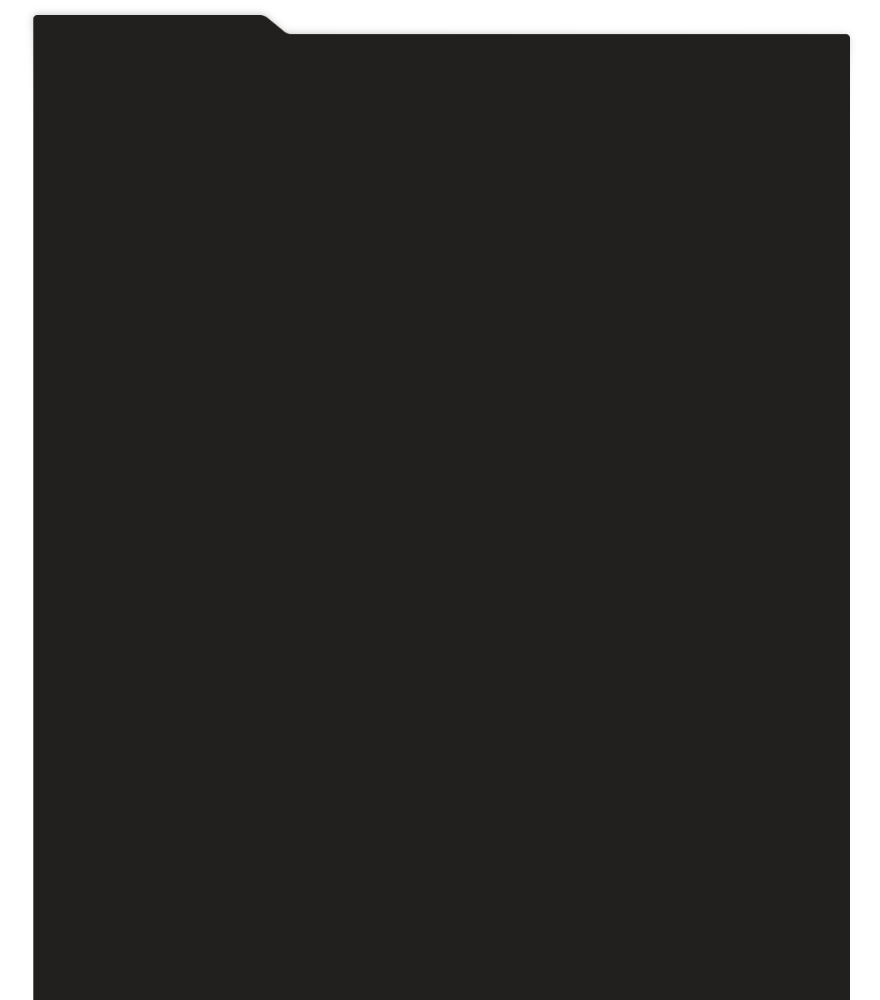
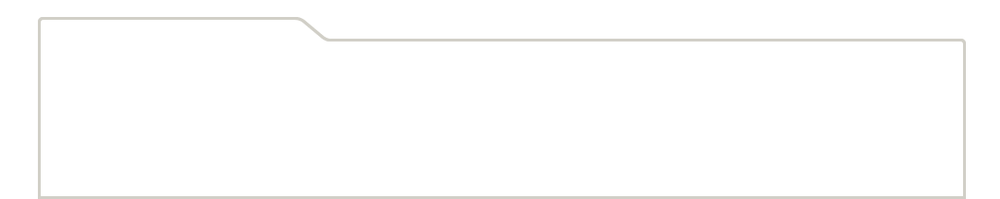
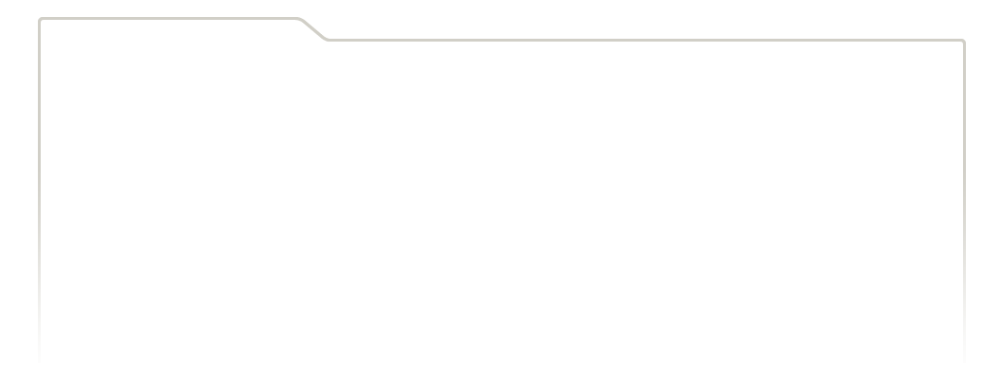
...
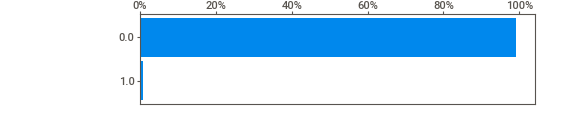
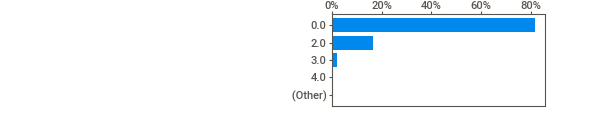
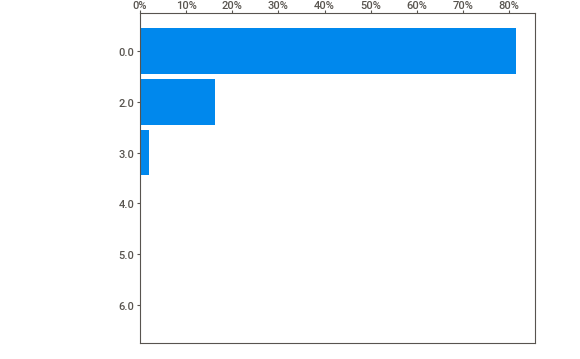
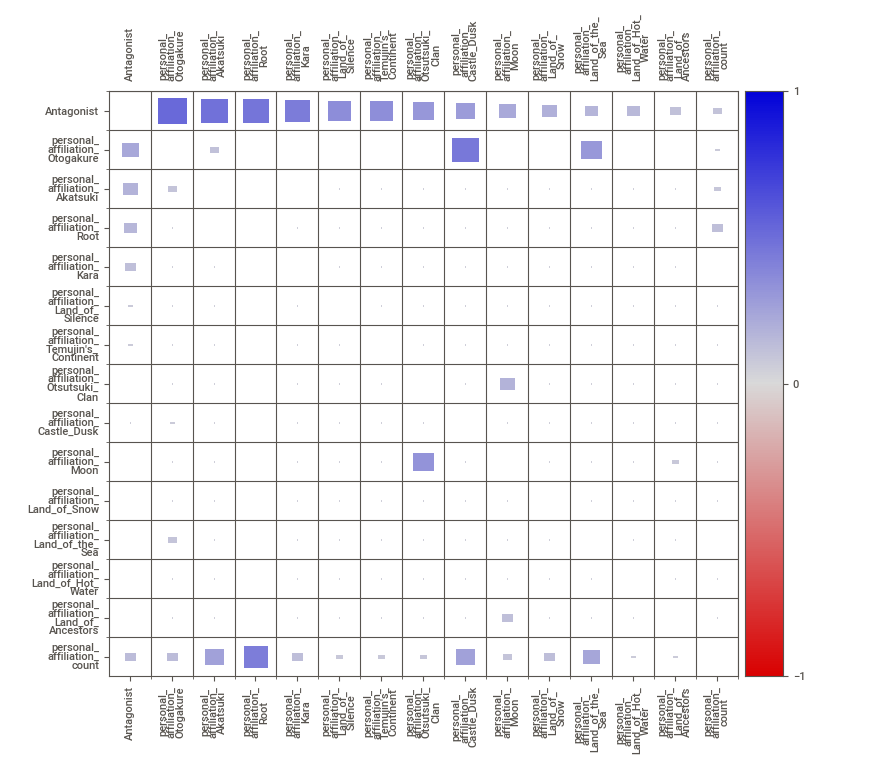
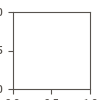

In [78]:
arreport.show_notebook()

In [79]:
sorted(df.columns.tolist())

['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_count',
 'id',
 'images',
 'jutsu',
 'jutsu_count',
 'name',
 'natureType',
 'natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natu

In [80]:
df = df.drop(['personal_clan',], axis = 1)

In [81]:
clan = df[['Antagonist',
 'personal_clan_Aburame',
 'personal_clan_Akimichi',
 'personal_clan_Amagiri',
 'personal_clan_Chinoike',
 'personal_clan_Funato',
 'personal_clan_Fūma',
 'personal_clan_Hatake',
 'personal_clan_Hirasaka',
 'personal_clan_Hoshigaki',
 'personal_clan_Hyūga',
 'personal_clan_Hyūga_Clan',
 'personal_clan_Hōki_Family',
 'personal_clan_Hōzuki',
 'personal_clan_Iburi',
 'personal_clan_Inuzuka',
 'personal_clan_Izuno',
 "personal_clan_Jūgo's",
 'personal_clan_Kagetsu_Family',
 'personal_clan_Kaguya',
 'personal_clan_Kamizuru',
 'personal_clan_Karatachi_Family',
 'personal_clan_Kazekage',
 'personal_clan_Kazekage_Clan',
 'personal_clan_Kedōin',
 'personal_clan_Kodon',
 'personal_clan_Kurama',
 'personal_clan_Lee',
 'personal_clan_Nara',
 'personal_clan_Onikuma',
 'personal_clan_Rinha',
 'personal_clan_Ryū',
 'personal_clan_Sarutobi',
 'personal_clan_Sendō',
 'personal_clan_Senju',
 'personal_clan_Senju_Clan',
 'personal_clan_Shiin',
 'personal_clan_Shimura',
 'personal_clan_Shirogane',
 'personal_clan_Tenrō',
 'personal_clan_Tsuchigumo',
 'personal_clan_Uchiha',
 'personal_clan_Uzumaki',
 'personal_clan_Uzumaki_Clan',
 'personal_clan_Wagarashi_Family',
 'personal_clan_Wagarashi_family',
 'personal_clan_Wasabi_Family',
 'personal_clan_Yamanaka',
 'personal_clan_Yoimura',
 "personal_clan_Yota's",
 'personal_clan_Yotsuki',
 'personal_clan_Yuki',
 'personal_clan_count',
 'personal_clan_Ōtsutsuki']]
clan

,Antagonist,personal_clan_Aburame,personal_clan_Akimichi,personal_clan_Amagiri,personal_clan_Chinoike,personal_clan_Funato,personal_clan_Fūma,personal_clan_Hatake,personal_clan_Hirasaka,personal_clan_Hoshigaki,...,personal_clan_Wagarashi_Family,personal_clan_Wagarashi_family,personal_clan_Wasabi_Family,personal_clan_Yamanaka,personal_clan_Yoimura,personal_clan_Yota's,personal_clan_Yotsuki,personal_clan_Yuki,personal_clan_count,personal_clan_Ōtsutsuki
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
2,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
3,1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
4,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
1427,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
1428,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
1429,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0


In [82]:
clanmap = {
    'personal_Clan_Hyūga': ['personal_clan_Hyūga','personal_clan_Hyūga_Clan'],
    'personal_Clan_Kazekage':['personal_clan_Kazekage','personal_clan_Kazekage_Clan'],
    'personal_Clan_Senju':['personal_clan_Senju','personal_clan_Senju_Clan'],
    'personal_Clan_Uzumaki':['personal_clan_Uzumaki','personal_clan_Uzumaki_Clan'],
    'personal_Clan_Wagarashi_Family':['personal_clan_Wagarashi_Family','personal_clan_Wagarashi_family']}

In [83]:
duplicateclan = df[['personal_clan_Hyūga','personal_clan_Hyūga_Clan',
                   'personal_clan_Kazekage','personal_clan_Kazekage_Clan',
                   'personal_clan_Senju','personal_clan_Senju_Clan',
                   'personal_clan_Uzumaki','personal_clan_Uzumaki_Clan',
                   'personal_clan_Wagarashi_Family','personal_clan_Wagarashi_family']]

In [84]:
# Add new categorical columns to main DataFrame
for category, columns in clanmap.items():
    valid_cols = [col for col in columns if col in clan.columns]
    df[category] = clan[valid_cols].max(axis=1) if valid_cols else 0
# Drop duplicates columns    
df = df.drop(columns=duplicateclan.columns.tolist())
df

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,Mother_Figure,Daughter,Spouse/Partner,Extended_Family,Misc.,personal_Clan_Hyūga,personal_Clan_Kazekage,personal_Clan_Senju,personal_Clan_Uzumaki,personal_Clan_Wagarashi_Family
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,1,1,1,0,0,0.0,0.0,0.0,1.0,0.0
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,1,1,1,0,0,0.0,0.0,0.0,0.0,0.0
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1290,Hazuki Uchiha,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0.0,0.0,0.0,0.0,0.0
1427,1298,Kagen Uchiha,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0
1428,1422,Zenigoke,0,0,0,0,0,Naruto: The Broken Bond,0,Game,...,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0
1429,1424,Zetsu,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0


In [85]:
sorted(df.columns.tolist())

['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_count',
 'id',
 'images',
 'jutsu',
 'jutsu_count',
 'name',
 'natureType',
 'natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natu

In [86]:
# Reset clan
clan = df[['Antagonist',
 'personal_clan_Aburame',
 'personal_clan_Akimichi',
 'personal_clan_Amagiri',
 'personal_clan_Chinoike',
 'personal_clan_Funato',
 'personal_clan_Fūma',
 'personal_clan_Hatake',
 'personal_clan_Hirasaka',
 'personal_clan_Hoshigaki',
 'personal_Clan_Hyūga',
 'personal_clan_Hōki_Family',
 'personal_clan_Hōzuki',
 'personal_clan_Iburi',
 'personal_clan_Inuzuka',
 'personal_clan_Izuno',
 "personal_clan_Jūgo's",
 'personal_clan_Kagetsu_Family',
 'personal_clan_Kaguya',
 'personal_clan_Kamizuru',
 'personal_clan_Karatachi_Family',
 'personal_Clan_Kazekage',
 'personal_clan_Kedōin',
 'personal_clan_Kodon',
 'personal_clan_Kurama',
 'personal_clan_Lee',
 'personal_clan_Nara',
 'personal_clan_Onikuma',
 'personal_clan_Rinha',
 'personal_clan_Ryū',
 'personal_clan_Sarutobi',
 'personal_clan_Sendō',
 'personal_Clan_Senju',
 'personal_clan_Shiin',
 'personal_clan_Shimura',
 'personal_clan_Shirogane',
 'personal_clan_Tenrō',
 'personal_clan_Tsuchigumo',
 'personal_clan_Uchiha',
 'personal_Clan_Uzumaki',
 'personal_Clan_Wagarashi_Family',
 'personal_clan_Wasabi_Family',
 'personal_clan_Yamanaka',
 'personal_clan_Yoimura',
 "personal_clan_Yota's",
 'personal_clan_Yotsuki',
 'personal_clan_Yuki',
 'personal_clan_count',
 'personal_clan_Ōtsutsuki']]
clan

,Antagonist,personal_clan_Aburame,personal_clan_Akimichi,personal_clan_Amagiri,personal_clan_Chinoike,personal_clan_Funato,personal_clan_Fūma,personal_clan_Hatake,personal_clan_Hirasaka,personal_clan_Hoshigaki,...,personal_Clan_Uzumaki,personal_Clan_Wagarashi_Family,personal_clan_Wasabi_Family,personal_clan_Yamanaka,personal_clan_Yoimura,personal_clan_Yota's,personal_clan_Yotsuki,personal_clan_Yuki,personal_clan_count,personal_clan_Ōtsutsuki
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
2,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
3,1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
4,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
1427,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0
1428,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
1429,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0


In [87]:
clanmatrix = clan.corr()
clanmatrix

,Antagonist,personal_clan_Aburame,personal_clan_Akimichi,personal_clan_Amagiri,personal_clan_Chinoike,personal_clan_Funato,personal_clan_Fūma,personal_clan_Hatake,personal_clan_Hirasaka,personal_clan_Hoshigaki,...,personal_Clan_Uzumaki,personal_Clan_Wagarashi_Family,personal_clan_Wasabi_Family,personal_clan_Yamanaka,personal_clan_Yoimura,personal_clan_Yota's,personal_clan_Yotsuki,personal_clan_Yuki,personal_clan_count,personal_clan_Ōtsutsuki
Antagonist,1.000000,0.054913,-0.033914,-0.014415,0.097089,-0.033914,0.217709,0.041337,-0.010190,0.041337,...,0.010247,0.097089,-0.014415,0.026978,-0.014415,-0.010190,-0.010190,-0.014415,0.086914,0.248489
personal_clan_Aburame,0.054913,1.000000,-0.006599,-0.002805,-0.002805,-0.006599,-0.006290,-0.002805,-0.001983,-0.002805,...,-0.006895,-0.002805,-0.002805,-0.005622,-0.002805,-0.001983,-0.001983,-0.002805,0.158830,-0.007179
personal_clan_Akimichi,-0.033914,-0.006599,1.000000,-0.003293,-0.003293,-0.007746,-0.007383,-0.003293,-0.002327,-0.003293,...,-0.008094,-0.003293,-0.003293,-0.006599,-0.003293,-0.002327,-0.002327,-0.003293,0.186441,-0.008427
personal_clan_Amagiri,-0.014415,-0.002805,-0.003293,1.000000,-0.001400,-0.003293,-0.003138,-0.001400,-0.000989,-0.001400,...,-0.003440,-0.001400,-0.001400,-0.002805,-0.001400,-0.000989,-0.000989,-0.001400,0.079248,-0.003582
personal_clan_Chinoike,0.097089,-0.002805,-0.003293,-0.001400,1.000000,-0.003293,-0.003138,-0.001400,-0.000989,-0.001400,...,-0.003440,-0.001400,-0.001400,-0.002805,-0.001400,-0.000989,-0.000989,-0.001400,0.079248,-0.003582
personal_clan_Funato,-0.033914,-0.006599,-0.007746,-0.003293,-0.003293,1.000000,-0.007383,-0.003293,-0.002327,-0.003293,...,-0.008094,-0.003293,-0.003293,-0.006599,-0.003293,-0.002327,-0.002327,-0.003293,0.186441,-0.008427
personal_clan_Fūma,0.217709,-0.006290,-0.007383,-0.003138,-0.003138,-0.007383,1.000000,-0.003138,-0.002218,-0.003138,...,-0.007714,-0.003138,-0.003138,-0.006290,-0.003138,-0.002218,-0.002218,-0.003138,0.177702,-0.008032
personal_clan_Hatake,0.041337,-0.002805,-0.003293,-0.001400,-0.001400,-0.003293,-0.003138,1.000000,-0.000989,-0.001400,...,-0.003440,-0.001400,-0.001400,-0.002805,-0.001400,-0.000989,-0.000989,-0.001400,0.079248,-0.003582
personal_clan_Hirasaka,-0.010190,-0.001983,-0.002327,-0.000989,-0.000989,-0.002327,-0.002218,-0.000989,1.000000,-0.000989,...,-0.002432,-0.000989,-0.000989,-0.001983,-0.000989,-0.000699,-0.000699,-0.000989,0.056017,-0.002532
personal_clan_Hoshigaki,0.041337,-0.002805,-0.003293,-0.001400,-0.001400,-0.003293,-0.003138,-0.001400,-0.000989,1.000000,...,-0.003440,-0.001400,-0.001400,-0.002805,-0.001400,-0.000989,-0.000989,-0.001400,0.079248,-0.003582


In [88]:
clanreport = sv.analyze(clan)

                                             |                                             | [  0%]   00:00 ->…


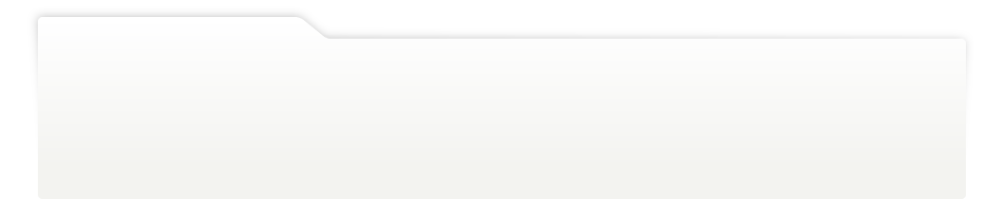
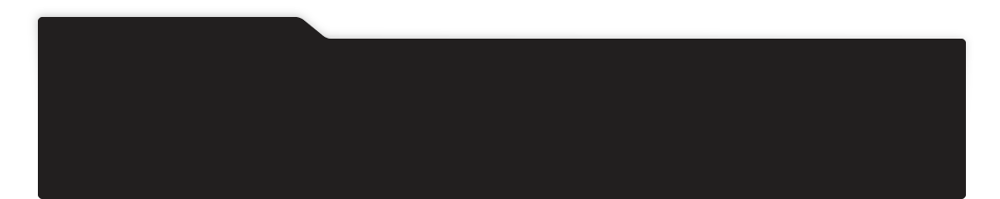
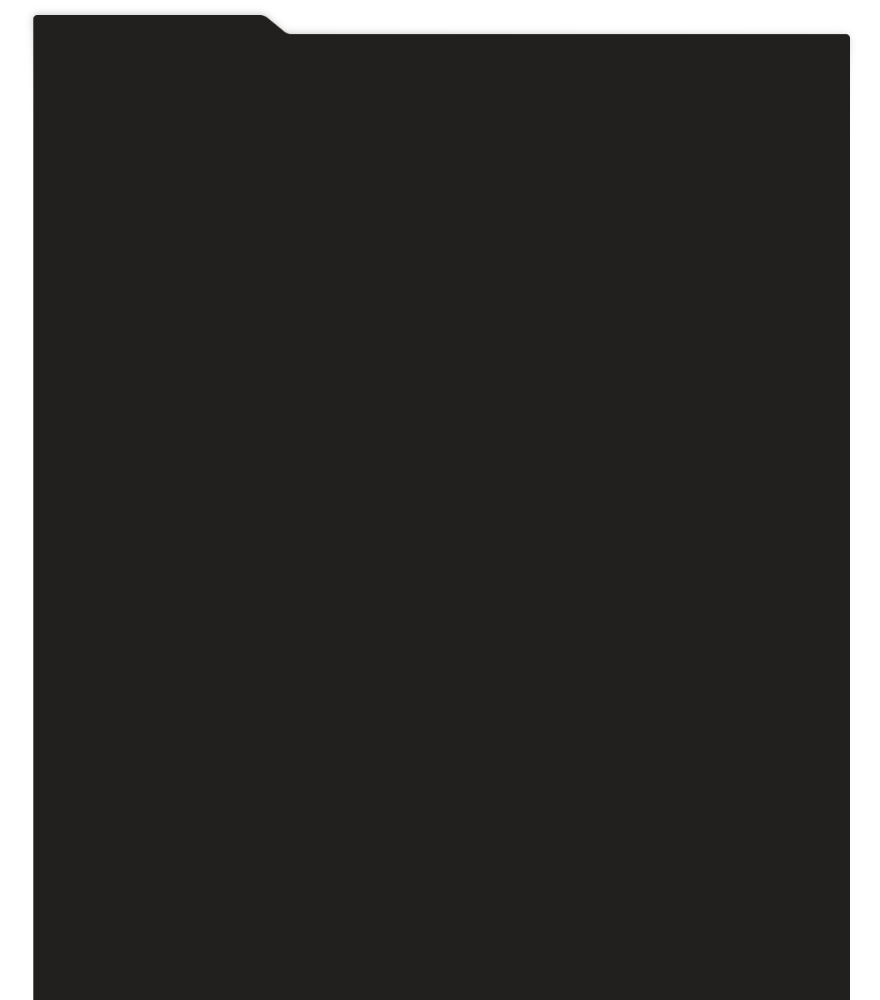
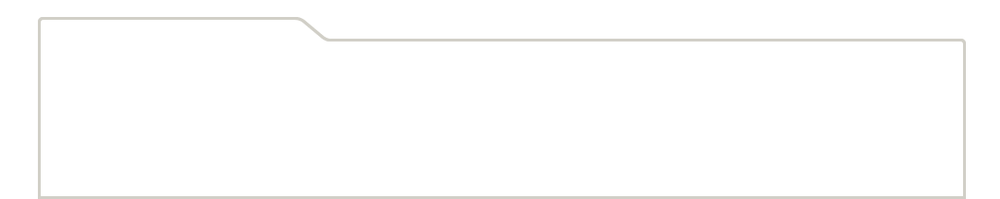
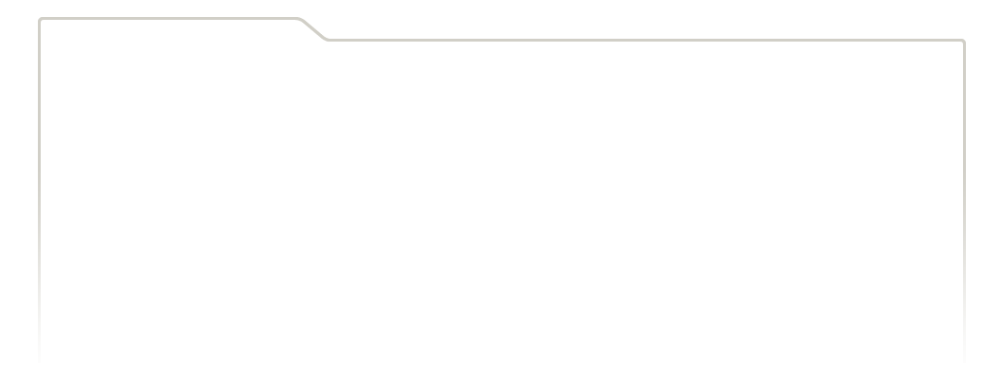
...
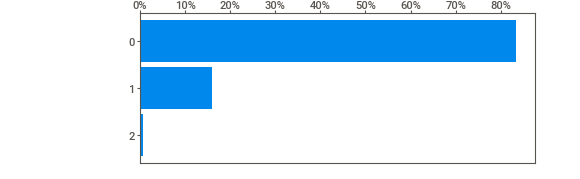
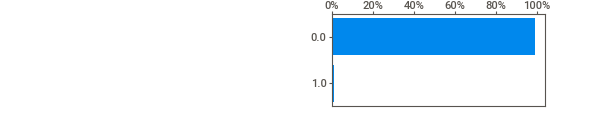
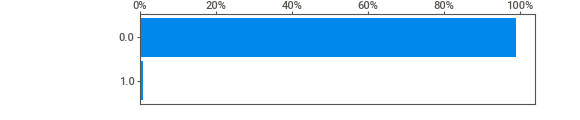
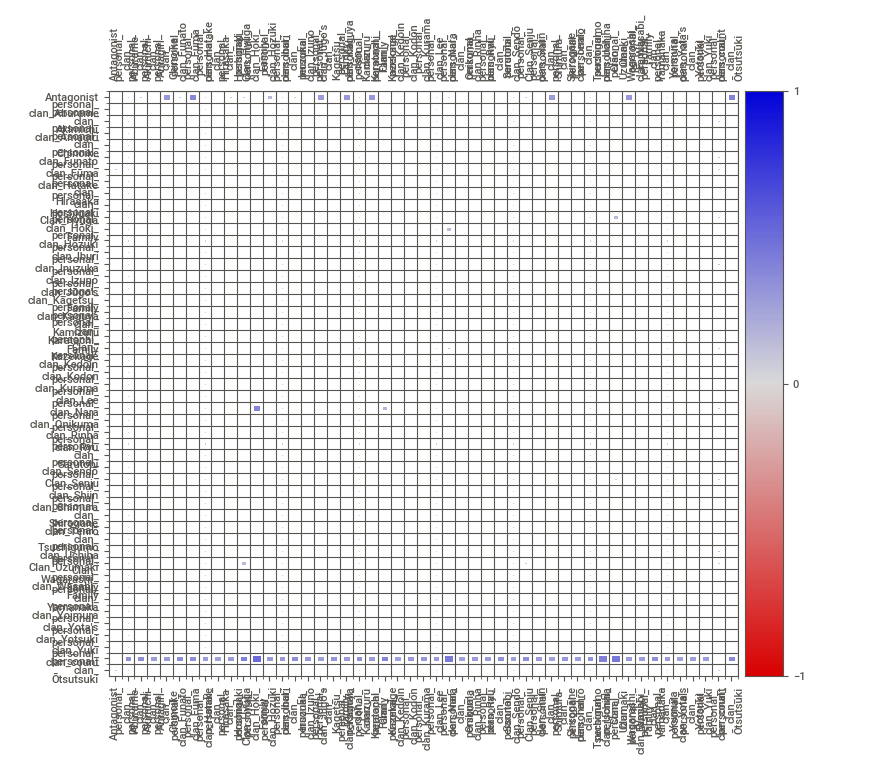
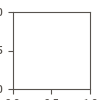

In [89]:
clanreport.show_notebook()

In [90]:
clanreduced = clan[['Antagonist','personal_clan_Ōtsutsuki','personal_clan_Fūma',
                    'personal_clan_count','personal_clan_Chinoike',
                    'personal_clan_Kaguya','personal_clan_Karatachi_Family',
                    'personal_Clan_Wagarashi_Family','personal_clan_Hōzuki',
                    '''personal_clan_Jūgo's''','personal_clan_Shimura',
                    'personal_Clan_Hyūga','personal_clan_Nara',
                    'personal_clan_Inuzuka','personal_clan_Aburame']]
clanreduced.sum().to_frame('Count').T

,Antagonist,personal_clan_Ōtsutsuki,personal_clan_Fūma,personal_clan_count,personal_clan_Chinoike,personal_clan_Kaguya,personal_clan_Karatachi_Family,personal_Clan_Wagarashi_Family,personal_clan_Hōzuki,personal_clan_Jūgo's,personal_clan_Shimura,personal_Clan_Hyūga,personal_clan_Nara,personal_clan_Inuzuka,personal_clan_Aburame
Count,185.0,13.0,10.0,245.0,2.0,2.0,2.0,2.0,3.0,1.0,1.0,14.0,13.0,12.0,8.0


In [91]:
crmatrix = clanreduced.corr()
crmatrix

,Antagonist,personal_clan_Ōtsutsuki,personal_clan_Fūma,personal_clan_count,personal_clan_Chinoike,personal_clan_Kaguya,personal_clan_Karatachi_Family,personal_Clan_Wagarashi_Family,personal_clan_Hōzuki,personal_clan_Jūgo's,personal_clan_Shimura,personal_Clan_Hyūga,personal_clan_Nara,personal_clan_Inuzuka,personal_clan_Aburame
Antagonist,1.000000,0.248489,0.217709,0.086914,0.097089,0.097089,0.097089,0.097089,0.073414,0.068629,0.068629,-0.038301,-0.036894,-0.035434,0.054913
personal_clan_Ōtsutsuki,0.248489,1.000000,-0.008032,0.202826,-0.003582,-0.003582,-0.003582,-0.003582,-0.004389,-0.002532,-0.002532,-0.009517,-0.009168,-0.008805,-0.007179
personal_clan_Fūma,0.217709,-0.008032,1.000000,0.177702,-0.003138,-0.003138,-0.003138,-0.003138,-0.003845,-0.002218,-0.002218,-0.008338,-0.008032,-0.007714,-0.006290
personal_clan_count,0.086914,0.202826,0.177702,1.000000,0.079248,0.079248,0.079248,0.079248,0.097093,0.056017,0.056017,0.264996,0.278126,0.194800,0.158830
personal_clan_Chinoike,0.097089,-0.003582,-0.003138,0.079248,1.000000,-0.001400,-0.001400,-0.001400,-0.001715,-0.000989,-0.000989,-0.003719,-0.003582,-0.003440,-0.002805
personal_clan_Kaguya,0.097089,-0.003582,-0.003138,0.079248,-0.001400,1.000000,-0.001400,-0.001400,-0.001715,-0.000989,-0.000989,-0.003719,-0.003582,-0.003440,-0.002805
personal_clan_Karatachi_Family,0.097089,-0.003582,-0.003138,0.079248,-0.001400,-0.001400,1.000000,-0.001400,-0.001715,-0.000989,-0.000989,-0.003719,-0.003582,-0.003440,-0.002805
personal_Clan_Wagarashi_Family,0.097089,-0.003582,-0.003138,0.079248,-0.001400,-0.001400,-0.001400,1.000000,-0.001715,-0.000989,-0.000989,-0.003719,-0.003582,-0.003440,-0.002805
personal_clan_Hōzuki,0.073414,-0.004389,-0.003845,0.097093,-0.001715,-0.001715,-0.001715,-0.001715,1.000000,-0.001212,-0.001212,-0.004556,-0.004389,-0.004215,-0.003437
personal_clan_Jūgo's,0.068629,-0.002532,-0.002218,0.056017,-0.000989,-0.000989,-0.000989,-0.000989,-0.001212,1.000000,-0.000699,-0.002629,-0.002532,-0.002432,-0.001983


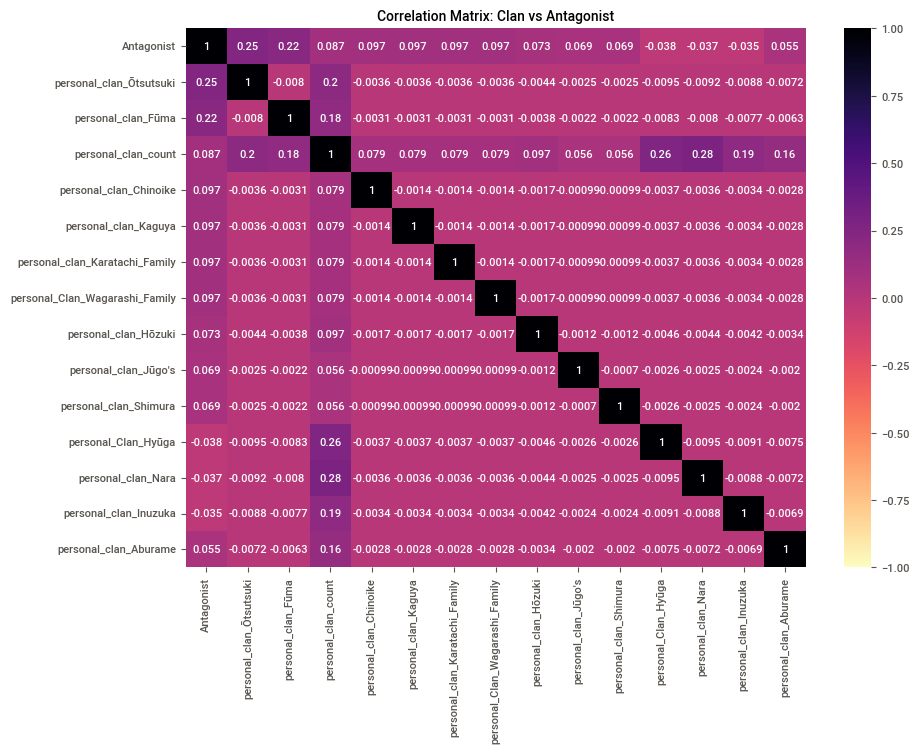

In [92]:
plt.figure(figsize=(10,7))

sns.heatmap(crmatrix, vmin = -1, vmax = 1, annot = True, annot_kws={'size': 8, 'color': 'white'}, cmap='magma_r')

plt.title('Correlation Matrix: Clan vs Antagonist', fontsize=10)

plt.show()

In [93]:
sorted(df.columns.tolist())

['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_count',
 'id',
 'images',
 'jutsu',
 'jutsu_count',
 'name',
 'natureType',
 'natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natu

In [94]:
df = df.rename(columns={'personal_classification_Puppet"Puppet"_is_not_in_the_list__of_allowed_values_for_the_"Classification"_property.'
                        :'personal_classification_Puppet'})

In [95]:
df= df.drop(['personal_classification'], axis = 1)

In [96]:
classification = df[['Antagonist','personal_classification_Cooking-nin',
 'personal_classification_Daimyō',
 'personal_classification_Hunter-nin',
 'personal_classification_Jinchūriki',
 'personal_classification_Medical-nin',
 'personal_classification_Mercenary_Ninja',
 'personal_classification_Missing-nin',
 'personal_classification_Ninja_monk',
 'personal_classification_Pseudo-Jinchūriki',
 'personal_classification_Puppet',
 'personal_classification_S-rank',
 'personal_classification_Sage',
 'personal_classification_Samurai',
 'personal_classification_Sannin',
 'personal_classification_Sensor_Type',
 'personal_classification_Summon',
 'personal_classification_Tailed_Beast',
 'personal_classification_count']]

In [97]:
classification.sum().to_frame('Count').T

,Antagonist,personal_classification_Cooking-nin,personal_classification_Daimyō,personal_classification_Hunter-nin,personal_classification_Jinchūriki,personal_classification_Medical-nin,personal_classification_Mercenary_Ninja,personal_classification_Missing-nin,personal_classification_Ninja_monk,personal_classification_Pseudo-Jinchūriki,personal_classification_Puppet,personal_classification_S-rank,personal_classification_Sage,personal_classification_Samurai,personal_classification_Sannin,personal_classification_Sensor_Type,personal_classification_Summon,personal_classification_Tailed_Beast,personal_classification_count
Count,185.0,1.0,27.0,2.0,21.0,60.0,15.0,80.0,7.0,8.0,1.0,13.0,20.0,11.0,3.0,54.0,66.0,10.0,119.0


In [98]:
classmatrix = classification.corr()
classmatrix

,Antagonist,personal_classification_Cooking-nin,personal_classification_Daimyō,personal_classification_Hunter-nin,personal_classification_Jinchūriki,personal_classification_Medical-nin,personal_classification_Mercenary_Ninja,personal_classification_Missing-nin,personal_classification_Ninja_monk,personal_classification_Pseudo-Jinchūriki,personal_classification_Puppet,personal_classification_S-rank,personal_classification_Sage,personal_classification_Samurai,personal_classification_Sannin,personal_classification_Sensor_Type,personal_classification_Summon,personal_classification_Tailed_Beast,personal_classification_count
Antagonist,1.000000,-0.010190,-0.038127,0.041337,0.039581,0.002527,0.042146,0.169152,-0.027016,0.082848,-0.010190,0.226536,0.096065,0.013782,0.027876,0.131369,-0.005288,-0.032324,0.177113
personal_classification_Cooking-nin,-0.010190,1.000000,-0.003667,-0.000989,-0.003227,-0.005532,-0.002722,-0.006435,-0.001854,-0.001983,-0.000699,-0.002532,-0.003148,-0.002327,-0.001212,-0.005237,-0.005815,-0.002218,-0.004843
personal_classification_Daimyō,-0.038127,-0.003667,1.000000,-0.005188,-0.016924,-0.029011,-0.014273,-0.011389,-0.009723,-0.010398,-0.003667,-0.013278,-0.016510,-0.012205,-0.006356,-0.000509,-0.030493,-0.011633,0.008536
personal_classification_Hunter-nin,0.041337,-0.000989,-0.005188,1.000000,-0.004566,-0.007826,-0.003850,-0.009104,-0.002623,-0.002805,-0.000989,-0.003582,-0.004454,-0.003293,-0.001715,0.090754,-0.008226,-0.003138,0.075531
personal_classification_Jinchūriki,0.039581,-0.003227,-0.016924,-0.004566,1.000000,0.003465,-0.012561,0.071486,-0.008556,0.146734,-0.003227,0.172067,0.183487,-0.010741,-0.005594,0.341796,-0.026835,-0.010238,0.476740
personal_classification_Medical-nin,0.002527,-0.005532,-0.029011,-0.007826,0.003465,1.000000,-0.021531,-0.005377,-0.014667,-0.015686,-0.005532,-0.020030,0.034495,-0.018412,0.066640,0.031761,-0.046000,-0.017549,0.115248
personal_classification_Mercenary_Ninja,0.042146,-0.002722,-0.014273,-0.003850,-0.012561,-0.021531,1.000000,0.303490,-0.007216,-0.007717,-0.002722,0.062464,-0.012254,-0.009059,-0.004717,-0.020382,-0.022632,-0.008634,0.328675
personal_classification_Missing-nin,0.169152,-0.006435,-0.011389,-0.009104,0.071486,-0.005377,0.303490,1.000000,-0.017061,0.022551,-0.006435,0.265236,0.022851,-0.021418,0.055350,0.031624,-0.053509,-0.020414,0.370729
personal_classification_Ninja_monk,-0.027016,-0.001854,-0.009723,-0.002623,-0.008556,-0.014667,-0.007216,-0.017061,1.000000,0.129078,-0.001854,-0.006713,-0.008347,-0.006171,-0.003214,-0.013884,-0.015417,-0.005882,0.031273
personal_classification_Pseudo-Jinchūriki,0.082848,-0.001983,-0.010398,-0.002805,0.146734,-0.015686,-0.007717,0.022551,0.129078,1.000000,-0.001983,0.091604,-0.008927,-0.006599,-0.003437,0.083521,-0.016487,-0.006290,0.192658


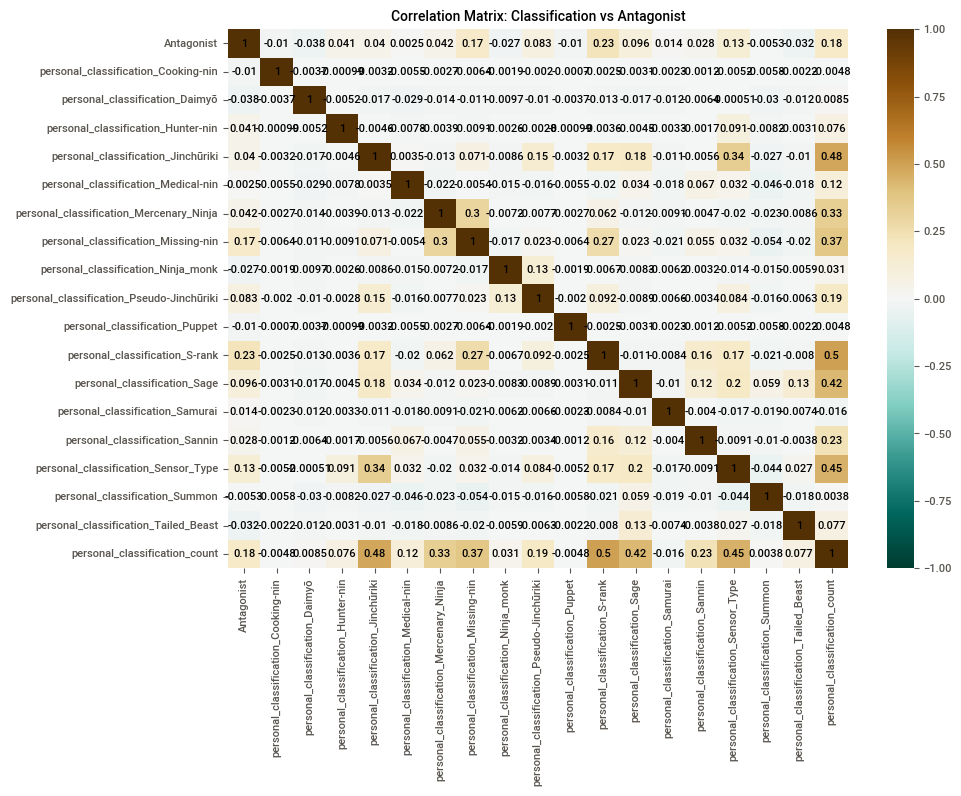

In [99]:
plt.figure(figsize=(10,7))

sns.heatmap(classmatrix, vmin = -1, vmax = 1, annot = True, annot_kws={'size': 8, 'color': 'black'}, cmap='BrBG_r')

plt.title('Correlation Matrix: Classification vs Antagonist', fontsize=10)

plt.show()

In [100]:
classreport = sv.analyze(classification)

                                             |                                             | [  0%]   00:00 ->…


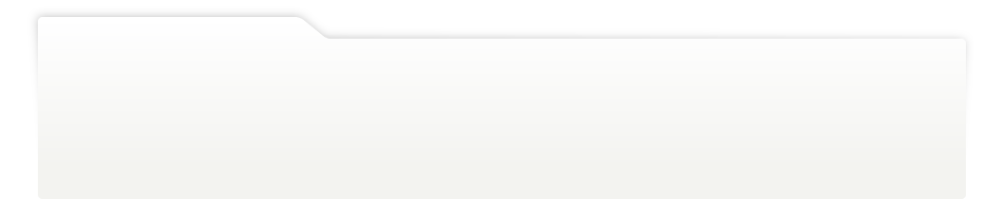
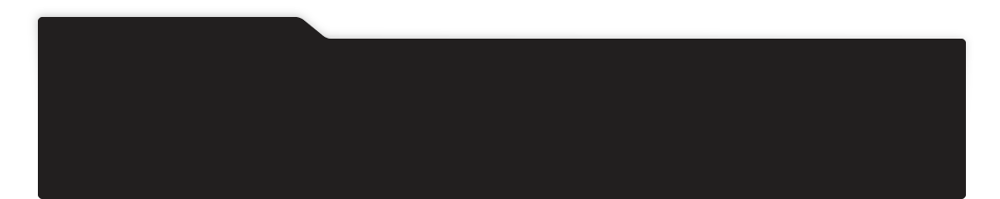
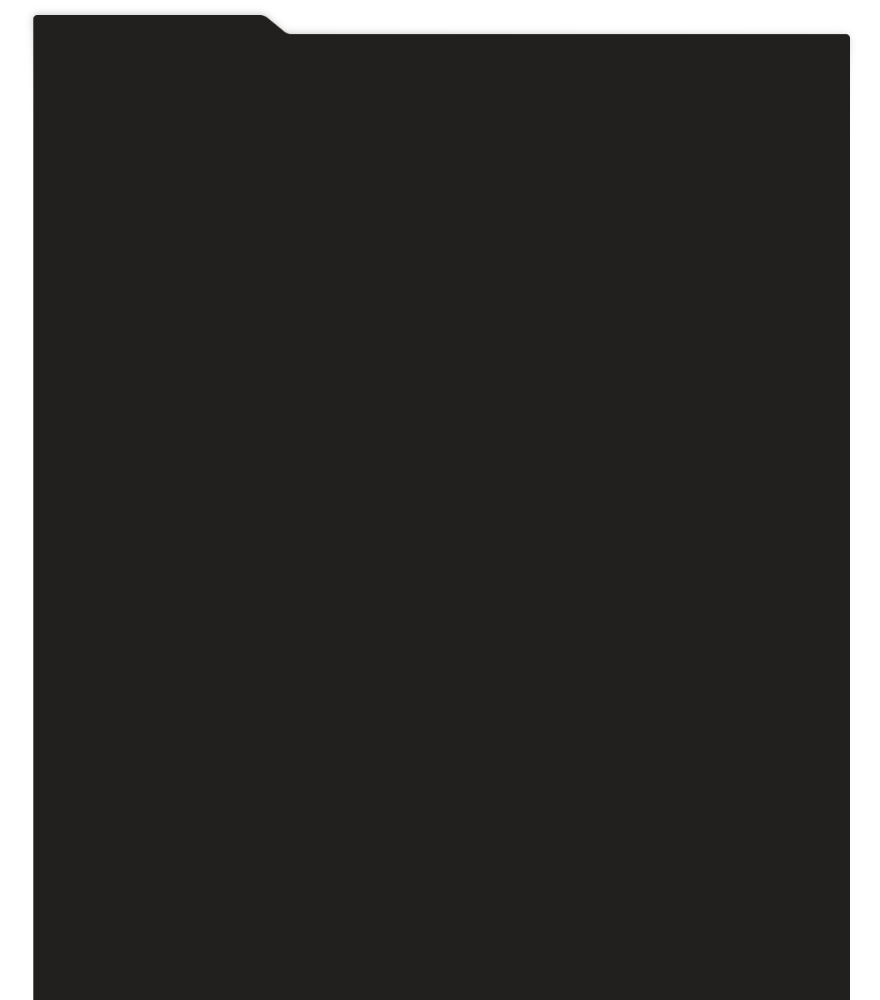
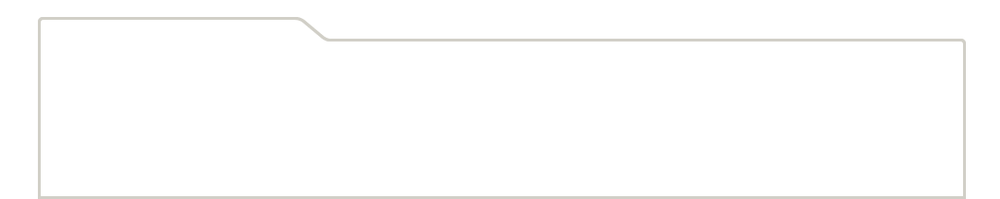
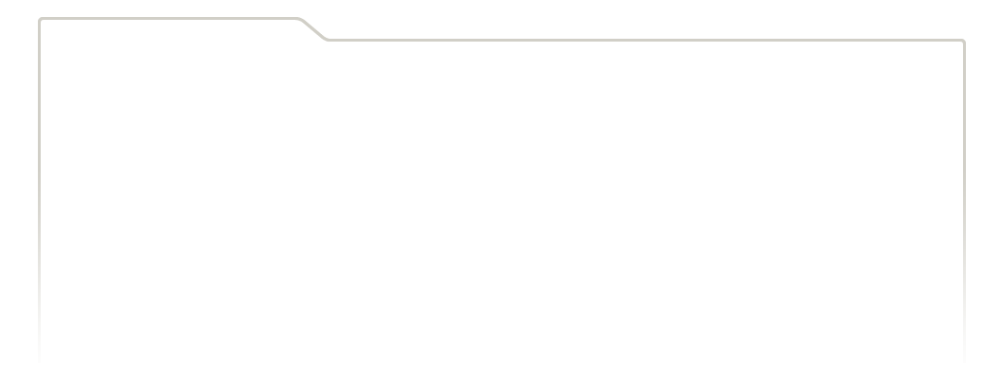
...
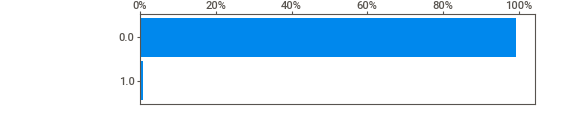
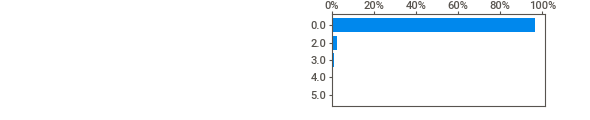
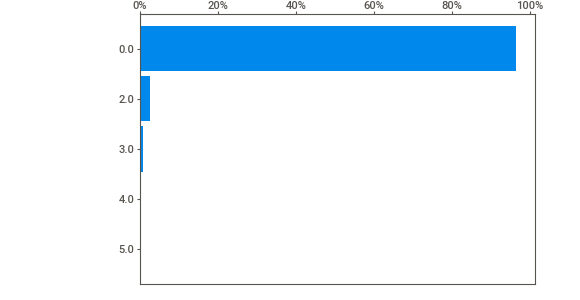
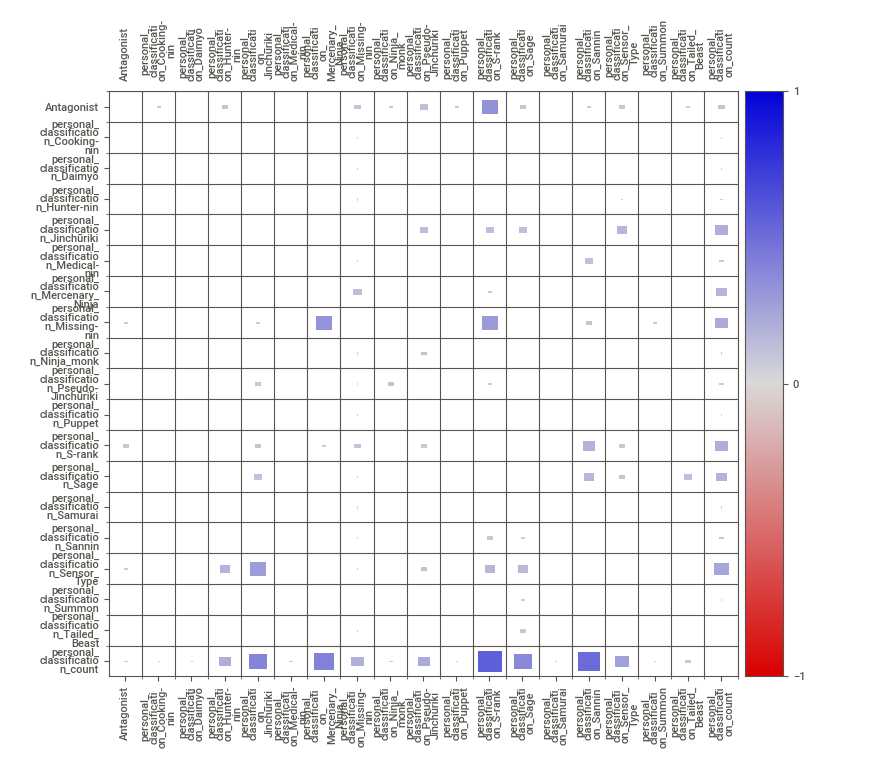
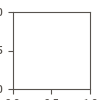

In [101]:
classreport.show_notebook()

In [102]:
df = df.drop(['personal_kekkeiGenkai',], axis = 1)

In [103]:
kekkei = df[['Antagonist','personal_kekkeiGenkai_Boil_Release',
 'personal_kekkeiGenkai_Byakugan',
 'personal_kekkeiGenkai_Crystal_Release',
 'personal_kekkeiGenkai_Dark_Release',
 'personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan',
 'personal_kekkeiGenkai_Explosion_Release',
 "personal_kekkeiGenkai_Iburi_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Ice_Release',
 "personal_kekkeiGenkai_Isshiki's_Dōjutsu",
 'personal_kekkeiGenkai_Jōgan',
 "personal_kekkeiGenkai_Jūgo's_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Ketsuryūgan',
 "personal_kekkeiGenkai_Kurama_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Lava_Release',
 'personal_kekkeiGenkai_Magnet_Release',
 'personal_kekkeiGenkai_Mangekyō_Sharingan',
 'personal_kekkeiGenkai_Mud_Release',
 "personal_kekkeiGenkai_Ranmaru's_Kekkei_Genkai",
 "personal_kekkeiGenkai_Rinha_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Rinnegan',
 "personal_kekkeiGenkai_Ryūzetsu's_Kekkei_Genkai",
 "personal_kekkeiGenkai_Sakon_and_Ukon's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Scorch_Release',
 'personal_kekkeiGenkai_Senrigan',
 'personal_kekkeiGenkai_Sharingan',
 'personal_kekkeiGenkai_Shikotsumyaku',
 'personal_kekkeiGenkai_Steel_Release',
 'personal_kekkeiGenkai_Storm_Release',
 'personal_kekkeiGenkai_Swift_Release',
 'personal_kekkeiGenkai_Tenseigan',
 'personal_kekkeiGenkai_Typhoon_Release',
 'personal_kekkeiGenkai_Wood_Release',
 'personal_kekkeiGenkai_count']]

In [104]:
kmatrix = kekkei.corr()
kmatrix

,Antagonist,personal_kekkeiGenkai_Boil_Release,personal_kekkeiGenkai_Byakugan,personal_kekkeiGenkai_Crystal_Release,personal_kekkeiGenkai_Dark_Release,personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan,personal_kekkeiGenkai_Explosion_Release,personal_kekkeiGenkai_Iburi_Clan's_Kekkei_Genkai,personal_kekkeiGenkai_Ice_Release,personal_kekkeiGenkai_Isshiki's_Dōjutsu,...,personal_kekkeiGenkai_Senrigan,personal_kekkeiGenkai_Sharingan,personal_kekkeiGenkai_Shikotsumyaku,personal_kekkeiGenkai_Steel_Release,personal_kekkeiGenkai_Storm_Release,personal_kekkeiGenkai_Swift_Release,personal_kekkeiGenkai_Tenseigan,personal_kekkeiGenkai_Typhoon_Release,personal_kekkeiGenkai_Wood_Release,personal_kekkeiGenkai_count
Antagonist,1.000000,-0.022817,0.091544,0.068629,-0.010190,0.097089,0.027876,-0.017661,0.007231,0.097089,...,0.097089,0.084341,0.118951,-0.014415,0.027876,-0.010190,0.068629,-0.010190,0.164852,0.220661
personal_kekkeiGenkai_Boil_Release,-0.022817,1.000000,-0.007226,-0.001566,-0.001566,-0.002215,-0.002714,-0.002714,-0.003842,-0.002215,...,-0.002215,-0.008212,-0.002714,-0.002215,-0.002714,-0.001566,-0.001566,-0.001566,-0.006095,0.200641
personal_kekkeiGenkai_Byakugan,0.091544,-0.007226,1.000000,-0.003227,-0.003227,-0.004566,-0.005594,-0.005594,-0.007919,0.150991,...,0.150991,-0.016924,-0.005594,-0.004566,-0.005594,-0.003227,0.216687,-0.003227,0.044501,0.339491
personal_kekkeiGenkai_Crystal_Release,0.068629,-0.001566,-0.003227,1.000000,-0.000699,-0.000989,-0.001212,-0.001212,-0.001716,-0.000989,...,-0.000989,-0.003667,-0.001212,-0.000989,-0.001212,-0.000699,-0.000699,-0.000699,-0.002722,0.053512
personal_kekkeiGenkai_Dark_Release,-0.010190,-0.001566,-0.003227,-0.000699,1.000000,-0.000989,-0.001212,-0.001212,-0.001716,-0.000989,...,-0.000989,-0.003667,-0.001212,0.706859,0.576946,1.000000,-0.000699,-0.000699,-0.002722,0.233972
personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan,0.097089,-0.002215,-0.004566,-0.000989,-0.000989,1.000000,-0.001715,-0.001715,-0.002428,-0.001400,...,-0.001400,0.269774,-0.001715,-0.001400,0.407248,-0.000989,-0.000989,-0.000989,0.179817,0.331003
personal_kekkeiGenkai_Explosion_Release,0.027876,-0.002714,-0.005594,-0.001212,-0.001212,-0.001715,1.000000,-0.002101,-0.002974,-0.001715,...,-0.001715,-0.006356,-0.002101,-0.001715,-0.002101,-0.001212,-0.001212,-0.001212,-0.004717,0.092750
personal_kekkeiGenkai_Iburi_Clan's_Kekkei_Genkai,-0.017661,-0.002714,-0.005594,-0.001212,-0.001212,-0.001715,-0.002101,1.000000,-0.002974,-0.001715,...,-0.001715,-0.006356,-0.002101,-0.001715,-0.002101,-0.001212,-0.001212,-0.001212,-0.004717,0.092750
personal_kekkeiGenkai_Ice_Release,0.007231,-0.003842,-0.007919,-0.001716,-0.001716,-0.002428,-0.002974,-0.002974,1.000000,-0.002428,...,-0.002428,-0.008998,-0.002974,-0.002428,-0.002974,-0.001716,-0.001716,-0.001716,-0.006679,0.131306
personal_kekkeiGenkai_Isshiki's_Dōjutsu,0.097089,-0.002215,0.150991,-0.000989,-0.000989,-0.001400,-0.001715,-0.001715,-0.002428,1.000000,...,-0.001400,-0.005188,-0.001715,-0.001400,-0.001715,-0.000989,-0.000989,-0.000989,-0.003850,0.118254


In [105]:
kreport = sv.analyze(kekkei)

                                             |                                             | [  0%]   00:00 ->…


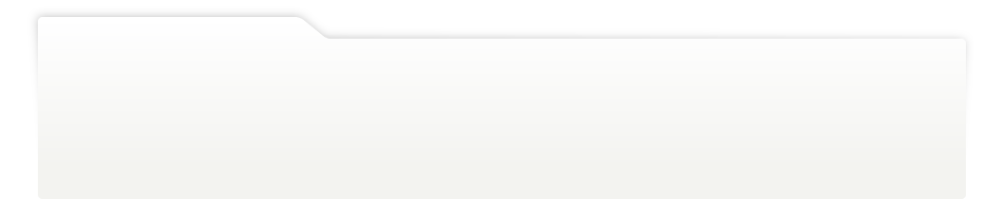
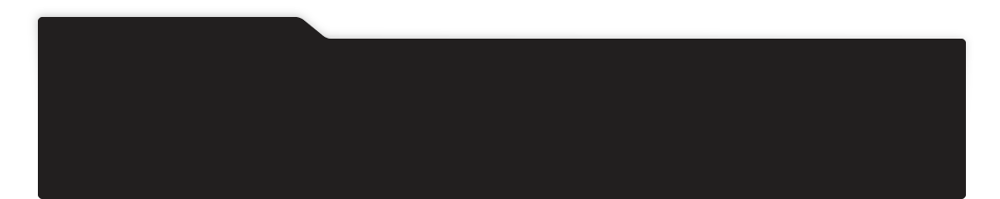
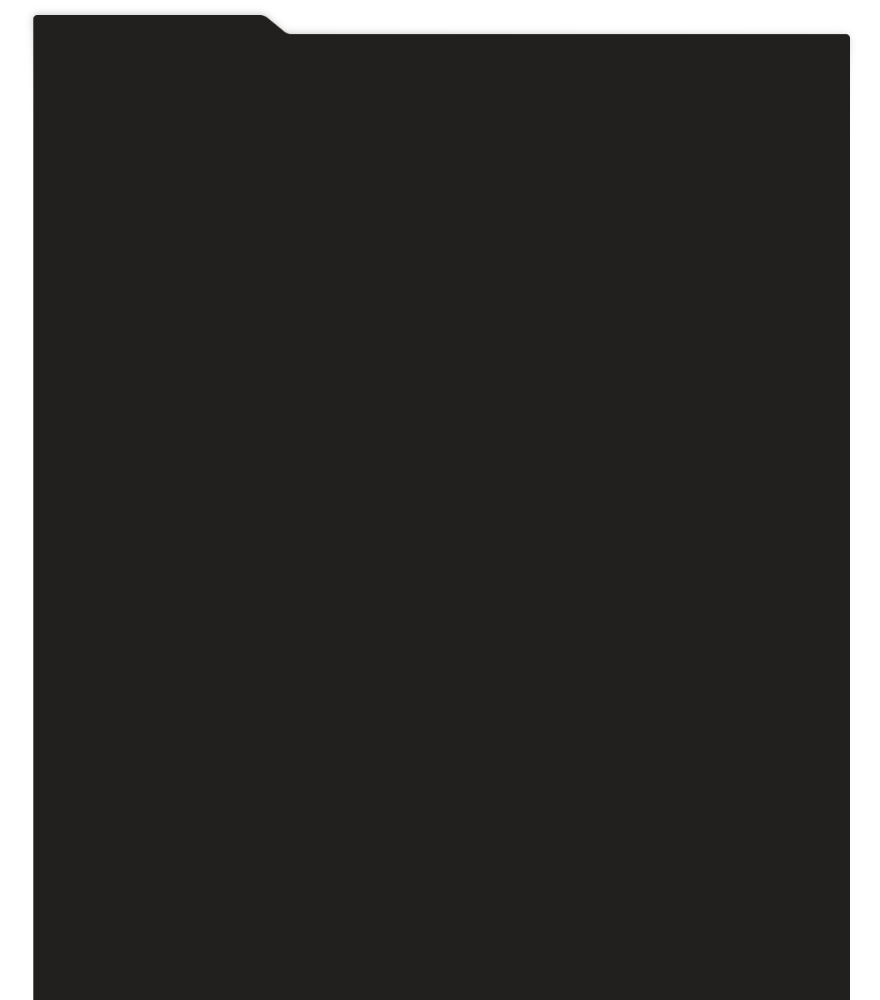
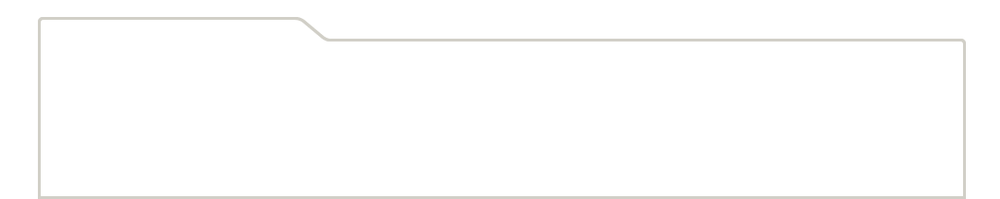
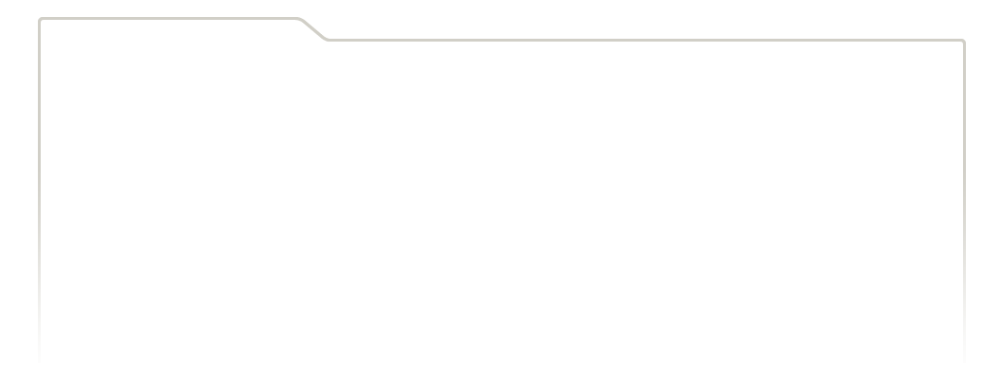
...
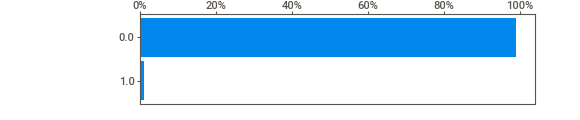
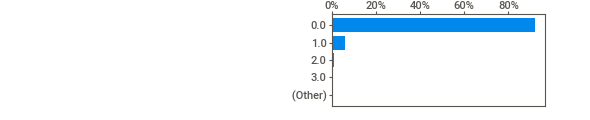
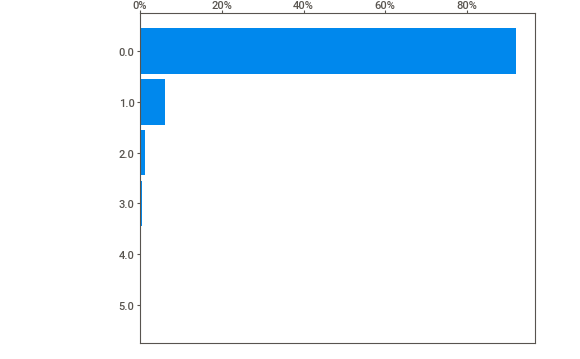
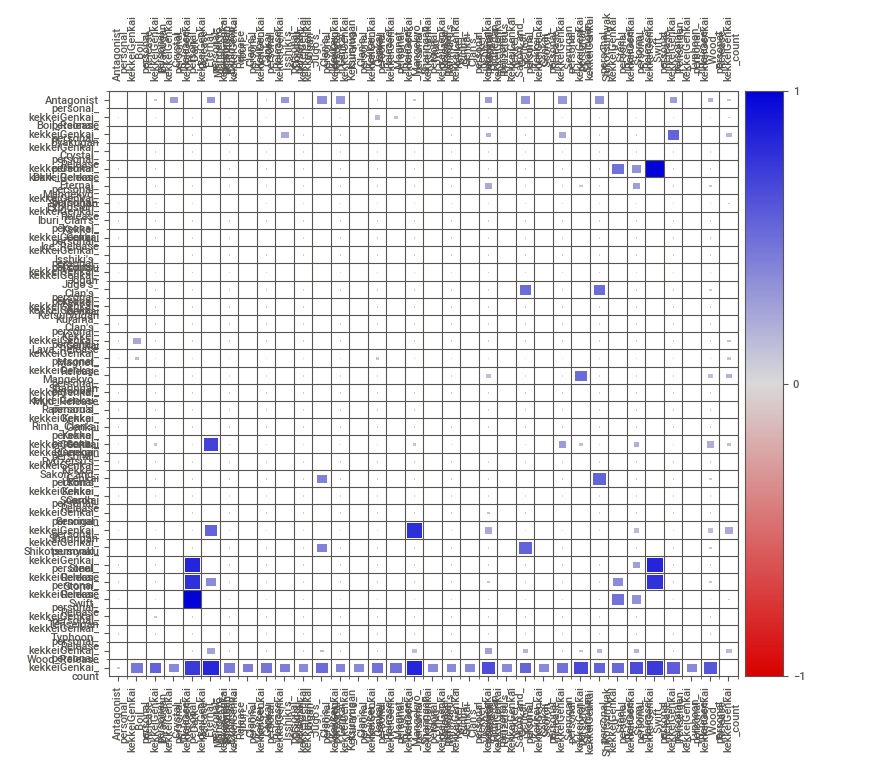
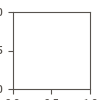

In [106]:
kreport.show_notebook()

In [107]:
kekkeireduced = df[['Antagonist','personal_kekkeiGenkai_count','personal_kekkeiGenkai_Rinnegan',
                 'personal_kekkeiGenkai_Wood_Release','''personal_kekkeiGenkai_Jūgo's_Clan's_Kekkei_Genkai''',
                  '''personal_kekkeiGenkai_Sakon_and_Ukon's_Kekkei_Genkai''','personal_kekkeiGenkai_Shikotsumyaku',
                  'personal_kekkeiGenkai_Mangekyō_Sharingan','personal_kekkeiGenkai_Byakugan',
                  'personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan',
                  '''personal_kekkeiGenkai_Isshiki's_Dōjutsu''','personal_kekkeiGenkai_Ketsuryūgan',
                  'personal_kekkeiGenkai_Senrigan', 'personal_kekkeiGenkai_Sharingan','personal_kekkeiGenkai_Crystal_Release']]

In [108]:
krmatrix = kekkeireduced.corr()
krmatrix

,Antagonist,personal_kekkeiGenkai_count,personal_kekkeiGenkai_Rinnegan,personal_kekkeiGenkai_Wood_Release,personal_kekkeiGenkai_Jūgo's_Clan's_Kekkei_Genkai,personal_kekkeiGenkai_Sakon_and_Ukon's_Kekkei_Genkai,personal_kekkeiGenkai_Shikotsumyaku,personal_kekkeiGenkai_Mangekyō_Sharingan,personal_kekkeiGenkai_Byakugan,personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan,personal_kekkeiGenkai_Isshiki's_Dōjutsu,personal_kekkeiGenkai_Ketsuryūgan,personal_kekkeiGenkai_Senrigan,personal_kekkeiGenkai_Sharingan,personal_kekkeiGenkai_Crystal_Release
Antagonist,1.000000,0.220661,0.180118,0.164852,0.137401,0.118951,0.118951,0.103499,0.091544,0.097089,0.097089,0.097089,0.097089,0.084341,0.068629
personal_kekkeiGenkai_count,0.220661,1.000000,0.502814,0.473611,0.257678,0.266520,0.266520,0.520436,0.339491,0.331003,0.118254,0.075704,0.160803,0.584383,0.053512
personal_kekkeiGenkai_Rinnegan,0.180118,0.502814,1.000000,0.338989,-0.004212,-0.003646,-0.003646,0.165401,0.210823,0.470249,-0.002976,-0.002976,0.233636,0.248842,-0.002104
personal_kekkeiGenkai_Wood_Release,0.164852,0.473611,0.338989,1.000000,0.124514,0.145299,0.145299,0.191525,0.044501,0.179817,-0.003850,-0.003850,-0.003850,0.187451,-0.002722
personal_kekkeiGenkai_Jūgo's_Clan's_Kekkei_Genkai,0.137401,0.257678,-0.004212,0.124514,1.000000,0.576339,0.576339,-0.005449,-0.006461,-0.001981,-0.001981,-0.001981,-0.001981,-0.007342,-0.001400
personal_kekkeiGenkai_Sakon_and_Ukon's_Kekkei_Genkai,0.118951,0.266520,-0.003646,0.145299,0.576339,1.000000,0.665966,-0.004717,-0.005594,-0.001715,-0.001715,-0.001715,-0.001715,-0.006356,-0.001212
personal_kekkeiGenkai_Shikotsumyaku,0.118951,0.266520,-0.003646,0.145299,0.576339,0.665966,1.000000,-0.004717,-0.005594,-0.001715,-0.001715,-0.001715,-0.001715,-0.006356,-0.001212
personal_kekkeiGenkai_Mangekyō_Sharingan,0.103499,0.520436,0.165401,0.191525,-0.005449,-0.004717,-0.004717,1.000000,-0.012561,-0.003850,-0.003850,-0.003850,-0.003850,0.742191,-0.002722
personal_kekkeiGenkai_Byakugan,0.091544,0.339491,0.210823,0.044501,-0.006461,-0.005594,-0.005594,-0.012561,1.000000,-0.004566,0.150991,-0.004566,0.150991,-0.016924,-0.003227
personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan,0.097089,0.331003,0.470249,0.179817,-0.001981,-0.001715,-0.001715,-0.003850,-0.004566,1.000000,-0.001400,-0.001400,-0.001400,0.269774,-0.000989


In [109]:
kekkeireduced.sum().to_frame('Count').T

,Antagonist,personal_kekkeiGenkai_count,personal_kekkeiGenkai_Rinnegan,personal_kekkeiGenkai_Wood_Release,personal_kekkeiGenkai_Jūgo's_Clan's_Kekkei_Genkai,personal_kekkeiGenkai_Sakon_and_Ukon's_Kekkei_Genkai,personal_kekkeiGenkai_Shikotsumyaku,personal_kekkeiGenkai_Mangekyō_Sharingan,personal_kekkeiGenkai_Byakugan,personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan,personal_kekkeiGenkai_Isshiki's_Dōjutsu,personal_kekkeiGenkai_Ketsuryūgan,personal_kekkeiGenkai_Senrigan,personal_kekkeiGenkai_Sharingan,personal_kekkeiGenkai_Crystal_Release
Count,185.0,158.0,9.0,15.0,4.0,3.0,3.0,15.0,21.0,2.0,2.0,2.0,2.0,27.0,1.0


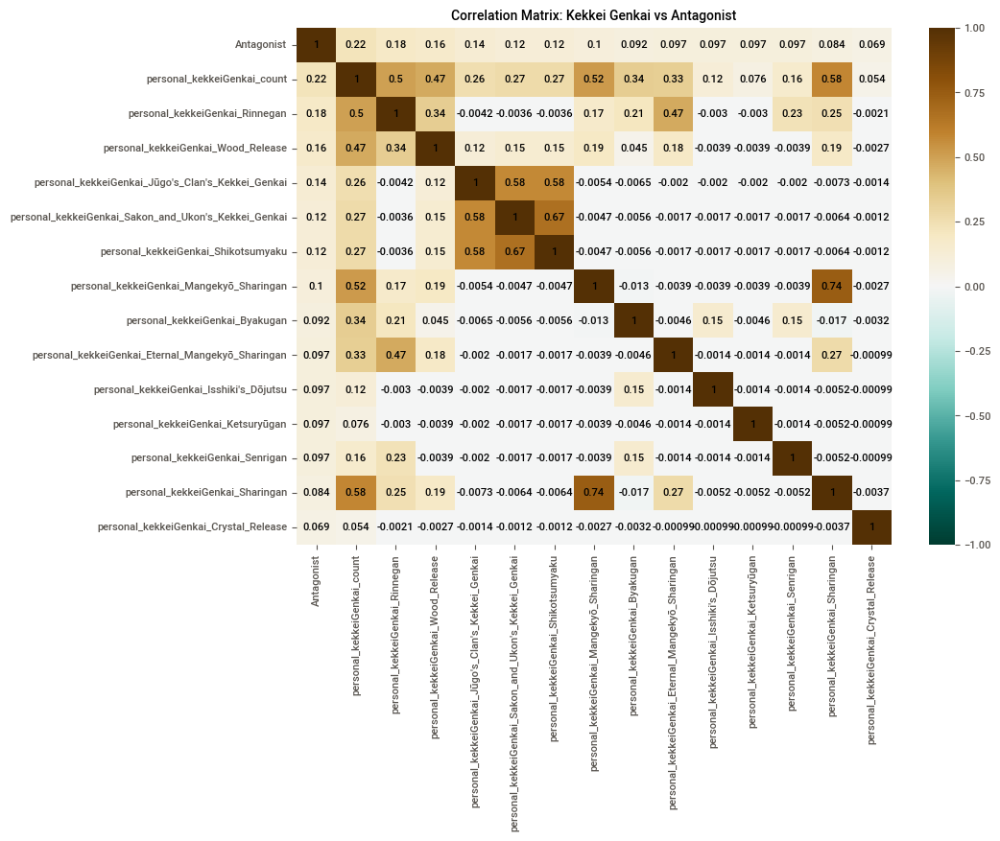

In [110]:
plt.figure(figsize=(10,7))

sns.heatmap(krmatrix, vmin = -1, vmax = 1, annot = True, annot_kws={'size': 8, 'color': 'black'}, cmap='BrBG_r')

plt.title('Correlation Matrix: Kekkei Genkai vs Antagonist', fontsize=10)

plt.show()

In [111]:
kekkei =df[['personal_kekkeiGenkai_Boil_Release',
 'personal_kekkeiGenkai_Byakugan',
 'personal_kekkeiGenkai_Crystal_Release',
 'personal_kekkeiGenkai_Dark_Release',
 'personal_kekkeiGenkai_Eternal_Mangekyō_Sharingan',
 'personal_kekkeiGenkai_Explosion_Release',
 "personal_kekkeiGenkai_Iburi_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Ice_Release',
 "personal_kekkeiGenkai_Isshiki's_Dōjutsu",
 'personal_kekkeiGenkai_Jōgan',
 "personal_kekkeiGenkai_Jūgo's_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Ketsuryūgan',
 "personal_kekkeiGenkai_Kurama_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Lava_Release',
 'personal_kekkeiGenkai_Magnet_Release',
 'personal_kekkeiGenkai_Mangekyō_Sharingan',
 'personal_kekkeiGenkai_Mud_Release',
 "personal_kekkeiGenkai_Ranmaru's_Kekkei_Genkai",
 "personal_kekkeiGenkai_Rinha_Clan's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Rinnegan',
 "personal_kekkeiGenkai_Ryūzetsu's_Kekkei_Genkai",
 "personal_kekkeiGenkai_Sakon_and_Ukon's_Kekkei_Genkai",
 'personal_kekkeiGenkai_Scorch_Release',
 'personal_kekkeiGenkai_Senrigan',
 'personal_kekkeiGenkai_Sharingan',
 'personal_kekkeiGenkai_Shikotsumyaku',
 'personal_kekkeiGenkai_Steel_Release',
 'personal_kekkeiGenkai_Storm_Release',
 'personal_kekkeiGenkai_Swift_Release',
 'personal_kekkeiGenkai_Tenseigan',
 'personal_kekkeiGenkai_Typhoon_Release',
 'personal_kekkeiGenkai_Wood_Release']]

In [112]:
kekkeimap = {'personal_HasKekkei': kekkei}

In [113]:
# Add new categorical columns to main DataFrame if they have Kekkei Genkai
for category, columns in kekkeimap.items():
    valid_cols = [col for col in columns if col in kekkei.columns]
    df[category] = kekkei[valid_cols].max(axis=1) if valid_cols else 0
# Drop duplicates columns    
df = df.drop(columns=kekkei.columns.tolist())
df

,id,name,Antagonist,debut_manga,debut_anime,debut_novel,debut_movie,debut_game,debut_ova,debut_appearsIn,...,Daughter,Spouse/Partner,Extended_Family,Misc.,personal_Clan_Hyūga,personal_Clan_Kazekage,personal_Clan_Senju,personal_Clan_Uzumaki,personal_Clan_Wagarashi_Family,personal_HasKekkei
0,1344,Naruto Uzumaki,0,Naruto Chapter #1,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,1,1,0,0,0.0,0.0,0.0,1.0,0.0,1.0
1,1307,Sasuke Uchiha,1,Naruto Chapter #3,Naruto Episode #1,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,1,1,0,0,0.0,0.0,0.0,0.0,0.0,1.0
2,1299,Madara Uchiha,1,Naruto Chapter #370,Naruto Shippūden Episode #130,Kakashi Hiden: Lightning in the Icy Sky,The Last: Naruto the Movie,Naruto Shippūden: Ultimate Ninja Storm 2,Naruto Shippūden: UNSG anime cutscenes,"Anime, Manga, Novel, Game, Movie",...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
3,376,Kakashi Hatake,1,Naruto Chapter #3,Naruto Episode #3,"Naruto: Innocent Heart, Demonic Blood",Naruto the Movie: Ninja Clash in the Land of Snow,Naruto: Konoha Ninpōchō,Find the Four-Leaf Red Clover!,"Anime, Manga, Novel, Game, Movie",...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
4,928,Orochimaru,1,Naruto Chapter #45,Naruto Episode #27,Sasuke Shinden: Book of Sunrise,Naruto Shippūden the Movie: Bonds,Naruto: Ninja Council,Hidden Leaf Village Grand Sports Festival!,"Anime, Manga, Novel, Game, Movie",...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1290,Hazuki Uchiha,0,0,0,0,0,0,0,0,...,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1427,1298,Kagen Uchiha,0,0,0,0,0,0,0,0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1428,1422,Zenigoke,0,0,0,0,0,Naruto: The Broken Bond,0,Game,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1429,1424,Zetsu,0,0,0,0,0,0,0,0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [114]:
df = df.drop(['personal_team',], axis = 1)

In [115]:
team = df[['Antagonist','personal_team_count',
 'personal_team_Akagi_Gang',
 'personal_team_Allied_Mothers_Force',
 'personal_team_Ame_Orphans',
 'personal_team_Analysis_Team',
 'personal_team_A–B_Combo',
 'personal_team_Bikōchū_Search_Team',
 'personal_team_Byakuya_Gang',
 'personal_team_Communications_Team',
 'personal_team_Counter-Terrorism_Division',
 'personal_team_Cypher_Division',
 'personal_team_Daimyō_Protection_Squad',
 'personal_team_Dark_Thunder_Group',
 'personal_team_Demon_Brothers',
 "personal_team_Dotō's_Three-Man-Team",
 'personal_team_Eight-Tails_Subduing_Team',
 'personal_team_Eight_Man_Squad',
 'personal_team_Enlightened_Ones',
 'personal_team_Escort_Unit',
 'personal_team_Exploding-Till-You-Eat',
 'personal_team_Explosion_Corps',
 'personal_team_Fabrications',
 'personal_team_Fifth_Division',
 'personal_team_First_Division',
 "personal_team_Five_Great_Countries'_Joint_Investigation_Team",
 'personal_team_Four_Celestial_Symbols_Men',
 'personal_team_Four_Ninja_Animal_Warriors',
 'personal_team_Fourth_Division',
 'personal_team_Fruit_Group',
 "personal_team_Furido's_4-Man_Team",
 'personal_team_Gang_of_Four',
 'personal_team_Garakuta_Gang',
 'personal_team_Gatō_Company',
 'personal_team_Genbu_Shinobi_Trio',
 'personal_team_Ghost_Army',
 'personal_team_Gold_and_Silver_Brothers',
 'personal_team_Grass_Flower_Group',
 "personal_team_Haido's_Knights",
 'personal_team_Hanabi_Rescue_Team',
 'personal_team_Haze_Quadruplets',
 "personal_team_Hiruko's_Team",
 'personal_team_Hokage_Guard_Platoon',
 'personal_team_Honoured_Siblings',
 'personal_team_Impure_World_Reincarnation_Allied_Forces',
 'personal_team_Infiltration_and_Reconnaissance_Party',
 'personal_team_Ino–Saku–Sai',
 'personal_team_Ino–Shika–Chō',
 'personal_team_Intelligence_Division',
 'personal_team_Ishi_Terrorists',
 "personal_team_Jako's_Gang",
 'personal_team_Janin',
 'personal_team_Kaima_Capture_Team',
 'personal_team_Kanabun_Gang',
 'personal_team_Kazekage_Rescue_Team',
 'personal_team_Kinkaku_Force',
 'personal_team_Konoha_11',
 'personal_team_Konoha_Barrier_Team',
 'personal_team_Konoha_Council',
 'personal_team_Konoha_Cryptanalysis_Team',
 'personal_team_Konoha_Military_Police_Force',
 'personal_team_Konoha_Special_Mission_Platoon',
 'personal_team_Konoha_Torture_and_Interrogation_Force',
 'personal_team_Kumo_Barrier_Team',
 'personal_team_Kumo_Council',
 'personal_team_Kumo_Spectators',
 'personal_team_Kurosuki_Family',
 "personal_team_Leaf's_Anbu",
 'personal_team_Legendary_Stupid_Brothers',
 'personal_team_Lightning_Group',
 'personal_team_Logistical_Support_and_Medical_Division',
 'personal_team_Magaki_Group',
 'personal_team_Medic_Corps',
 'personal_team_Mezu_Gang',
 'personal_team_Mokuzu_Gang',
 'personal_team_Moya_Triad',
 'personal_team_Mujina_Bandits',
 'personal_team_New_Seven_Ninja_Swordsmen',
 'personal_team_Nokizaru_Group',
 'personal_team_Orochimaru_Search_Team',
 'personal_team_Peddlers_Escort_Team',
 'personal_team_Prajñā_Group',
 'personal_team_Puppet_Brigade',
 'personal_team_Ryūha_Armament_Alliance',
 'personal_team_Sasuke_Recovery_Team',
 'personal_team_Scientific_Ninja_Weapons_Team',
 'personal_team_Sea_Route_of_Silence_Gang',
 'personal_team_Sealing_Team',
 'personal_team_Second_Division',
 'personal_team_Sensor_Division',
 'personal_team_Seven_Ninja_Swordsmen_of_the_Mist',
 'personal_team_Shin_Uchiha',
 'personal_team_Shinobazu',
 'personal_team_Shirogane_Three',
 'personal_team_Sound_Five',
 'personal_team_Sound_Four',
 'personal_team_Star_Guard_Team',
 'personal_team_Suicide_Corps',
 'personal_team_Sumo_Wrestlers',
 'personal_team_Suna_Council',
 'personal_team_Surprise_Attack_Division',
 'personal_team_Surprise_Attack_and_Diversion_Platoon',
 'personal_team_Taka',
 'personal_team_Team_10',
 'personal_team_Team_15',
 'personal_team_Team_2',
 'personal_team_Team_25',
 'personal_team_Team_40',
 'personal_team_Team_5',
 'personal_team_Team_7',
 'personal_team_Team_8',
 'personal_team_Team_9',
 'personal_team_Team_Ajisai',
 'personal_team_Team_Ameno',
 'personal_team_Team_Asuma',
 'personal_team_Team_Bandō',
 'personal_team_Team_Chōza',
 'personal_team_Team_Dosu',
 'personal_team_Team_Ebisu',
 'personal_team_Team_Fū',
 'personal_team_Team_Ganryū',
 'personal_team_Team_Goji',
 'personal_team_Team_Guren',
 'personal_team_Team_Guy',
 'personal_team_Team_Hiruzen',
 'personal_team_Team_Jiraiya',
 'personal_team_Team_Kabuto',
 'personal_team_Team_Kajika',
 'personal_team_Team_Kakashi',
 'personal_team_Team_Kazami',
 'personal_team_Team_Komugi',
 'personal_team_Team_Matsuri',
 'personal_team_Team_Minato',
 'personal_team_Team_Oboro',
 'personal_team_Team_One',
 'personal_team_Team_Orochimaru',
 'personal_team_Team_Ro',
 'personal_team_Team_Sajin',
 'personal_team_Team_Samui',
 'personal_team_Team_Saya',
 'personal_team_Team_Shibire',
 'personal_team_Team_Shigeri',
 'personal_team_Team_Shigure',
 'personal_team_Team_Shinki',
 'personal_team_Team_Shiore',
 'personal_team_Team_Shira',
 'personal_team_Team_Shisui',
 'personal_team_Team_Shū',
 'personal_team_Team_Suien',
 'personal_team_Team_Three',
 'personal_team_Team_Tobirama',
 'personal_team_Team_Two',
 'personal_team_Team_Yurui',
 'personal_team_Third_Division',
 'personal_team_Three_Brothers',
 'personal_team_Three_Ryūdōin_Brothers',
 'personal_team_Three_Sand_Siblings',
 'personal_team_Three_Senka_Brothers',
 'personal_team_Thundercloud_Unit',
 'personal_team_Twelve_Guardian_Ninja',
 'personal_team_Twenty_Platoons',
 'personal_team_Two_Great_Sage_Toads',
 'personal_team_Wandering_Ninja_Clan',
 'personal_team_Watari_Ninja',
 'personal_team_White_Zetsu_Army',
 'personal_team_Wind_Release_Team']]

In [116]:
teamreport = sv.analyze(team)

                                             |                                             | [  0%]   00:00 ->…

C:\Users\xavie\anaconda3\Lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_dataframe[feature] = pd.Series(dtype=float)
C:\Users\xavie\anaconda3\Lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_dataframe[feature] = pd.Series(dtype=float)
C:\Users\xavie\anaconda3\Lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` man


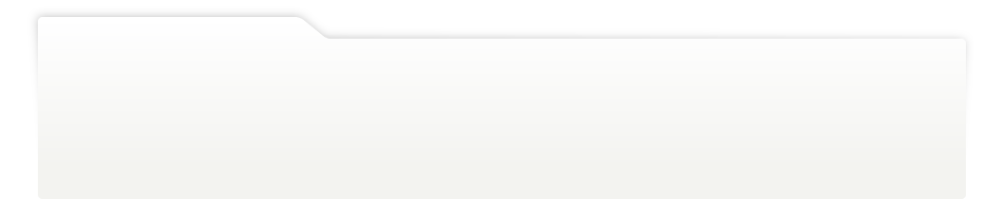
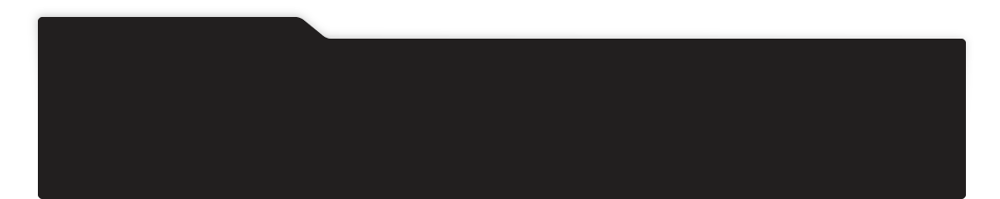
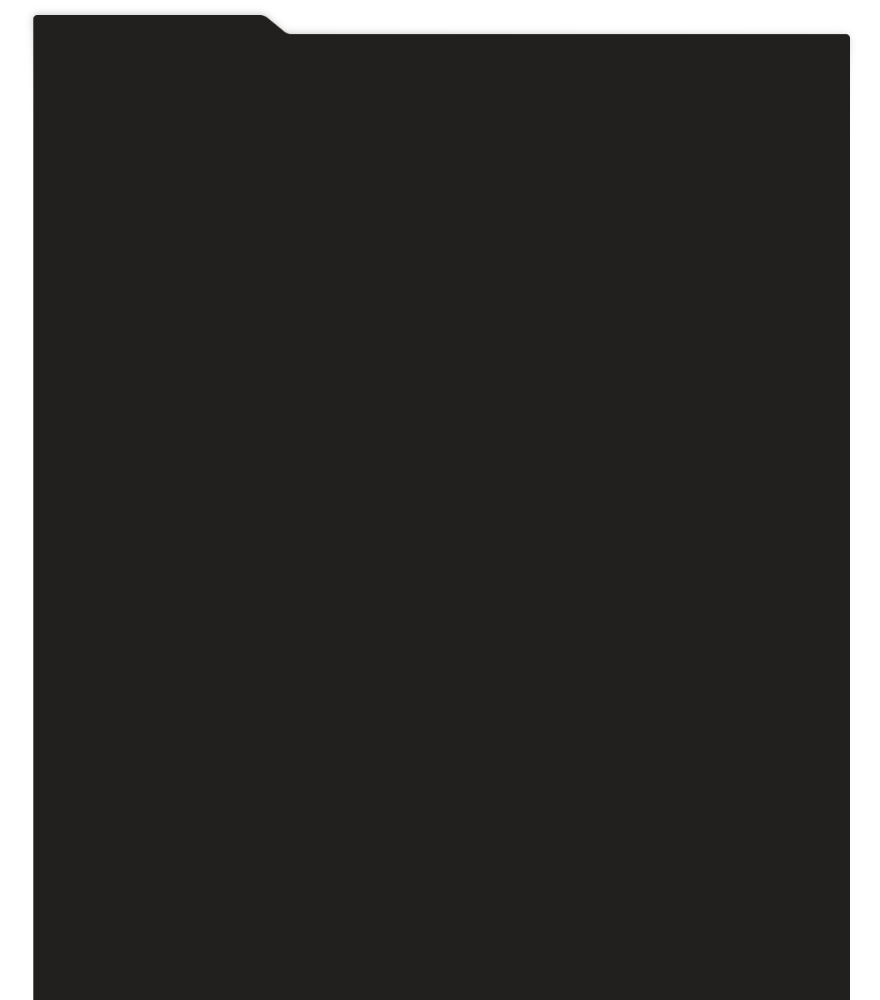
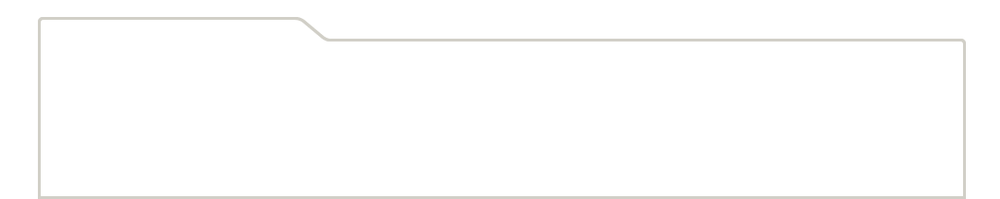
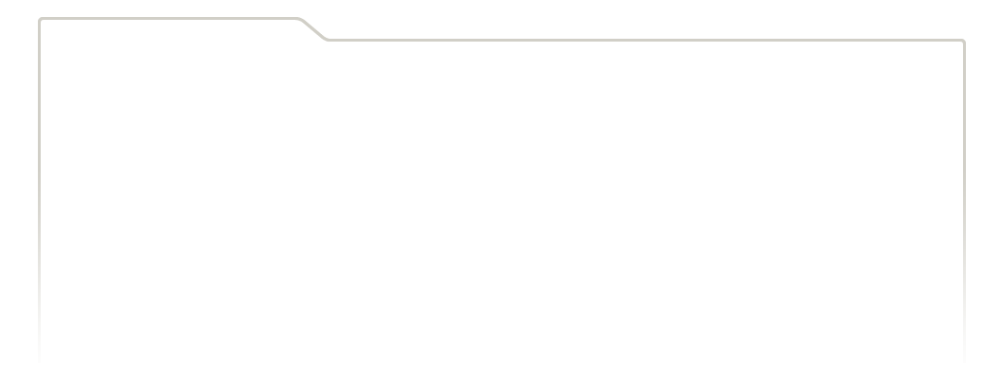
...
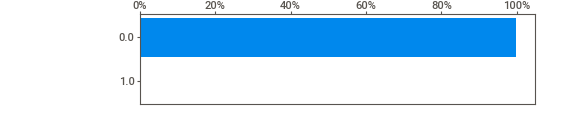
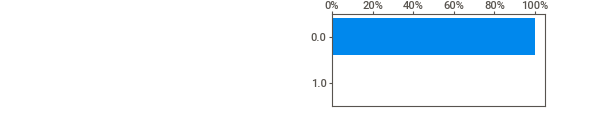
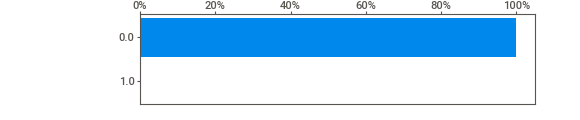
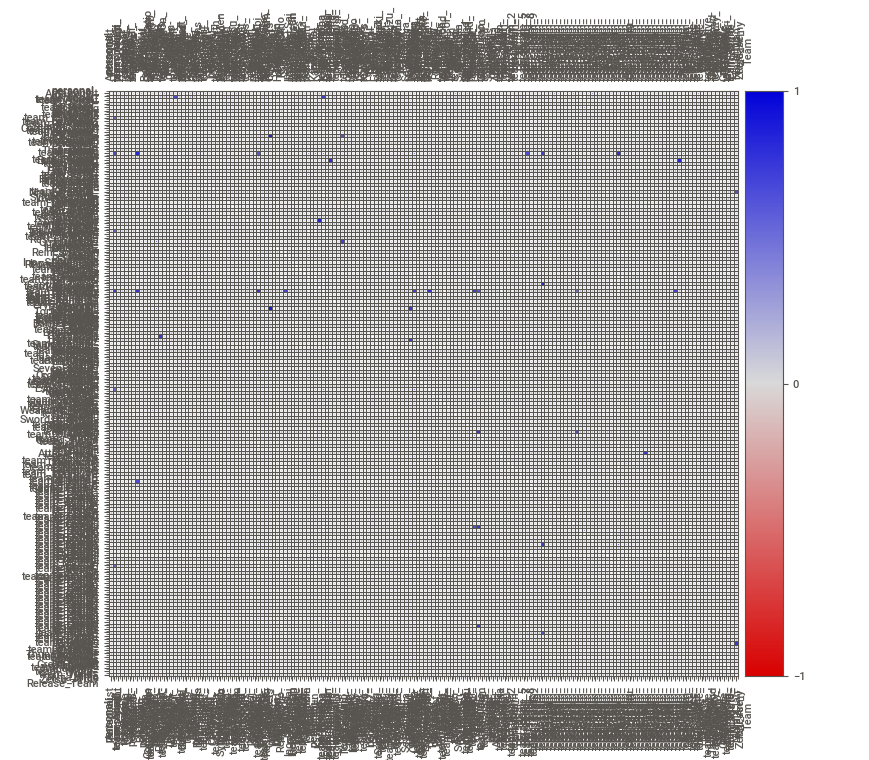
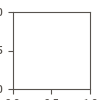

In [117]:
teamreport.show_notebook()

In [118]:
teamreduced = df[['Antagonist','personal_team_Seven_Ninja_Swordsmen_of_the_Mist','personal_team_Team_Guren',
                 '''personal_team_Haido's_Knights''','personal_team_Sound_Four',
                 'personal_team_Gatō_Company','personal_team_Shinobazu',
                 'personal_team_Taka','personal_team_Team_Dosu',
                 'personal_team_Byakuya_Gang','personal_team_Enlightened_Ones',
                 'personal_team_Team_Kajika','personal_team_Three_Ryūdōin_Brothers',
                 'personal_team_Team_Ro','personal_team_Demon_Brothers','personal_team_count']]

In [119]:
trmatrix = teamreduced.corr()
trmatrix

,Antagonist,personal_team_Seven_Ninja_Swordsmen_of_the_Mist,personal_team_Team_Guren,personal_team_Haido's_Knights,personal_team_Sound_Four,personal_team_Gatō_Company,personal_team_Shinobazu,personal_team_Taka,personal_team_Team_Dosu,personal_team_Byakuya_Gang,personal_team_Enlightened_Ones,personal_team_Team_Kajika,personal_team_Three_Ryūdōin_Brothers,personal_team_Team_Ro,personal_team_Demon_Brothers,personal_team_count
Antagonist,1.000000,0.228415,0.168400,0.153673,0.153673,0.137401,0.137401,0.137401,0.137401,0.118951,0.118951,0.118951,0.118951,0.103932,0.097089,0.093973
personal_team_Seven_Ninja_Swordsmen_of_the_Mist,0.228415,1.000000,-0.005711,-0.005212,-0.005212,-0.004660,-0.004660,-0.004660,-0.004660,-0.004034,-0.004034,-0.004034,-0.004034,-0.005711,-0.003293,0.076189
personal_team_Team_Guren,0.168400,-0.005711,1.000000,-0.003842,-0.003842,-0.003435,-0.003435,-0.003435,-0.003435,-0.002974,-0.002974,-0.002974,-0.002974,-0.004211,-0.002428,0.037906
personal_team_Haido's_Knights,0.153673,-0.005212,-0.003842,1.000000,-0.003506,-0.003135,-0.003135,-0.003135,-0.003135,-0.002714,-0.002714,-0.002714,-0.002714,-0.003842,-0.002215,0.034592
personal_team_Sound_Four,0.153673,-0.005212,-0.003842,-0.003506,1.000000,-0.003135,-0.003135,0.221177,-0.003135,-0.002714,-0.002714,-0.002714,-0.002714,-0.003842,-0.002215,0.059036
personal_team_Gatō_Company,0.137401,-0.004660,-0.003435,-0.003135,-0.003135,1.000000,-0.002803,-0.002803,-0.002803,-0.002427,-0.002427,-0.002427,-0.002427,-0.003435,-0.001981,0.030929
personal_team_Shinobazu,0.137401,-0.004660,-0.003435,-0.003135,-0.003135,-0.002803,1.000000,-0.002803,-0.002803,-0.002427,-0.002427,-0.002427,-0.002427,-0.003435,-0.001981,0.030929
personal_team_Taka,0.137401,-0.004660,-0.003435,-0.003135,0.221177,-0.002803,-0.002803,1.000000,-0.002803,-0.002427,-0.002427,-0.002427,-0.002427,-0.003435,-0.001981,0.071909
personal_team_Team_Dosu,0.137401,-0.004660,-0.003435,-0.003135,-0.003135,-0.002803,-0.002803,-0.002803,1.000000,-0.002427,-0.002427,-0.002427,-0.002427,-0.003435,-0.001981,0.058249
personal_team_Byakuya_Gang,0.118951,-0.004034,-0.002974,-0.002714,-0.002714,-0.002427,-0.002427,-0.002427,-0.002427,1.000000,-0.002101,-0.002101,-0.002101,-0.002974,-0.001715,0.026776


In [120]:
teamreduced.sum().to_frame('Count').T

,Antagonist,personal_team_Seven_Ninja_Swordsmen_of_the_Mist,personal_team_Team_Guren,personal_team_Haido's_Knights,personal_team_Sound_Four,personal_team_Gatō_Company,personal_team_Shinobazu,personal_team_Taka,personal_team_Team_Dosu,personal_team_Byakuya_Gang,personal_team_Enlightened_Ones,personal_team_Team_Kajika,personal_team_Three_Ryūdōin_Brothers,personal_team_Team_Ro,personal_team_Demon_Brothers,personal_team_count
Count,185.0,11.0,6.0,5.0,5.0,4.0,4.0,4.0,4.0,3.0,3.0,3.0,3.0,6.0,2.0,621.0


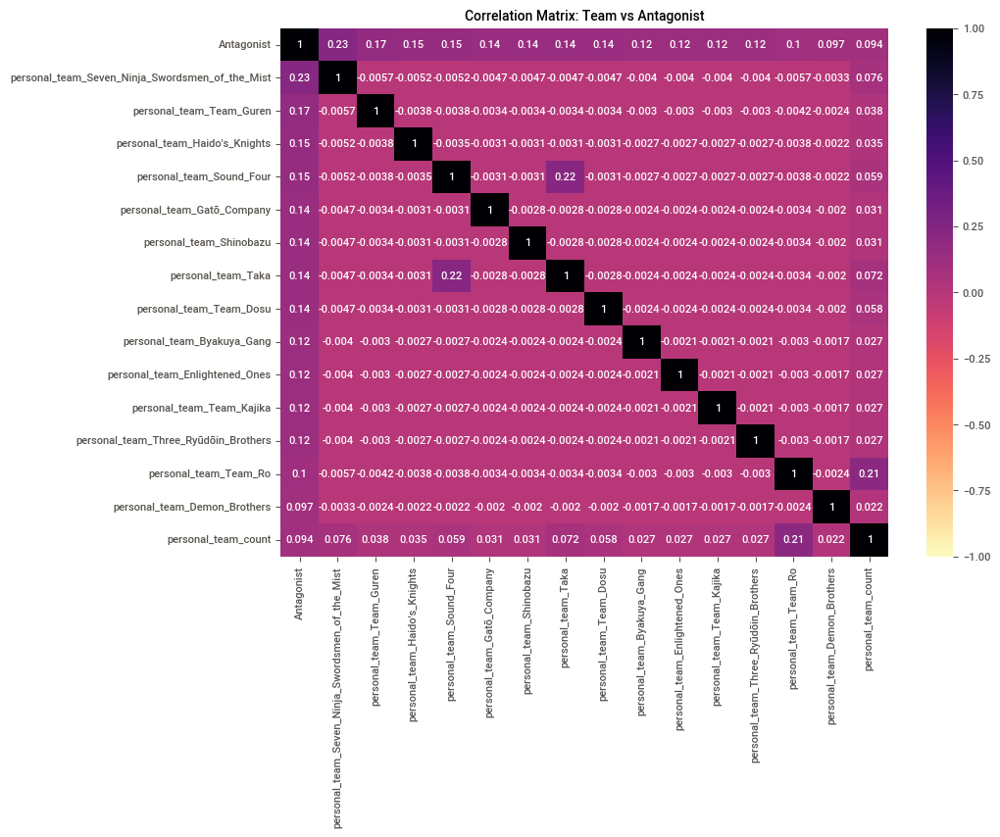

In [121]:
plt.figure(figsize=(10,7))

sns.heatmap(trmatrix, vmin = -1, vmax = 1, annot = True, annot_kws={'size': 8, 'color': 'white'}, cmap='magma_r')

plt.title('Correlation Matrix: Team vs Antagonist', fontsize=10)

plt.show()

In [122]:
sorted(df.columns.tolist())

['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'debut_anime',
 'debut_appearsIn',
 'debut_game',
 'debut_manga',
 'debut_movie',
 'debut_novel',
 'debut_ova',
 'family_count',
 'id',
 'images',
 'jutsu',
 'jutsu_count',
 'name',
 'natureType',
 'natureType_<a_href="/wiki/File:Ido',
 'natureType_<a_href="/wiki/File:Team_Matsuri',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_This_article_is_a_stub',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natu

In [123]:
# Reset dataframe for ML
mldf= df[['Antagonist',
 'Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner',
 'family_count',
 'jutsu_count',
 'natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natureType_Wind_Release',
 'natureType_Wood_Release',
 'natureType_Yang_Release',
 'natureType_Yin_Release',
 'natureType_Yin–Yang_Release',
 'natureType_count',
 'personal_Clan_Hyūga',
 'personal_Clan_Kazekage',
 'personal_Clan_Senju',
 'personal_Clan_Uzumaki',
 'personal_Clan_Wagarashi_Family',
 'personal_HasKekkei',
 'personal_affiliation_Akatsuki',
 'personal_affiliation_Allied_Shinobi_Forces',
 'personal_affiliation_Ame_Orphans',
 'personal_affiliation_Amegakure',
 'personal_affiliation_Ankorodō',
 'personal_affiliation_Bamboo_Village',
 'personal_affiliation_Benisu_Island',
 'personal_affiliation_Castle_Dusk',
 'personal_affiliation_Cat_Fortress',
 'personal_affiliation_Ceramic_Village',
 'personal_affiliation_Daidai_Village',
 'personal_affiliation_Enka_Ninja',
 'personal_affiliation_Fire_Temple',
 'personal_affiliation_Genjutsu_Tree_Village',
 'personal_affiliation_Green_Banks',
 'personal_affiliation_Hachō_Village',
 'personal_affiliation_Himeyuri_Company',
 'personal_affiliation_Hoshigakure',
 'personal_affiliation_Howling_Wolf_Village',
 'personal_affiliation_Inaho_Village',
 'personal_affiliation_Ishigakure',
 'personal_affiliation_Iwagakure',
 'personal_affiliation_Jōmae_Village',
 'personal_affiliation_Kabuto_Yakushi',
 'personal_affiliation_Kagerō_Village',
 'personal_affiliation_Kamizuru_Clan',
 'personal_affiliation_Kaneki_Corporation',
 'personal_affiliation_Kara',
 'personal_affiliation_Kazahana_Castle',
 'personal_affiliation_Kirigakure',
 'personal_affiliation_Konoha_Orphanage',
 'personal_affiliation_Konohagakure',
 'personal_affiliation_Kumogakure',
 'personal_affiliation_Kusabi_Real_Estate',
 'personal_affiliation_Kusagakure',
 'personal_affiliation_Land_of_Ancestors',
 'personal_affiliation_Land_of_Bamboo',
 'personal_affiliation_Land_of_Bean_Jam',
 'personal_affiliation_Land_of_Birds',
 'personal_affiliation_Land_of_Calm_Seas',
 'personal_affiliation_Land_of_Claws',
 'personal_affiliation_Land_of_Demons',
 'personal_affiliation_Land_of_Earth',
 'personal_affiliation_Land_of_Fangs',
 'personal_affiliation_Land_of_Fire',
 'personal_affiliation_Land_of_Forests',
 'personal_affiliation_Land_of_Frost',
 'personal_affiliation_Land_of_Haze',
 'personal_affiliation_Land_of_Honey',
 'personal_affiliation_Land_of_Hot_Water',
 'personal_affiliation_Land_of_Iron',
 'personal_affiliation_Land_of_Lightning',
 'personal_affiliation_Land_of_Mountains',
 'personal_affiliation_Land_of_Neck',
 'personal_affiliation_Land_of_Noodles',
 'personal_affiliation_Land_of_Redaku',
 'personal_affiliation_Land_of_Rivers',
 'personal_affiliation_Land_of_Sand',
 'personal_affiliation_Land_of_Silence',
 'personal_affiliation_Land_of_Snow',
 'personal_affiliation_Land_of_Sound',
 'personal_affiliation_Land_of_Stone',
 'personal_affiliation_Land_of_Swamps',
 'personal_affiliation_Land_of_Tea',
 'personal_affiliation_Land_of_That',
 'personal_affiliation_Land_of_This',
 'personal_affiliation_Land_of_Valleys',
 'personal_affiliation_Land_of_Vegetables',
 'personal_affiliation_Land_of_Water',
 'personal_affiliation_Land_of_Waves',
 'personal_affiliation_Land_of_Wind',
 'personal_affiliation_Land_of_Woods',
 'personal_affiliation_Land_of_the_Moon',
 'personal_affiliation_Land_of_the_Sea',
 'personal_affiliation_Land_of_the_Sky',
 'personal_affiliation_Makibi_Company',
 'personal_affiliation_Makibi_Corporation',
 'personal_affiliation_Mokuzu_Island',
 'personal_affiliation_Moon',
 'personal_affiliation_Mount_Myōboku',
 'personal_affiliation_Mount_Shumisen',
 'personal_affiliation_Nadeshiko_Village',
 'personal_affiliation_Nara_Clan',
 'personal_affiliation_Otogakure',
 'personal_affiliation_Purple_Moon_Island',
 'personal_affiliation_Root',
 'personal_affiliation_Ryūchi_Cave',
 'personal_affiliation_Rōran',
 'personal_affiliation_Shangri-la',
 'personal_affiliation_Shikkotsu_Forest',
 'personal_affiliation_Shuku_Village',
 'personal_affiliation_Sora-ku',
 'personal_affiliation_Sunagakure',
 'personal_affiliation_Takigakure',
 'personal_affiliation_Takumi_Village',
 "personal_affiliation_Temujin's_Continent",
 'personal_affiliation_Tonika_Village',
 'personal_affiliation_Tree_Felling_Village',
 'personal_affiliation_Tsuchigumo_Clan',
 'personal_affiliation_Tsuchigumo_Village',
 'personal_affiliation_Tsukigakure',
 'personal_affiliation_Uzushiogakure',
 'personal_affiliation_Valley_of_Great_Evil',
 'personal_affiliation_Yugakure',
 'personal_affiliation_Yukigakure',
 'personal_affiliation_Yumegakure',
 'personal_affiliation_count',
 'personal_affiliation_Ōtsutsuki_Clan',
 'personal_clan_Aburame',
 'personal_clan_Akimichi',
 'personal_clan_Amagiri',
 'personal_clan_Chinoike',
 'personal_clan_Funato',
 'personal_clan_Fūma',
 'personal_clan_Hatake',
 'personal_clan_Hirasaka',
 'personal_clan_Hoshigaki',
 'personal_clan_Hōki_Family',
 'personal_clan_Hōzuki',
 'personal_clan_Iburi',
 'personal_clan_Inuzuka',
 'personal_clan_Izuno',
 "personal_clan_Jūgo's",
 'personal_clan_Kagetsu_Family',
 'personal_clan_Kaguya',
 'personal_clan_Kamizuru',
 'personal_clan_Karatachi_Family',
 'personal_clan_Kedōin',
 'personal_clan_Kodon',
 'personal_clan_Kurama',
 'personal_clan_Lee',
 'personal_clan_Nara',
 'personal_clan_Onikuma',
 'personal_clan_Rinha',
 'personal_clan_Ryū',
 'personal_clan_Sarutobi',
 'personal_clan_Sendō',
 'personal_clan_Shiin',
 'personal_clan_Shimura',
 'personal_clan_Shirogane',
 'personal_clan_Tenrō',
 'personal_clan_Tsuchigumo',
 'personal_clan_Uchiha',
 'personal_clan_Wasabi_Family',
 'personal_clan_Yamanaka',
 'personal_clan_Yoimura',
 "personal_clan_Yota's",
 'personal_clan_Yotsuki',
 'personal_clan_Yuki',
 'personal_clan_count',
 'personal_clan_Ōtsutsuki',
 'personal_classification_Cooking-nin',
 'personal_classification_Daimyō',
 'personal_classification_Hunter-nin',
 'personal_classification_Jinchūriki',
 'personal_classification_Medical-nin',
 'personal_classification_Mercenary_Ninja',
 'personal_classification_Missing-nin',
 'personal_classification_Ninja_monk',
 'personal_classification_Pseudo-Jinchūriki',
 'personal_classification_Puppet',
 'personal_classification_S-rank',
 'personal_classification_Sage',
 'personal_classification_Samurai',
 'personal_classification_Sannin',
 'personal_classification_Sensor_Type',
 'personal_classification_Summon',
 'personal_classification_Tailed_Beast',
 'personal_classification_count',
 'personal_kekkeiGenkai_count',
 'personal_team_count',
 'personalkekkeiGenkai_count',
 'tools_count',
]]

In [124]:
numcol = ['personal_classification_count','personal_kekkeiGenkai_count',
          'personal_team_count','personalkekkeiGenkai_count','tools_count',
          'personal_clan_count','personal_affiliation_count',
          'natureType_count','jutsu_count','family_count']

In [125]:
mldf[numcol] = mldf[numcol].astype(float)

C:\Users\xavie\AppData\Local\Temp\ipykernel_18860\3773058582.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mldf[numcol] = mldf[numcol].astype(float)


In [126]:
catcols= ['personal_clan_Ōtsutsuki','personal_classification_Cooking-nin','personal_classification_Daimyō',
         'personal_classification_Hunter-nin','personal_classification_Jinchūriki','personal_classification_Medical-nin',
         'personal_classification_Mercenary_Ninja','personal_classification_Missing-nin',
         'personal_classification_Ninja_monk','personal_classification_Pseudo-Jinchūriki',
         'personal_classification_Puppet','personal_classification_S-rank','personal_classification_Sage',
         'personal_classification_Samurai','personal_classification_Sannin','personal_classification_Sensor_Type',
         'personal_classification_Summon','personal_classification_Tailed_Beast',
        'personal_affiliation_Ōtsutsuki_Clan','personal_clan_Aburame','personal_clan_Akimichi','personal_clan_Amagiri',
         'personal_clan_Chinoike','personal_clan_Funato','personal_clan_Fūma','personal_clan_Hatake',
         'personal_clan_Hirasaka','personal_clan_Hoshigaki','personal_clan_Hōki_Family','personal_clan_Hōzuki',
         'personal_clan_Iburi','personal_clan_Inuzuka','personal_clan_Izuno',"personal_clan_Jūgo's",
         'personal_clan_Kagetsu_Family','personal_clan_Kaguya','personal_clan_Kamizuru','personal_clan_Karatachi_Family',
         'personal_clan_Kedōin','personal_clan_Kodon','personal_clan_Kurama','personal_clan_Lee','personal_clan_Nara',
         'personal_clan_Onikuma','personal_clan_Rinha',
 'personal_clan_Ryū',
 'personal_clan_Sarutobi',
 'personal_clan_Sendō',
 'personal_clan_Shiin',
 'personal_clan_Shimura',
 'personal_clan_Shirogane',
 'personal_clan_Tenrō',
 'personal_clan_Tsuchigumo',
 'personal_clan_Uchiha',
 'personal_clan_Wasabi_Family',
 'personal_clan_Yamanaka',
 'personal_clan_Yoimura',
 "personal_clan_Yota's",
 'personal_clan_Yotsuki',
 'personal_clan_Yuki',
 'personal_Clan_Hyūga',
 'personal_Clan_Kazekage',
 'personal_Clan_Senju',
 'personal_Clan_Uzumaki',
 'personal_Clan_Wagarashi_Family',
 'personal_HasKekkei',
 'personal_affiliation_Akatsuki',
 'personal_affiliation_Allied_Shinobi_Forces',
 'personal_affiliation_Ame_Orphans',
 'personal_affiliation_Amegakure',
 'personal_affiliation_Ankorodō',
 'personal_affiliation_Bamboo_Village',
 'personal_affiliation_Benisu_Island',
 'personal_affiliation_Castle_Dusk',
 'personal_affiliation_Cat_Fortress',
 'personal_affiliation_Ceramic_Village',
 'personal_affiliation_Daidai_Village',
 'personal_affiliation_Enka_Ninja',
 'personal_affiliation_Fire_Temple',
 'personal_affiliation_Genjutsu_Tree_Village',
 'personal_affiliation_Green_Banks',
 'personal_affiliation_Hachō_Village',
 'personal_affiliation_Himeyuri_Company',
 'personal_affiliation_Hoshigakure',
 'personal_affiliation_Howling_Wolf_Village',
 'personal_affiliation_Inaho_Village',
 'personal_affiliation_Ishigakure',
 'personal_affiliation_Iwagakure',
 'personal_affiliation_Jōmae_Village',
 'personal_affiliation_Kabuto_Yakushi',
 'personal_affiliation_Kagerō_Village',
 'personal_affiliation_Kamizuru_Clan',
 'personal_affiliation_Kaneki_Corporation',
 'personal_affiliation_Kara',
 'personal_affiliation_Kazahana_Castle',
 'personal_affiliation_Kirigakure',
 'personal_affiliation_Konoha_Orphanage',
 'personal_affiliation_Konohagakure',
 'personal_affiliation_Kumogakure',
 'personal_affiliation_Kusabi_Real_Estate',
 'personal_affiliation_Kusagakure',
 'personal_affiliation_Land_of_Ancestors',
 'personal_affiliation_Land_of_Bamboo',
 'personal_affiliation_Land_of_Bean_Jam',
 'personal_affiliation_Land_of_Birds',
 'personal_affiliation_Land_of_Calm_Seas',
 'personal_affiliation_Land_of_Claws',
 'personal_affiliation_Land_of_Demons',
 'personal_affiliation_Land_of_Earth',
 'personal_affiliation_Land_of_Fangs',
 'personal_affiliation_Land_of_Fire',
 'personal_affiliation_Land_of_Forests',
 'personal_affiliation_Land_of_Frost',
 'personal_affiliation_Land_of_Haze',
 'personal_affiliation_Land_of_Honey',
 'personal_affiliation_Land_of_Hot_Water',
 'personal_affiliation_Land_of_Iron',
 'personal_affiliation_Land_of_Lightning',
 'personal_affiliation_Land_of_Mountains',
 'personal_affiliation_Land_of_Neck',
 'personal_affiliation_Land_of_Noodles',
 'personal_affiliation_Land_of_Redaku',
 'personal_affiliation_Land_of_Rivers',
 'personal_affiliation_Land_of_Sand',
 'personal_affiliation_Land_of_Silence',
 'personal_affiliation_Land_of_Snow',
 'personal_affiliation_Land_of_Sound',
 'personal_affiliation_Land_of_Stone',
 'personal_affiliation_Land_of_Swamps',
 'personal_affiliation_Land_of_Tea',
 'personal_affiliation_Land_of_That',
 'personal_affiliation_Land_of_This',
 'personal_affiliation_Land_of_Valleys',
 'personal_affiliation_Land_of_Vegetables',
 'personal_affiliation_Land_of_Water',
 'personal_affiliation_Land_of_Waves',
 'personal_affiliation_Land_of_Wind',
 'personal_affiliation_Land_of_Woods',
 'personal_affiliation_Land_of_the_Moon',
 'personal_affiliation_Land_of_the_Sea',
 'personal_affiliation_Land_of_the_Sky',
 'personal_affiliation_Makibi_Company',
 'personal_affiliation_Makibi_Corporation',
 'personal_affiliation_Mokuzu_Island',
 'personal_affiliation_Moon',
 'personal_affiliation_Mount_Myōboku',
 'personal_affiliation_Mount_Shumisen',
 'personal_affiliation_Nadeshiko_Village',
 'personal_affiliation_Nara_Clan',
 'personal_affiliation_Otogakure',
 'personal_affiliation_Purple_Moon_Island',
 'personal_affiliation_Root',
 'personal_affiliation_Ryūchi_Cave',
 'personal_affiliation_Rōran',
 'personal_affiliation_Shangri-la',
 'personal_affiliation_Shikkotsu_Forest',
 'personal_affiliation_Shuku_Village',
 'personal_affiliation_Sora-ku',
 'personal_affiliation_Sunagakure',
 'personal_affiliation_Takigakure',
 'personal_affiliation_Takumi_Village',
 "personal_affiliation_Temujin's_Continent",
 'personal_affiliation_Tonika_Village',
 'personal_affiliation_Tree_Felling_Village',
 'personal_affiliation_Tsuchigumo_Clan',
 'personal_affiliation_Tsuchigumo_Village',
 'personal_affiliation_Tsukigakure',
 'personal_affiliation_Uzushiogakure',
 'personal_affiliation_Valley_of_Great_Evil',
 'personal_affiliation_Yugakure',
 'personal_affiliation_Yukigakure',
 'personal_affiliation_Yumegakure','natureType_Boil_Release',
 'natureType_Crystal_Release',
 'natureType_Dark_Release',
 'natureType_Dust_Release',
 'natureType_Earth_Release',
 'natureType_Explosion_Release',
 'natureType_Fire_Release',
 'natureType_Ice_Release',
 'natureType_Lava_Release',
 'natureType_Lightning_Release',
 'natureType_Magnet_Release',
 'natureType_Mud_Release',
 'natureType_Scorch_Release',
 'natureType_Steel_Release',
 'natureType_Storm_Release',
 'natureType_Swift_Release',
 'natureType_Typhoon_Release',
 'natureType_Water_Release',
 'natureType_Wind_Release',
 'natureType_Wood_Release',
 'natureType_Yang_Release',
 'natureType_Yin_Release',
 'natureType_Yin–Yang_Release','Brother',
 'Daughter',
 'Extended_Family',
 'Father_Figure',
 'Misc.',
 'Mother_Figure',
 'Sister',
 'Son',
 'Spouse/Partner']

In [127]:
ignore= ['name','id']

In [128]:
from pycaret.classification import *

In [129]:
y = 'Antagonist'

In [130]:
# Instantiate The Model
classification_set = setup(mldf, 
                           target= y,
                           numeric_imputation='median',  # Handle missing values
                           low_variance_threshold=0.005, # Example: Remove features with variance < 0.005
                           transformation=True,          # Disable auto-transforms if problematic
                           train_size= 0.75,              # Set Training size
                           numeric_features= numcol,
                           categorical_features = catcols,
                           ignore_features = ignore)

,Description,Value
0,Session id,4180
1,Target,Antagonist
2,Target type,Binary
3,Original data shape,"(1431, 215)"
4,Transformed data shape,"(1431, 86)"
5,Transformed train set shape,"(1073, 86)"
6,Transformed test set shape,"(358, 86)"
7,Ignore features,2
8,Numeric features,10
9,Categorical features,204


In [131]:
# Lower threshold variance of .005%
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.9720,0.9742,0.8143,0.9664,0.8788,0.8634,0.8705,0.3530
et,Extra Trees Classifier,0.9711,0.9681,0.8280,0.9458,0.8782,0.8621,0.8675,0.3480
gbc,Gradient Boosting Classifier,0.9702,0.9640,0.7923,0.9739,0.8686,0.8523,0.8611,0.3490
lda,Linear Discriminant Analysis,0.9665,0.9709,0.7495,0.9900,0.8466,0.8286,0.8424,0.3160
dt,Decision Tree Classifier,0.9628,0.9242,0.8566,0.8617,0.8561,0.8348,0.8368,0.3220
ada,Ada Boost Classifier,0.9627,0.9551,0.7709,0.9275,0.8355,0.8151,0.8233,0.3510
lightgbm,Light Gradient Boosting Machine,0.9366,0.9411,0.6181,0.8515,0.7105,0.6766,0.6905,0.4730
svm,SVM - Linear Kernel,0.8770,0.8513,0.1016,0.6817,0.1699,0.1434,0.2235,0.3180
ridge,Ridge Classifier,0.8732,0.8190,0.0214,0.3000,0.0400,0.0354,0.0751,0.3100
knn,K Neighbors Classifier,0.8715,0.7435,0.2302,0.5374,0.3189,0.2592,0.2900,0.5910


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       monotonic_cst=None, n_estimators=100, n_jobs=-1,
                       oob_score=False, random_state=4180, verbose=0,
                       warm_start=False)

In [132]:
# Linear Discriminant Analysis (LDA) is a supervised machine learning technique used for both classification
# and dimensionality reduction.It aims to find a linear combination of features that optimally separates different
# classes in the data. LDA bridges dimensionality reduction and classification in supervised learning. By focusing on
# class separability, it improves model efficiency and accuracy, particularly when data adheres to its assumptions.

In [133]:
ldamodel = create_model('lda')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9722,0.9780,0.7857,1.0000,0.8800,0.8645,0.8726
1,0.9722,0.9863,0.7857,1.0000,0.8800,0.8645,0.8726
2,0.9444,0.9271,0.6429,0.9000,0.7500,0.7197,0.7326
3,0.9907,0.9959,0.9231,1.0000,0.9600,0.9547,0.9557
4,0.9720,0.9843,0.7857,1.0000,0.8800,0.8644,0.8724
5,0.9626,0.9839,0.7143,1.0000,0.8333,0.8129,0.8275
6,0.9346,0.9624,0.5000,1.0000,0.6667,0.6348,0.6819
7,0.9533,0.9247,0.6429,1.0000,0.7826,0.7578,0.7811
8,0.9626,0.9662,0.7143,1.0000,0.8333,0.8129,0.8275


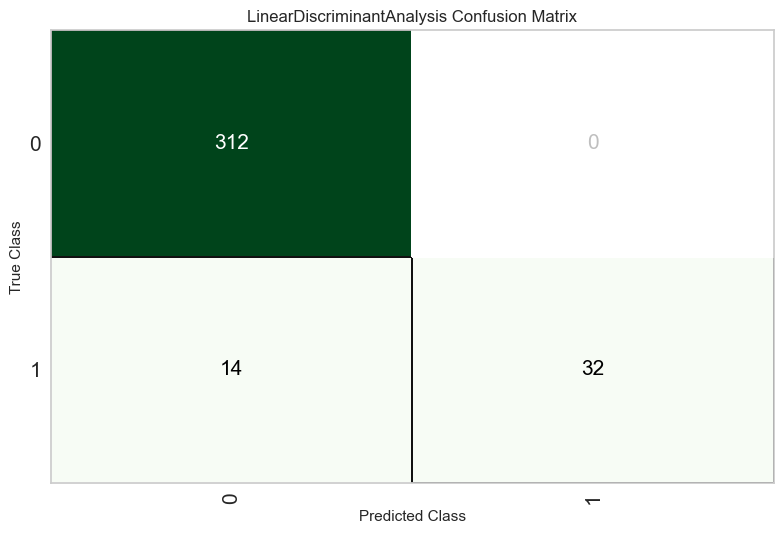

In [134]:
plot_model(ldamodel, plot = 'confusion_matrix')

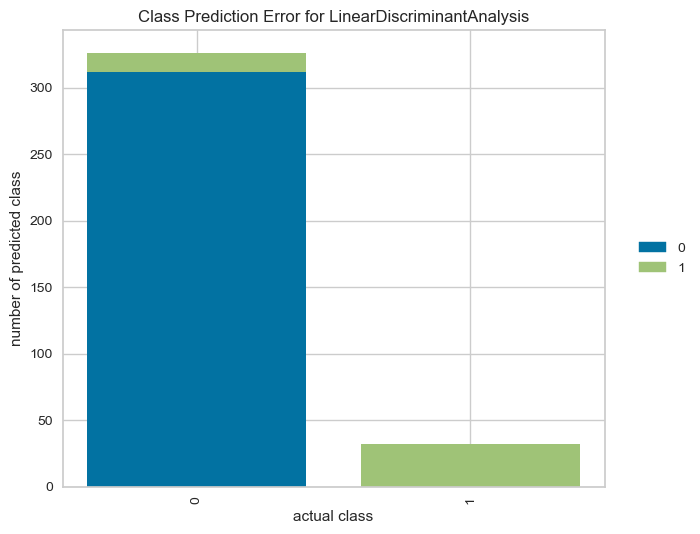

In [135]:
plot_model(ldamodel, plot = 'error')

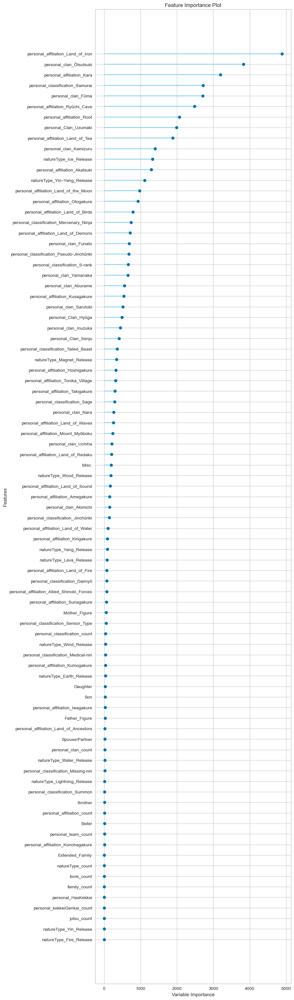

In [136]:
plot_model(ldamodel, plot = 'feature_all')

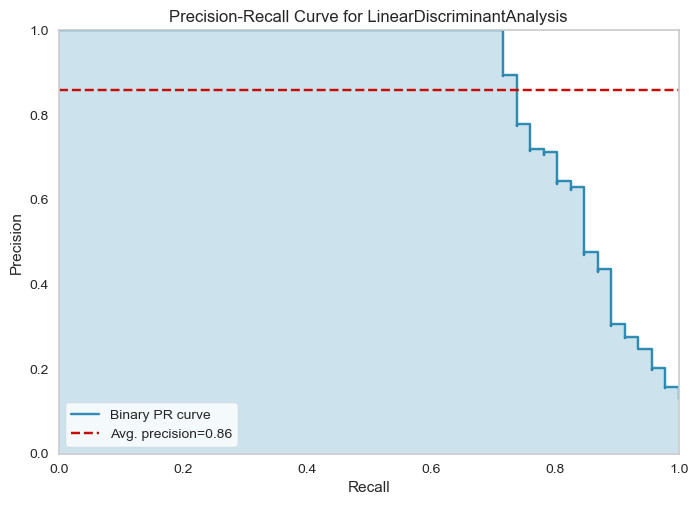

In [137]:
# Precision Recall Curve
plot_model(ldamodel, plot = 'pr')

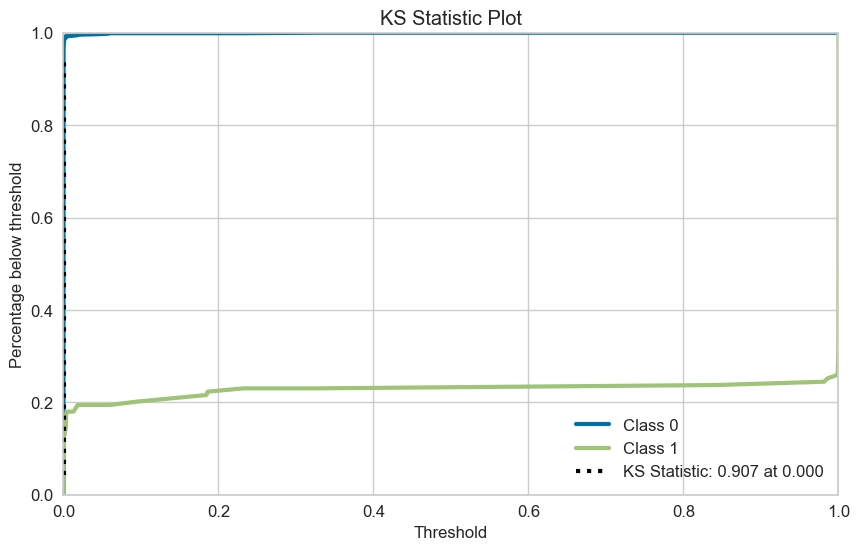

In [138]:
plot_model(ldamodel, plot = 'ks')

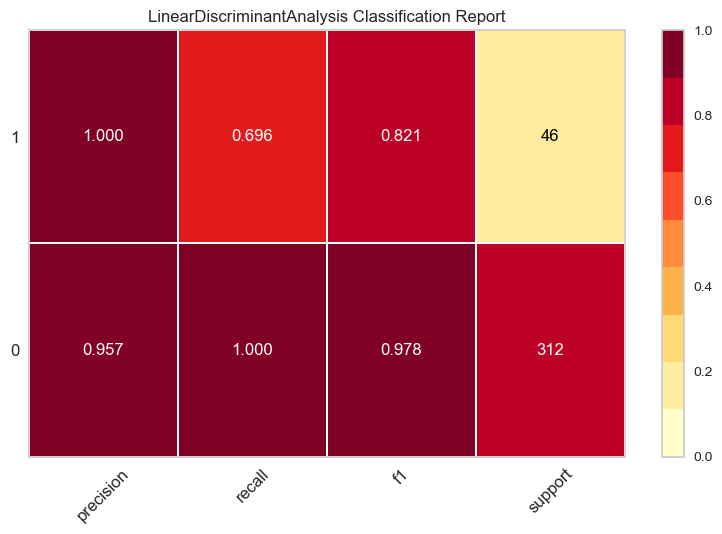

In [139]:
plot_model(ldamodel, plot = 'class_report')

In [140]:
# Create Model
etmodel = create_model('et')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9907,0.9924,0.9286,1.0000,0.9630,0.9577,0.9585
1,0.9722,0.9939,0.9286,0.8667,0.8966,0.8805,0.8812
2,0.9630,0.9681,0.7857,0.9167,0.8462,0.8252,0.8284
3,0.9907,1.0000,0.9231,1.0000,0.9600,0.9547,0.9557
4,0.9813,0.8909,0.8571,1.0000,0.9231,0.9125,0.9160
5,0.9720,0.9962,0.7857,1.0000,0.8800,0.8644,0.8724
6,0.9439,0.9862,0.6429,0.9000,0.7500,0.7194,0.7323
7,0.9439,0.9409,0.6429,0.9000,0.7500,0.7194,0.7323
8,0.9720,0.9320,0.7857,1.0000,0.8800,0.8644,0.8724


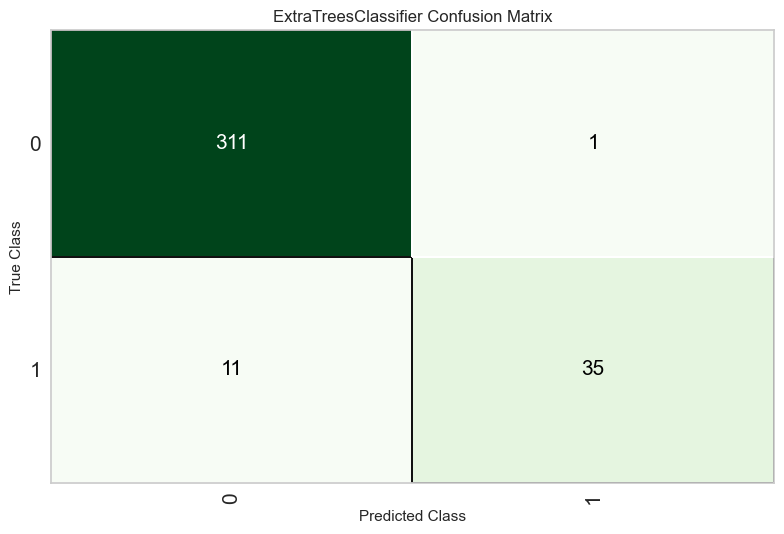

In [141]:
plot_model(etmodel, plot = 'confusion_matrix')

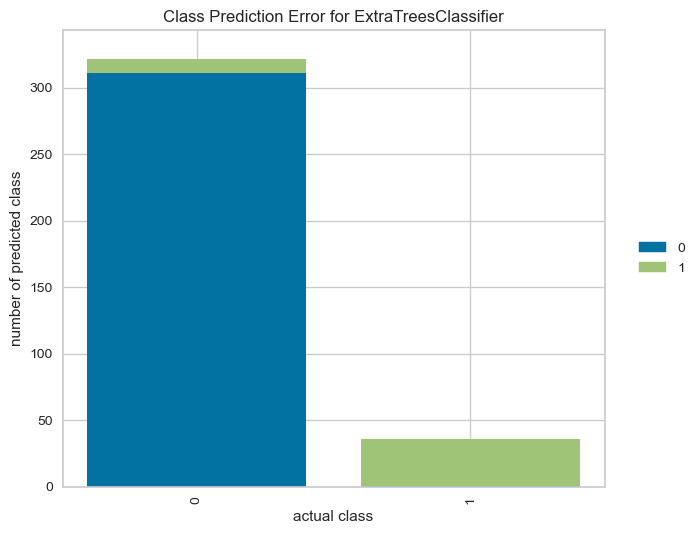

In [142]:
# Error Plot
plot_model(etmodel, plot = 'error')

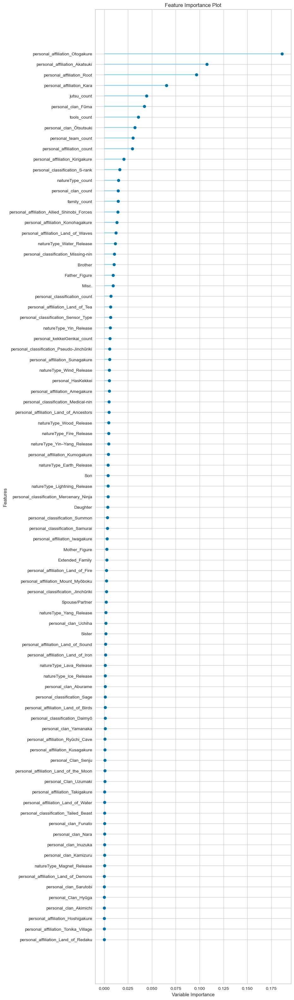

In [143]:
plot_model(etmodel, plot = 'feature_all')

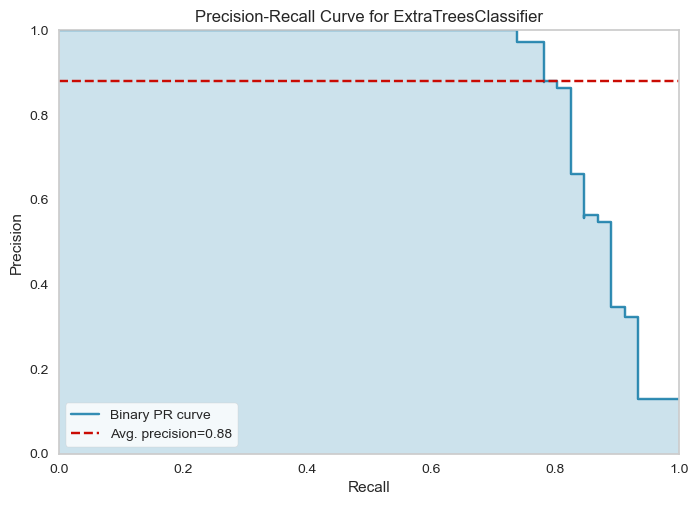

In [144]:
# Precision Recall Curve
plot_model(etmodel, plot = 'pr')

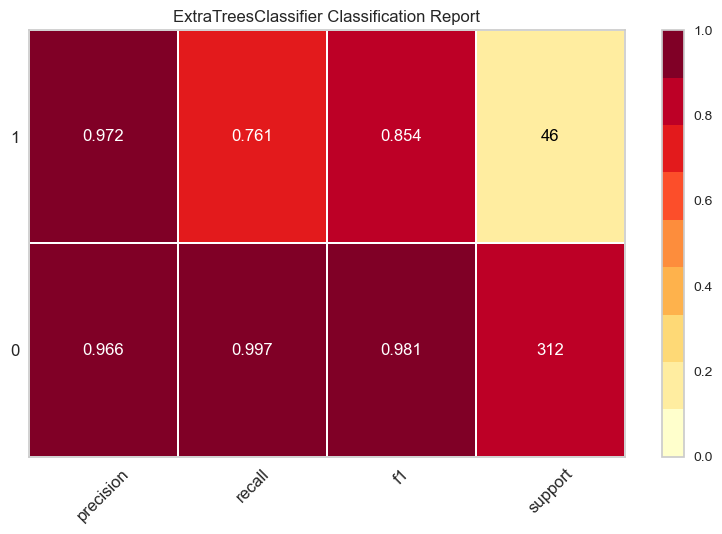

In [145]:
plot_model(etmodel, plot = 'class_report')

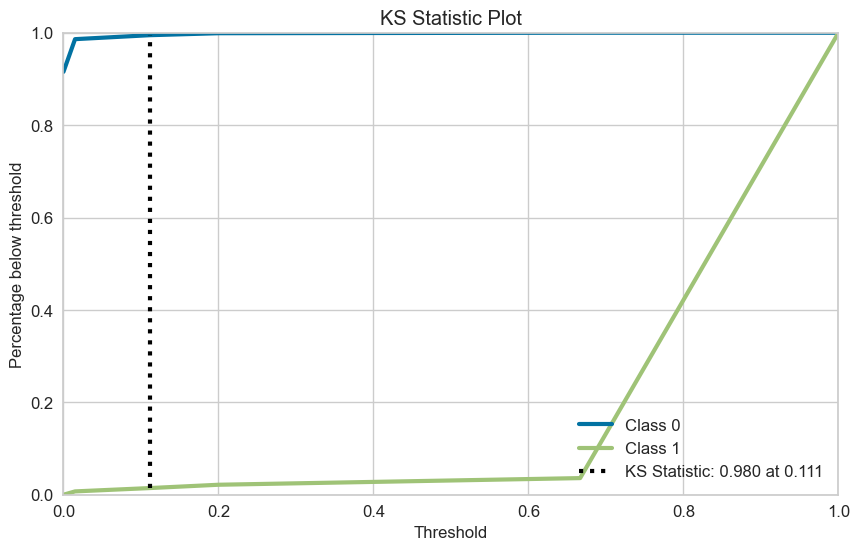

In [146]:
plot_model(etmodel, plot = 'ks')

In [147]:
# Balancing Dataset Using SMOTE
mldf

,Antagonist,Brother,Daughter,Extended_Family,Father_Figure,Misc.,Mother_Figure,Sister,Son,Spouse/Partner,...,personal_classification_Samurai,personal_classification_Sannin,personal_classification_Sensor_Type,personal_classification_Summon,personal_classification_Tailed_Beast,personal_classification_count,personal_kekkeiGenkai_count,personal_team_count,personalkekkeiGenkai_count,tools_count
0,0,0,1,0,1,0,1,0,1,1,...,0.0,0.0,1.0,0.0,0.0,3.0,3.0,11.0,0.0,9.0
1,1,1,1,0,1,0,1,0,0,1,...,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3.0,0.0,9.0
2,1,1,0,0,1,0,0,0,0,0,...,0.0,0.0,1.0,0.0,0.0,4.0,5.0,0.0,0.0,6.0
3,1,0,0,0,1,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,0.0,11.0
4,1,0,0,0,0,0,0,0,1,0,...,0.0,1.0,0.0,0.0,0.0,3.0,4.0,3.0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,0,0,1,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1427,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1428,0,1,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1429,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [152]:
mldf[y].value_counts()

Antagonist
0    1246
1     185
Name: count, dtype: int64

<Axes: ylabel='count'>

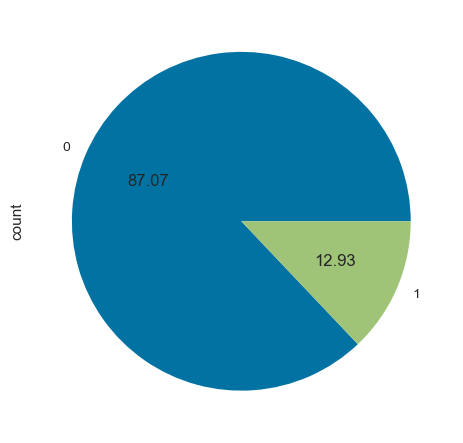

In [154]:
# Antagonist count Comparison Pie Chart
mldf[y].value_counts().plot.pie(autopct='%.2f')

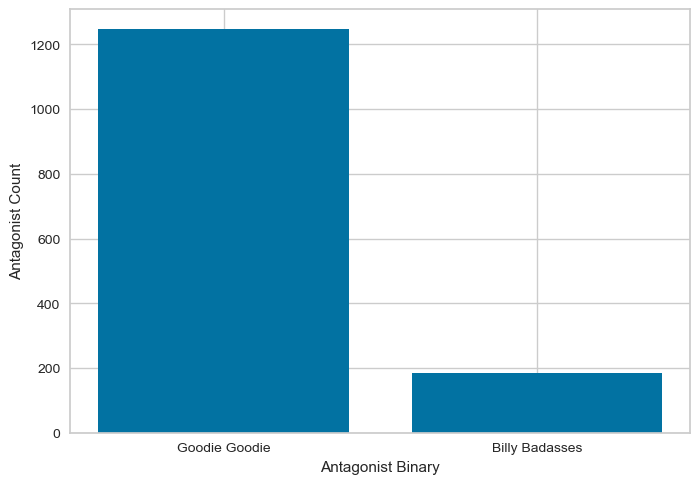

In [164]:
plt.figure()

plt.bar(antcount.index, antcount)
plt.xticks([0, 1],['Goodie Goodie', 'Billy Badasses'])
plt.xlabel('Antagonist Binary')
plt.ylabel('Antagonist Count')
plt.show()

In [155]:
! pip install -U imbalanced-learn

  Obtaining dependency information for imbalanced-learn from https://files.pythonhosted.org/packages/9d/41/721fec82606242a2072ee909086ff918dfad7d0199a9dfd4928df9c72494/imbalanced_learn-0.13.0-py3-none-any.whl.metadata
  Obtaining dependency information for sklearn-compat<1,>=0.1 from https://files.pythonhosted.org/packages/f0/a8/ad69cf130fbd017660cdd64abbef3f28135d9e2e15fe3002e03c5be0ca38/sklearn_compat-0.1.3-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/238.4 kB ? eta -:--:--
   --- ----------------------------------- 20.5/238.4 kB 682.7 kB/s eta 0:00:01
   ------ -------------------------------- 41.0/238.4 kB 495.5 kB/s eta 0:00:01
   ----------------- -------------------- 112.6/238.4 kB 939.4 kB/s eta 0:00:01
   ----------------------------- ---------- 174.1/238.4 kB 1.1 MB/s eta 0:00:01
   ---------------------------------------  235.5/238.4 kB 1.1 MB/s eta 0:00:01
   ---------------------------------------- 238.4/238.4 kB 1.1 MB/s eta 0:00:00
  Attempti

In [194]:
from imblearn.over_sampling import ADASYN
from sklearn.impute import IterativeImputer
from sklearn.ensemble import *
from sklearn.impute import *
from sklearn.neighbors import *
from sklearn.feature_selection import *

In [195]:
# Antagonist COunt
antcount = mldf.groupby(y).size().sort_values()
antcount

Antagonist
1     185
0    1246
dtype: int64

In [219]:
# Define an ADASYN instance with custom parameters
# ADASYN (Adaptive Synthetic Sampling) is an oversampling technique that generates synthetic samples for the minority class
# by adaptively focusing on harder-to-classify instances, i.e., those near the decision boundary or surrounded by majority
# class samples. Unlike SMOTE, which uniformly oversamples all minority instances, ADASYN prioritizes challenging regions
# by generating more synthetic samples where the imbalance is most pronounced. This approach improves model performance
# in overlapping or noisy regions while reducing redundancy and overfitting risks.
adasyn = ADASYN(sampling_strategy=1.0)
# Define custom imputers for iterative imputation
catimputation = GradientBoostingClassifier()
numimputation = KNeighborsClassifier()
# Instantiate The Model
rebalancedclassification = setup(mldf, 
                           target= y,
                           session_id = 2927,
                           imputation_type='iterative',
                           numeric_iterative_imputer= numimputation,   # Use KNN for numeric imputation
                           categorical_iterative_imputer=catimputation, # Use GBC for categorical imputation
                           low_variance_threshold=0.005, # Example: Remove features with variance < 0.005
                           transformation=True,          # Disable auto-transforms if problematic
                           fix_imbalance=True,         # Enable imbalance fixing
                           fix_imbalance_method=adasyn, # Use ADASYN as the oversampling method for rare to predict features
                           train_size= 0.75,              # Set Training size
                           numeric_features= numcol,
                           categorical_features = catcols,
                           ignore_features = ignore)

,Description,Value
0,Session id,2927
1,Target,Antagonist
2,Target type,Binary
3,Original data shape,"(1431, 215)"
4,Transformed data shape,"(2227, 85)"
5,Transformed train set shape,"(1869, 85)"
6,Transformed test set shape,"(358, 85)"
7,Ignore features,2
8,Numeric features,10
9,Categorical features,204


In [220]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.9711,0.9543,0.8495,0.9160,0.8792,0.8630,0.8652,0.5030
lightgbm,Light Gradient Boosting Machine,0.9711,0.9602,0.8357,0.9290,0.8750,0.8591,0.8634,0.7150
rf,Random Forest Classifier,0.9646,0.9628,0.7923,0.9143,0.8463,0.8268,0.8309,0.4990
gbc,Gradient Boosting Classifier,0.9646,0.9655,0.8066,0.9064,0.8510,0.8312,0.8345,0.5190
dt,Decision Tree Classifier,0.9599,0.9101,0.8280,0.8644,0.8407,0.8179,0.8214,0.4590
ada,Ada Boost Classifier,0.9487,0.9442,0.7929,0.8104,0.7968,0.7677,0.7707,0.4850
lda,Linear Discriminant Analysis,0.9469,0.9589,0.7780,0.8096,0.7891,0.7590,0.7619,0.4670
svm,SVM - Linear Kernel,0.8621,0.9060,0.6692,0.5251,0.5534,0.4780,0.5043,0.4690
ridge,Ridge Classifier,0.8536,0.8802,0.6335,0.4620,0.5295,0.4464,0.4571,0.4540
knn,K Neighbors Classifier,0.8351,0.8017,0.6121,0.4130,0.4903,0.3970,0.4097,0.4840


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     monotonic_cst=None, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=2927, verbose=0,
                     warm_start=False)

In [221]:
lightgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9907,1.0000,0.9286,1.0000,0.9630,0.9577,0.9585
1,0.9722,0.9966,0.8571,0.9231,0.8889,0.8730,0.8738
2,0.9444,0.8541,0.7143,0.8333,0.7692,0.7379,0.7407
3,0.9626,0.9962,0.8571,0.8571,0.8571,0.8356,0.8356
4,0.9720,0.9604,0.9286,0.8667,0.8966,0.8804,0.8811
5,0.9813,0.9954,0.8571,1.0000,0.9231,0.9125,0.9160
6,0.9720,0.9827,0.7857,1.0000,0.8800,0.8644,0.8724
7,0.9533,0.9685,0.7143,0.9091,0.8000,0.7740,0.7812
8,0.9065,0.8452,0.5000,0.7000,0.5833,0.5323,0.5419


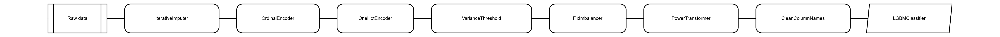

In [229]:
plot_model(lightgbm, plot = 'pipeline', scale = 1.5)

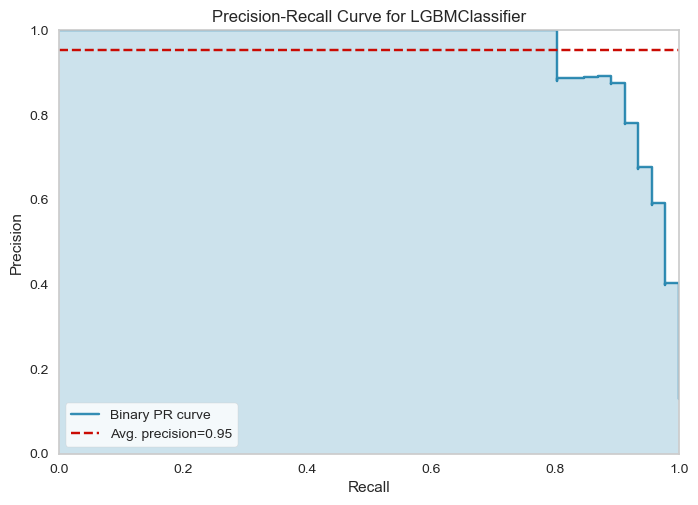

In [223]:
plot_model(lightgbm, plot = 'pr')

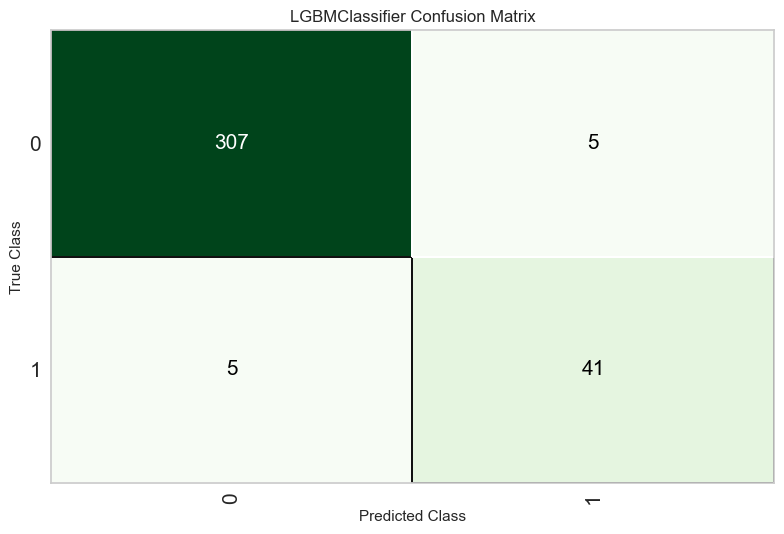

In [230]:
plot_model(lightgbm, plot = 'confusion_matrix')

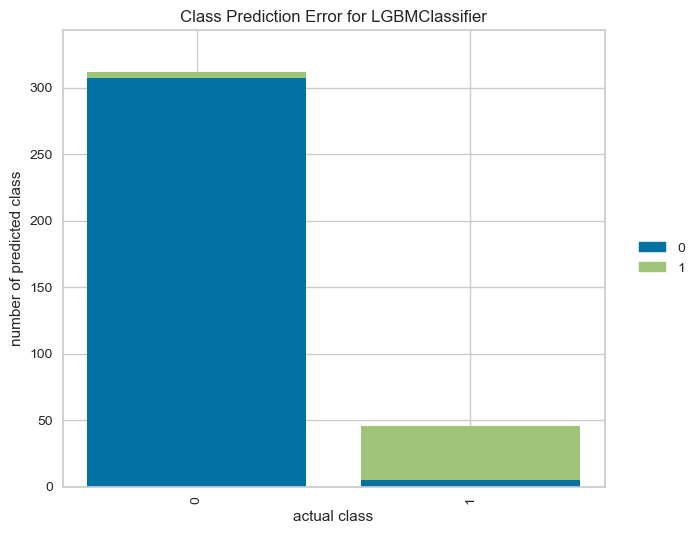

In [225]:
plot_model(lightgbm, plot = 'error')

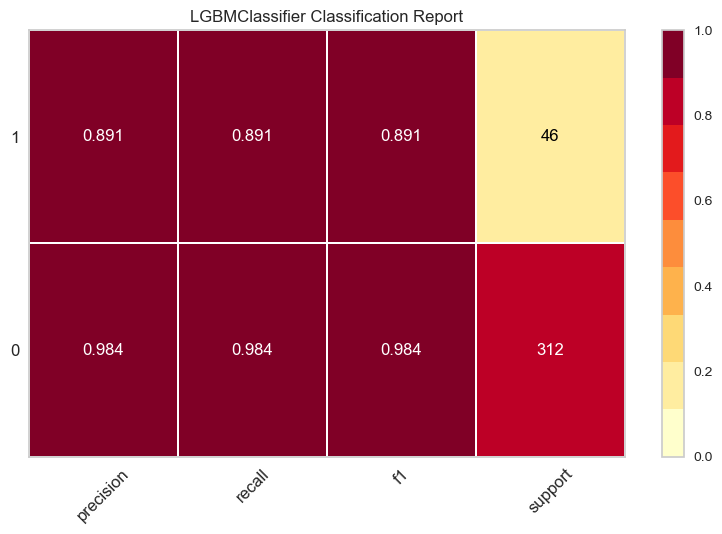

In [226]:
plot_model(lightgbm, plot = 'class_report')

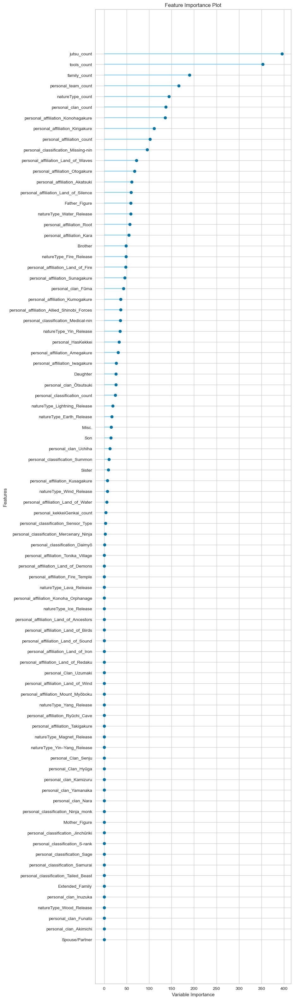

In [232]:
plot_model(lightgbm, plot = 'feature_all')